# Afriat

In [1]:
import warnings
import os
import sys
import gc
import warnings

In [2]:
import anndata as ad
import scanpy as sc
import copy
import torch
from pathlib import Path
import networkx as nx
from sklearn.neighbors import kneighbors_graph
import numpy as np
import scanpy as sc
import pandas as pd
import numpy as np
import scipy.stats

sys.path.append("/home/icb/kemal.inecik/work/codes/tardis")
import tardis
from tardis._utils.functions import create_random_mask
import sklearn
tardis.config = tardis.config_server

In [3]:
torch.cuda.is_available()

False

In [4]:
%matplotlib inline
%config InlineBackend.figure_format='retina'
import matplotlib.pyplot as plt
import seaborn as sns

import pickle
_rcparams_path = "/home/icb/kemal.inecik/work/codes/tardis/training/local/figures/rcparams.pickle"
with open(_rcparams_path, 'rb') as file:
    _rcparams = pickle.load(file)
plt.rcParams.update(_rcparams)

In [5]:
adata_file_path = os.path.join(tardis.config.io_directories["processed"], "biolord_afriat.h5ad")
assert os.path.isfile(adata_file_path), f"File not already exist: `{adata_file_path}`"
adata = ad.read_h5ad(adata_file_path)
adata

AnnData object with n_obs × n_vars = 19053 × 5000
    obs: 'mouse', 'experiment', 'time_int', 'time_cat', 'zone', 'status_control'

In [6]:
ratio_true=0.2

mask = create_random_mask(adata.shape[1], ratio_true=ratio_true, seed=2024)
adata.X[:, mask] = 0.0

In [7]:
model_level_metrics = [
    dict(
        metric_identifier = "metric_mi|status_control",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 256,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|zone",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|time_cat",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|mouse",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    )
]

In [8]:
warmup_epoch_range = [6, 48]
dtc_w1 = 100
dtc_w2 = 10

counteractive_minibatch_settings = dict(
    method = "categorical_random",
    method_kwargs = dict(
        within_labels = False,
        within_batch = False,
        within_categorical_covs = None,
        seed = "forward",
    )
)

disentenglement_targets_configurations=[
    dict(
        obs_key = "status_control",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "time_cat",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "zone",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    )
]

In [9]:
n_epochs_kl_warmup = 600

model_params = dict(
    n_hidden=512,
    n_layers=3, 
    n_latent=(24 + 8 * len(disentenglement_targets_configurations)),
    gene_likelihood = "nb",
    use_batch_norm = "none",
    use_layer_norm = "both",
    dropout_rate = 0.25,
    deeply_inject_disentengled_latents = True,
    include_auxillary_loss = True,
    beta_kl_weight = 0.5,
)

train_params = dict(
    max_epochs=600,
    train_size=0.8,
    batch_size=128,
    check_val_every_n_epoch=10,
    limit_train_batches=1.0, 
    limit_val_batches=1.0,
    learning_rate_monitor=True,
    # early stopping:
    early_stopping=False,
    early_stopping_patience=150,
    early_stopping_monitor="elbo_train",
    plan_kwargs = dict(
        n_epochs_kl_warmup=n_epochs_kl_warmup,
        lr=1e-4,
        weight_decay=1e-4,
        optimizer="AdamW",
        # lr-scheduler:
        reduce_lr_on_plateau=True,
        lr_patience=100,
        lr_scheduler_metric="elbo_train",
    )
)

dataset_params = dict(
    layer=None, 
    labels_key=None,
    batch_key=None,
    categorical_covariate_keys=None,
    disentenglement_targets_configurations=disentenglement_targets_configurations,
    model_level_metrics=model_level_metrics,
    model_level_metrics_helper_covariates=['zone', 'status_control', 'time_cat', 'mouse']
)

tardis.MyModel.setup_anndata(adata, **dataset_params)
dataset_params["adata_path"] = adata_file_path
dataset_params["adata"] = os.path.split(adata_file_path)[1]

tardis.MyModel.setup_wandb(
    wandb_configurations=tardis.config.wandb,
    hyperparams=dict(
        model_params=model_params,
        train_params=train_params,
        dataset_params=dataset_params,
    )
)

vae = tardis.MyModel(
    adata,
    **model_params
)
vae.train(**train_params)

dir_path = os.path.join(
    tardis.config.io_directories["models"],
    f"afriat_v2_4_ablation_{ratio_true}"
)

vae.save(
    dir_path,
    overwrite=True,
)

W&B logger initialized with the following parameters: 
Entity: inecik-academic
Project: tardis_conference
ID: wh7w3jyp
Name: clone-cantina-124
Tags: tardis, conference, figures, final
Notes: Final runs for Tardis before conference.
URL: https://wandb.ai/inecik-academic/tardis_conference/runs/wh7w3jyp
Directory: /lustre/groups/ml01/workspace/kemal.inecik/wandb/run-20240504_155910-wh7w3jyp/files



/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:168: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_ ...
GPU available: False, used: False


TPU available: False, using: 0 TPU cores


IPU available: False, using: 0 IPUs


HPU available: False, using: 0 HPUs


`Trainer(limit_train_batches=1.0)` was configured so 100% of the batches per epoch will be used..


`Trainer(limit_val_batches=1.0)` was configured so 100% of the batches will be used..


/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:168: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_ ...
/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


Training:   0%|          | 0/600 [00:00<?, ?it/s]

Epoch 1/600:   0%|          | 0/600 [00:00<?, ?it/s]

/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `training` set. Number of elements in each group: 2581,3262,9400
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `training` set. Number of elements in each group: 2581,2560,1655,3419,1674,3354
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `training` set. Number of elements in each group: 4449,10794
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `validation` set. Number of elements in each group: 624,847,2339
  possible_indices = CachedPossibleGroupDefinitionIndices.get(
/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `validation` set. Number of elements in each group: 624,642,453,871,375,845
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `validation` set. Number of elements in each group: 1135,2675
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


Epoch 1/600:   0%|          | 1/600 [00:16<2:45:07, 16.54s/it]

Epoch 1/600:   0%|          | 1/600 [00:16<2:45:07, 16.54s/it, v_num=yp_1, total_loss_train=3.13e+3, kl_local_train=57.2]

Epoch 2/600:   0%|          | 1/600 [00:16<2:45:07, 16.54s/it, v_num=yp_1, total_loss_train=3.13e+3, kl_local_train=57.2]

Epoch 2/600:   0%|          | 2/600 [00:31<2:37:19, 15.79s/it, v_num=yp_1, total_loss_train=3.13e+3, kl_local_train=57.2]

Epoch 2/600:   0%|          | 2/600 [00:31<2:37:19, 15.79s/it, v_num=yp_1, total_loss_train=2.59e+3, kl_local_train=86.6]

Epoch 3/600:   0%|          | 2/600 [00:31<2:37:19, 15.79s/it, v_num=yp_1, total_loss_train=2.59e+3, kl_local_train=86.6]

Epoch 3/600:   0%|          | 3/600 [00:47<2:35:21, 15.61s/it, v_num=yp_1, total_loss_train=2.59e+3, kl_local_train=86.6]

Epoch 3/600:   0%|          | 3/600 [00:47<2:35:21, 15.61s/it, v_num=yp_1, total_loss_train=2.57e+3, kl_local_train=88]  

Epoch 4/600:   0%|          | 3/600 [00:47<2:35:21, 15.61s/it, v_num=yp_1, total_loss_train=2.57e+3, kl_local_train=88]

Epoch 4/600:   1%|          | 4/600 [01:02<2:33:26, 15.45s/it, v_num=yp_1, total_loss_train=2.57e+3, kl_local_train=88]

Epoch 4/600:   1%|          | 4/600 [01:02<2:33:26, 15.45s/it, v_num=yp_1, total_loss_train=2.56e+3, kl_local_train=83.6]

Epoch 5/600:   1%|          | 4/600 [01:02<2:33:26, 15.45s/it, v_num=yp_1, total_loss_train=2.56e+3, kl_local_train=83.6]

Epoch 5/600:   1%|          | 5/600 [01:17<2:32:53, 15.42s/it, v_num=yp_1, total_loss_train=2.56e+3, kl_local_train=83.6]

Epoch 5/600:   1%|          | 5/600 [01:17<2:32:53, 15.42s/it, v_num=yp_1, total_loss_train=2.55e+3, kl_local_train=74.8]

Epoch 6/600:   1%|          | 5/600 [01:19<2:32:53, 15.42s/it, v_num=yp_1, total_loss_train=2.55e+3, kl_local_train=74.8]

Epoch 6/600:   1%|          | 6/600 [01:33<2:34:17, 15.58s/it, v_num=yp_1, total_loss_train=2.55e+3, kl_local_train=74.8]

Epoch 6/600:   1%|          | 6/600 [01:33<2:34:17, 15.58s/it, v_num=yp_1, total_loss_train=2.55e+3, kl_local_train=59.8, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.0088, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.035]

Epoch 7/600:   1%|          | 6/600 [01:33<2:34:17, 15.58s/it, v_num=yp_1, total_loss_train=2.55e+3, kl_local_train=59.8, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.0088, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.035]

Epoch 7/600:   1%|          | 7/600 [01:48<2:31:04, 15.29s/it, v_num=yp_1, total_loss_train=2.55e+3, kl_local_train=59.8, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.0088, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.035]

Epoch 7/600:   1%|          | 7/600 [01:48<2:31:04, 15.29s/it, v_num=yp_1, total_loss_train=2.54e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.0088, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.035]

Epoch 8/600:   1%|          | 7/600 [01:48<2:31:04, 15.29s/it, v_num=yp_1, total_loss_train=2.54e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.0088, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.035]

Epoch 8/600:   1%|▏         | 8/600 [02:02<2:28:45, 15.08s/it, v_num=yp_1, total_loss_train=2.54e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.0088, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.035]

Epoch 8/600:   1%|▏         | 8/600 [02:02<2:28:45, 15.08s/it, v_num=yp_1, total_loss_train=2.54e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.0088, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.035]

Epoch 9/600:   1%|▏         | 8/600 [02:02<2:28:45, 15.08s/it, v_num=yp_1, total_loss_train=2.54e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.0088, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.035]

Epoch 9/600:   2%|▏         | 9/600 [02:17<2:27:07, 14.94s/it, v_num=yp_1, total_loss_train=2.54e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.0088, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.035]

Epoch 9/600:   2%|▏         | 9/600 [02:17<2:27:07, 14.94s/it, v_num=yp_1, total_loss_train=2.54e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.0088, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.035]

Epoch 10/600:   2%|▏         | 9/600 [02:17<2:27:07, 14.94s/it, v_num=yp_1, total_loss_train=2.54e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.0088, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.035]

Epoch 10/600:   2%|▏         | 10/600 [02:32<2:26:20, 14.88s/it, v_num=yp_1, total_loss_train=2.54e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.0088, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.035]

Epoch 10/600:   2%|▏         | 10/600 [02:32<2:26:20, 14.88s/it, v_num=yp_1, total_loss_train=2.54e+3, kl_local_train=93, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.0088, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.035]  

Epoch 11/600:   2%|▏         | 10/600 [02:33<2:26:20, 14.88s/it, v_num=yp_1, total_loss_train=2.54e+3, kl_local_train=93, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.0088, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.035]

Epoch 11/600:   2%|▏         | 11/600 [02:48<2:29:43, 15.25s/it, v_num=yp_1, total_loss_train=2.54e+3, kl_local_train=93, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.0088, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.035]

Epoch 11/600:   2%|▏         | 11/600 [02:48<2:29:43, 15.25s/it, v_num=yp_1, total_loss_train=2.55e+3, kl_local_train=151, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0484]

Epoch 12/600:   2%|▏         | 11/600 [02:48<2:29:43, 15.25s/it, v_num=yp_1, total_loss_train=2.55e+3, kl_local_train=151, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0484]

Epoch 12/600:   2%|▏         | 12/600 [03:03<2:27:37, 15.06s/it, v_num=yp_1, total_loss_train=2.55e+3, kl_local_train=151, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0484]

Epoch 12/600:   2%|▏         | 12/600 [03:03<2:27:37, 15.06s/it, v_num=yp_1, total_loss_train=2.55e+3, kl_local_train=193, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0484]

Epoch 13/600:   2%|▏         | 12/600 [03:03<2:27:37, 15.06s/it, v_num=yp_1, total_loss_train=2.55e+3, kl_local_train=193, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0484]

Epoch 13/600:   2%|▏         | 13/600 [03:17<2:26:06, 14.93s/it, v_num=yp_1, total_loss_train=2.55e+3, kl_local_train=193, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0484]

Epoch 13/600:   2%|▏         | 13/600 [03:17<2:26:06, 14.93s/it, v_num=yp_1, total_loss_train=2.55e+3, kl_local_train=191, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0484]

Epoch 14/600:   2%|▏         | 13/600 [03:17<2:26:06, 14.93s/it, v_num=yp_1, total_loss_train=2.55e+3, kl_local_train=191, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0484]

Epoch 14/600:   2%|▏         | 14/600 [03:32<2:24:57, 14.84s/it, v_num=yp_1, total_loss_train=2.55e+3, kl_local_train=191, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0484]

Epoch 14/600:   2%|▏         | 14/600 [03:32<2:24:57, 14.84s/it, v_num=yp_1, total_loss_train=2.56e+3, kl_local_train=171, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0484]

Epoch 15/600:   2%|▏         | 14/600 [03:32<2:24:57, 14.84s/it, v_num=yp_1, total_loss_train=2.56e+3, kl_local_train=171, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0484]

Epoch 15/600:   2%|▎         | 15/600 [03:46<2:24:08, 14.78s/it, v_num=yp_1, total_loss_train=2.56e+3, kl_local_train=171, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0484]

Epoch 15/600:   2%|▎         | 15/600 [03:46<2:24:08, 14.78s/it, v_num=yp_1, total_loss_train=2.56e+3, kl_local_train=152, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0484]

Epoch 16/600:   2%|▎         | 15/600 [03:48<2:24:08, 14.78s/it, v_num=yp_1, total_loss_train=2.56e+3, kl_local_train=152, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0484]

Epoch 16/600:   3%|▎         | 16/600 [04:03<2:27:43, 15.18s/it, v_num=yp_1, total_loss_train=2.56e+3, kl_local_train=152, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0484]

Epoch 16/600:   3%|▎         | 16/600 [04:03<2:27:43, 15.18s/it, v_num=yp_1, total_loss_train=2.56e+3, kl_local_train=202, metric_mi|status_control_train=0.0382, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0602]

Epoch 17/600:   3%|▎         | 16/600 [04:03<2:27:43, 15.18s/it, v_num=yp_1, total_loss_train=2.56e+3, kl_local_train=202, metric_mi|status_control_train=0.0382, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0602]

Epoch 17/600:   3%|▎         | 17/600 [04:17<2:26:02, 15.03s/it, v_num=yp_1, total_loss_train=2.56e+3, kl_local_train=202, metric_mi|status_control_train=0.0382, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0602]

Epoch 17/600:   3%|▎         | 17/600 [04:17<2:26:02, 15.03s/it, v_num=yp_1, total_loss_train=2.55e+3, kl_local_train=201, metric_mi|status_control_train=0.0382, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0602]

Epoch 18/600:   3%|▎         | 17/600 [04:17<2:26:02, 15.03s/it, v_num=yp_1, total_loss_train=2.55e+3, kl_local_train=201, metric_mi|status_control_train=0.0382, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0602]

Epoch 18/600:   3%|▎         | 18/600 [04:32<2:24:20, 14.88s/it, v_num=yp_1, total_loss_train=2.55e+3, kl_local_train=201, metric_mi|status_control_train=0.0382, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0602]

Epoch 18/600:   3%|▎         | 18/600 [04:32<2:24:20, 14.88s/it, v_num=yp_1, total_loss_train=2.55e+3, kl_local_train=195, metric_mi|status_control_train=0.0382, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0602]

Epoch 19/600:   3%|▎         | 18/600 [04:32<2:24:20, 14.88s/it, v_num=yp_1, total_loss_train=2.55e+3, kl_local_train=195, metric_mi|status_control_train=0.0382, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0602]

Epoch 19/600:   3%|▎         | 19/600 [04:46<2:22:52, 14.75s/it, v_num=yp_1, total_loss_train=2.55e+3, kl_local_train=195, metric_mi|status_control_train=0.0382, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0602]

Epoch 19/600:   3%|▎         | 19/600 [04:46<2:22:52, 14.75s/it, v_num=yp_1, total_loss_train=2.54e+3, kl_local_train=190, metric_mi|status_control_train=0.0382, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0602]

Epoch 20/600:   3%|▎         | 19/600 [04:46<2:22:52, 14.75s/it, v_num=yp_1, total_loss_train=2.54e+3, kl_local_train=190, metric_mi|status_control_train=0.0382, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0602]

Epoch 20/600:   3%|▎         | 20/600 [05:01<2:22:34, 14.75s/it, v_num=yp_1, total_loss_train=2.54e+3, kl_local_train=190, metric_mi|status_control_train=0.0382, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0602]

Epoch 20/600:   3%|▎         | 20/600 [05:01<2:22:34, 14.75s/it, v_num=yp_1, total_loss_train=2.54e+3, kl_local_train=177, metric_mi|status_control_train=0.0382, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0602]

Epoch 21/600:   3%|▎         | 20/600 [05:02<2:22:34, 14.75s/it, v_num=yp_1, total_loss_train=2.54e+3, kl_local_train=177, metric_mi|status_control_train=0.0382, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0602]

Epoch 21/600:   4%|▎         | 21/600 [05:17<2:25:31, 15.08s/it, v_num=yp_1, total_loss_train=2.54e+3, kl_local_train=177, metric_mi|status_control_train=0.0382, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0602]

Epoch 21/600:   4%|▎         | 21/600 [05:17<2:25:31, 15.08s/it, v_num=yp_1, total_loss_train=2.54e+3, kl_local_train=173, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.121]    

Epoch 22/600:   4%|▎         | 21/600 [05:17<2:25:31, 15.08s/it, v_num=yp_1, total_loss_train=2.54e+3, kl_local_train=173, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.121]

Epoch 22/600:   4%|▎         | 22/600 [05:31<2:23:52, 14.93s/it, v_num=yp_1, total_loss_train=2.54e+3, kl_local_train=173, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.121]

Epoch 22/600:   4%|▎         | 22/600 [05:31<2:23:52, 14.93s/it, v_num=yp_1, total_loss_train=2.54e+3, kl_local_train=168, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.121]

Epoch 23/600:   4%|▎         | 22/600 [05:31<2:23:52, 14.93s/it, v_num=yp_1, total_loss_train=2.54e+3, kl_local_train=168, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.121]

Epoch 23/600:   4%|▍         | 23/600 [05:46<2:21:45, 14.74s/it, v_num=yp_1, total_loss_train=2.54e+3, kl_local_train=168, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.121]

Epoch 23/600:   4%|▍         | 23/600 [05:46<2:21:45, 14.74s/it, v_num=yp_1, total_loss_train=2.54e+3, kl_local_train=169, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.121]

Epoch 24/600:   4%|▍         | 23/600 [05:46<2:21:45, 14.74s/it, v_num=yp_1, total_loss_train=2.54e+3, kl_local_train=169, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.121]

Epoch 24/600:   4%|▍         | 24/600 [06:00<2:20:33, 14.64s/it, v_num=yp_1, total_loss_train=2.54e+3, kl_local_train=169, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.121]

Epoch 24/600:   4%|▍         | 24/600 [06:00<2:20:33, 14.64s/it, v_num=yp_1, total_loss_train=2.54e+3, kl_local_train=166, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.121]

Epoch 25/600:   4%|▍         | 24/600 [06:00<2:20:33, 14.64s/it, v_num=yp_1, total_loss_train=2.54e+3, kl_local_train=166, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.121]

Epoch 25/600:   4%|▍         | 25/600 [06:15<2:20:11, 14.63s/it, v_num=yp_1, total_loss_train=2.54e+3, kl_local_train=166, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.121]

Epoch 25/600:   4%|▍         | 25/600 [06:15<2:20:11, 14.63s/it, v_num=yp_1, total_loss_train=2.54e+3, kl_local_train=164, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.121]

Epoch 26/600:   4%|▍         | 25/600 [06:16<2:20:11, 14.63s/it, v_num=yp_1, total_loss_train=2.54e+3, kl_local_train=164, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.121]

Epoch 26/600:   4%|▍         | 26/600 [06:31<2:23:25, 14.99s/it, v_num=yp_1, total_loss_train=2.54e+3, kl_local_train=164, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.121]

Epoch 26/600:   4%|▍         | 26/600 [06:31<2:23:25, 14.99s/it, v_num=yp_1, total_loss_train=2.55e+3, kl_local_train=163, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.136]

Epoch 27/600:   4%|▍         | 26/600 [06:31<2:23:25, 14.99s/it, v_num=yp_1, total_loss_train=2.55e+3, kl_local_train=163, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.136]

Epoch 27/600:   4%|▍         | 27/600 [06:45<2:21:36, 14.83s/it, v_num=yp_1, total_loss_train=2.55e+3, kl_local_train=163, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.136]

Epoch 27/600:   4%|▍         | 27/600 [06:45<2:21:36, 14.83s/it, v_num=yp_1, total_loss_train=2.55e+3, kl_local_train=164, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.136]

Epoch 28/600:   4%|▍         | 27/600 [06:45<2:21:36, 14.83s/it, v_num=yp_1, total_loss_train=2.55e+3, kl_local_train=164, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.136]

Epoch 28/600:   5%|▍         | 28/600 [06:59<2:20:05, 14.70s/it, v_num=yp_1, total_loss_train=2.55e+3, kl_local_train=164, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.136]

Epoch 28/600:   5%|▍         | 28/600 [06:59<2:20:05, 14.70s/it, v_num=yp_1, total_loss_train=2.55e+3, kl_local_train=167, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.136]

Epoch 29/600:   5%|▍         | 28/600 [06:59<2:20:05, 14.70s/it, v_num=yp_1, total_loss_train=2.55e+3, kl_local_train=167, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.136]

Epoch 29/600:   5%|▍         | 29/600 [07:14<2:18:38, 14.57s/it, v_num=yp_1, total_loss_train=2.55e+3, kl_local_train=167, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.136]

Epoch 29/600:   5%|▍         | 29/600 [07:14<2:18:38, 14.57s/it, v_num=yp_1, total_loss_train=2.55e+3, kl_local_train=165, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.136]

Epoch 30/600:   5%|▍         | 29/600 [07:14<2:18:38, 14.57s/it, v_num=yp_1, total_loss_train=2.55e+3, kl_local_train=165, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.136]

Epoch 30/600:   5%|▌         | 30/600 [07:28<2:18:31, 14.58s/it, v_num=yp_1, total_loss_train=2.55e+3, kl_local_train=165, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.136]

Epoch 30/600:   5%|▌         | 30/600 [07:28<2:18:31, 14.58s/it, v_num=yp_1, total_loss_train=2.55e+3, kl_local_train=167, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.136]

Epoch 31/600:   5%|▌         | 30/600 [07:30<2:18:31, 14.58s/it, v_num=yp_1, total_loss_train=2.55e+3, kl_local_train=167, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.136]

Epoch 31/600:   5%|▌         | 31/600 [07:44<2:21:58, 14.97s/it, v_num=yp_1, total_loss_train=2.55e+3, kl_local_train=167, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.136]

Epoch 31/600:   5%|▌         | 31/600 [07:44<2:21:58, 14.97s/it, v_num=yp_1, total_loss_train=2.56e+3, kl_local_train=167, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.14]  

Epoch 32/600:   5%|▌         | 31/600 [07:44<2:21:58, 14.97s/it, v_num=yp_1, total_loss_train=2.56e+3, kl_local_train=167, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.14]

Epoch 32/600:   5%|▌         | 32/600 [07:59<2:20:22, 14.83s/it, v_num=yp_1, total_loss_train=2.56e+3, kl_local_train=167, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.14]

Epoch 32/600:   5%|▌         | 32/600 [07:59<2:20:22, 14.83s/it, v_num=yp_1, total_loss_train=2.56e+3, kl_local_train=168, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.14]

Epoch 33/600:   5%|▌         | 32/600 [07:59<2:20:22, 14.83s/it, v_num=yp_1, total_loss_train=2.56e+3, kl_local_train=168, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.14]

Epoch 33/600:   6%|▌         | 33/600 [08:13<2:19:07, 14.72s/it, v_num=yp_1, total_loss_train=2.56e+3, kl_local_train=168, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.14]

Epoch 33/600:   6%|▌         | 33/600 [08:13<2:19:07, 14.72s/it, v_num=yp_1, total_loss_train=2.56e+3, kl_local_train=169, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.14]

Epoch 34/600:   6%|▌         | 33/600 [08:13<2:19:07, 14.72s/it, v_num=yp_1, total_loss_train=2.56e+3, kl_local_train=169, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.14]

Epoch 34/600:   6%|▌         | 34/600 [08:28<2:17:50, 14.61s/it, v_num=yp_1, total_loss_train=2.56e+3, kl_local_train=169, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.14]

Epoch 34/600:   6%|▌         | 34/600 [08:28<2:17:50, 14.61s/it, v_num=yp_1, total_loss_train=2.56e+3, kl_local_train=173, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.14]

Epoch 35/600:   6%|▌         | 34/600 [08:28<2:17:50, 14.61s/it, v_num=yp_1, total_loss_train=2.56e+3, kl_local_train=173, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.14]

Epoch 35/600:   6%|▌         | 35/600 [08:42<2:17:16, 14.58s/it, v_num=yp_1, total_loss_train=2.56e+3, kl_local_train=173, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.14]

Epoch 35/600:   6%|▌         | 35/600 [08:42<2:17:16, 14.58s/it, v_num=yp_1, total_loss_train=2.57e+3, kl_local_train=168, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.14]

Epoch 36/600:   6%|▌         | 35/600 [08:43<2:17:16, 14.58s/it, v_num=yp_1, total_loss_train=2.57e+3, kl_local_train=168, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.14]

Epoch 36/600:   6%|▌         | 36/600 [08:58<2:20:29, 14.95s/it, v_num=yp_1, total_loss_train=2.57e+3, kl_local_train=168, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.14]

Epoch 36/600:   6%|▌         | 36/600 [08:58<2:20:29, 14.95s/it, v_num=yp_1, total_loss_train=2.57e+3, kl_local_train=168, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.144]

Epoch 37/600:   6%|▌         | 36/600 [08:58<2:20:29, 14.95s/it, v_num=yp_1, total_loss_train=2.57e+3, kl_local_train=168, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.144]

Epoch 37/600:   6%|▌         | 37/600 [09:12<2:18:52, 14.80s/it, v_num=yp_1, total_loss_train=2.57e+3, kl_local_train=168, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.144]

Epoch 37/600:   6%|▌         | 37/600 [09:12<2:18:52, 14.80s/it, v_num=yp_1, total_loss_train=2.57e+3, kl_local_train=169, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.144]

Epoch 38/600:   6%|▌         | 37/600 [09:12<2:18:52, 14.80s/it, v_num=yp_1, total_loss_train=2.57e+3, kl_local_train=169, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.144]

Epoch 38/600:   6%|▋         | 38/600 [09:27<2:17:55, 14.72s/it, v_num=yp_1, total_loss_train=2.57e+3, kl_local_train=169, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.144]

Epoch 38/600:   6%|▋         | 38/600 [09:27<2:17:55, 14.72s/it, v_num=yp_1, total_loss_train=2.58e+3, kl_local_train=169, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.144]

Epoch 39/600:   6%|▋         | 38/600 [09:27<2:17:55, 14.72s/it, v_num=yp_1, total_loss_train=2.58e+3, kl_local_train=169, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.144]

Epoch 39/600:   6%|▋         | 39/600 [09:41<2:16:19, 14.58s/it, v_num=yp_1, total_loss_train=2.58e+3, kl_local_train=169, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.144]

Epoch 39/600:   6%|▋         | 39/600 [09:41<2:16:19, 14.58s/it, v_num=yp_1, total_loss_train=2.58e+3, kl_local_train=169, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.144]

Epoch 40/600:   6%|▋         | 39/600 [09:41<2:16:19, 14.58s/it, v_num=yp_1, total_loss_train=2.58e+3, kl_local_train=169, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.144]

Epoch 40/600:   7%|▋         | 40/600 [09:56<2:16:32, 14.63s/it, v_num=yp_1, total_loss_train=2.58e+3, kl_local_train=169, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.144]

Epoch 40/600:   7%|▋         | 40/600 [09:56<2:16:32, 14.63s/it, v_num=yp_1, total_loss_train=2.58e+3, kl_local_train=168, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.144]

Epoch 41/600:   7%|▋         | 40/600 [09:57<2:16:32, 14.63s/it, v_num=yp_1, total_loss_train=2.58e+3, kl_local_train=168, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.144]

Epoch 41/600:   7%|▋         | 41/600 [10:12<2:19:24, 14.96s/it, v_num=yp_1, total_loss_train=2.58e+3, kl_local_train=168, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.144]

Epoch 41/600:   7%|▋         | 41/600 [10:12<2:19:24, 14.96s/it, v_num=yp_1, total_loss_train=2.58e+3, kl_local_train=169, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.144]

Epoch 42/600:   7%|▋         | 41/600 [10:12<2:19:24, 14.96s/it, v_num=yp_1, total_loss_train=2.58e+3, kl_local_train=169, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.144]

Epoch 42/600:   7%|▋         | 42/600 [10:26<2:18:07, 14.85s/it, v_num=yp_1, total_loss_train=2.58e+3, kl_local_train=169, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.144]

Epoch 42/600:   7%|▋         | 42/600 [10:26<2:18:07, 14.85s/it, v_num=yp_1, total_loss_train=2.59e+3, kl_local_train=171, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.144]

Epoch 43/600:   7%|▋         | 42/600 [10:26<2:18:07, 14.85s/it, v_num=yp_1, total_loss_train=2.59e+3, kl_local_train=171, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.144]

Epoch 43/600:   7%|▋         | 43/600 [10:41<2:16:49, 14.74s/it, v_num=yp_1, total_loss_train=2.59e+3, kl_local_train=171, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.144]

Epoch 43/600:   7%|▋         | 43/600 [10:41<2:16:49, 14.74s/it, v_num=yp_1, total_loss_train=2.59e+3, kl_local_train=167, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.144]

Epoch 44/600:   7%|▋         | 43/600 [10:41<2:16:49, 14.74s/it, v_num=yp_1, total_loss_train=2.59e+3, kl_local_train=167, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.144]

Epoch 44/600:   7%|▋         | 44/600 [10:55<2:16:02, 14.68s/it, v_num=yp_1, total_loss_train=2.59e+3, kl_local_train=167, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.144]

Epoch 44/600:   7%|▋         | 44/600 [10:55<2:16:02, 14.68s/it, v_num=yp_1, total_loss_train=2.59e+3, kl_local_train=169, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.144]

Epoch 45/600:   7%|▋         | 44/600 [10:55<2:16:02, 14.68s/it, v_num=yp_1, total_loss_train=2.59e+3, kl_local_train=169, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.144]

Epoch 45/600:   8%|▊         | 45/600 [11:10<2:15:25, 14.64s/it, v_num=yp_1, total_loss_train=2.59e+3, kl_local_train=169, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.144]

Epoch 45/600:   8%|▊         | 45/600 [11:10<2:15:25, 14.64s/it, v_num=yp_1, total_loss_train=2.59e+3, kl_local_train=170, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.144]

Epoch 46/600:   8%|▊         | 45/600 [11:11<2:15:25, 14.64s/it, v_num=yp_1, total_loss_train=2.59e+3, kl_local_train=170, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.144]

Epoch 46/600:   8%|▊         | 46/600 [11:26<2:18:53, 15.04s/it, v_num=yp_1, total_loss_train=2.59e+3, kl_local_train=170, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.144]

Epoch 46/600:   8%|▊         | 46/600 [11:26<2:18:53, 15.04s/it, v_num=yp_1, total_loss_train=2.6e+3, kl_local_train=167, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.148] 

Epoch 47/600:   8%|▊         | 46/600 [11:26<2:18:53, 15.04s/it, v_num=yp_1, total_loss_train=2.6e+3, kl_local_train=167, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.148]

Epoch 47/600:   8%|▊         | 47/600 [11:40<2:17:15, 14.89s/it, v_num=yp_1, total_loss_train=2.6e+3, kl_local_train=167, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.148]

Epoch 47/600:   8%|▊         | 47/600 [11:40<2:17:15, 14.89s/it, v_num=yp_1, total_loss_train=2.6e+3, kl_local_train=171, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.148]

Epoch 48/600:   8%|▊         | 47/600 [11:40<2:17:15, 14.89s/it, v_num=yp_1, total_loss_train=2.6e+3, kl_local_train=171, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.148]

Epoch 48/600:   8%|▊         | 48/600 [11:55<2:15:56, 14.78s/it, v_num=yp_1, total_loss_train=2.6e+3, kl_local_train=171, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.148]

Epoch 48/600:   8%|▊         | 48/600 [11:55<2:15:56, 14.78s/it, v_num=yp_1, total_loss_train=2.6e+3, kl_local_train=173, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.148]

Epoch 49/600:   8%|▊         | 48/600 [11:55<2:15:56, 14.78s/it, v_num=yp_1, total_loss_train=2.6e+3, kl_local_train=173, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.148]

Epoch 49/600:   8%|▊         | 49/600 [12:09<2:14:59, 14.70s/it, v_num=yp_1, total_loss_train=2.6e+3, kl_local_train=173, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.148]

Epoch 49/600:   8%|▊         | 49/600 [12:09<2:14:59, 14.70s/it, v_num=yp_1, total_loss_train=2.61e+3, kl_local_train=171, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.148]

Epoch 50/600:   8%|▊         | 49/600 [12:09<2:14:59, 14.70s/it, v_num=yp_1, total_loss_train=2.61e+3, kl_local_train=171, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.148]

Epoch 50/600:   8%|▊         | 50/600 [12:24<2:14:45, 14.70s/it, v_num=yp_1, total_loss_train=2.61e+3, kl_local_train=171, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.148]

Epoch 50/600:   8%|▊         | 50/600 [12:24<2:14:45, 14.70s/it, v_num=yp_1, total_loss_train=2.61e+3, kl_local_train=171, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.148]

Epoch 51/600:   8%|▊         | 50/600 [12:25<2:14:45, 14.70s/it, v_num=yp_1, total_loss_train=2.61e+3, kl_local_train=171, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.148]

Epoch 51/600:   8%|▊         | 51/600 [12:40<2:17:54, 15.07s/it, v_num=yp_1, total_loss_train=2.61e+3, kl_local_train=171, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.148]

Epoch 51/600:   8%|▊         | 51/600 [12:40<2:17:54, 15.07s/it, v_num=yp_1, total_loss_train=2.61e+3, kl_local_train=169, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.15] 

Epoch 52/600:   8%|▊         | 51/600 [12:40<2:17:54, 15.07s/it, v_num=yp_1, total_loss_train=2.61e+3, kl_local_train=169, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.15]

Epoch 52/600:   9%|▊         | 52/600 [12:55<2:16:22, 14.93s/it, v_num=yp_1, total_loss_train=2.61e+3, kl_local_train=169, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.15]

Epoch 52/600:   9%|▊         | 52/600 [12:55<2:16:22, 14.93s/it, v_num=yp_1, total_loss_train=2.61e+3, kl_local_train=165, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.15]

Epoch 53/600:   9%|▊         | 52/600 [12:55<2:16:22, 14.93s/it, v_num=yp_1, total_loss_train=2.61e+3, kl_local_train=165, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.15]

Epoch 53/600:   9%|▉         | 53/600 [13:09<2:14:37, 14.77s/it, v_num=yp_1, total_loss_train=2.61e+3, kl_local_train=165, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.15]

Epoch 53/600:   9%|▉         | 53/600 [13:09<2:14:37, 14.77s/it, v_num=yp_1, total_loss_train=2.61e+3, kl_local_train=166, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.15]

Epoch 54/600:   9%|▉         | 53/600 [13:09<2:14:37, 14.77s/it, v_num=yp_1, total_loss_train=2.61e+3, kl_local_train=166, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.15]

Epoch 54/600:   9%|▉         | 54/600 [13:23<2:13:52, 14.71s/it, v_num=yp_1, total_loss_train=2.61e+3, kl_local_train=166, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.15]

Epoch 54/600:   9%|▉         | 54/600 [13:23<2:13:52, 14.71s/it, v_num=yp_1, total_loss_train=2.6e+3, kl_local_train=163, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.15] 

Epoch 55/600:   9%|▉         | 54/600 [13:23<2:13:52, 14.71s/it, v_num=yp_1, total_loss_train=2.6e+3, kl_local_train=163, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.15]

Epoch 55/600:   9%|▉         | 55/600 [13:38<2:13:12, 14.66s/it, v_num=yp_1, total_loss_train=2.6e+3, kl_local_train=163, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.15]

Epoch 55/600:   9%|▉         | 55/600 [13:38<2:13:12, 14.66s/it, v_num=yp_1, total_loss_train=2.6e+3, kl_local_train=165, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.15]

Epoch 56/600:   9%|▉         | 55/600 [13:39<2:13:12, 14.66s/it, v_num=yp_1, total_loss_train=2.6e+3, kl_local_train=165, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.15]

Epoch 56/600:   9%|▉         | 56/600 [13:54<2:16:25, 15.05s/it, v_num=yp_1, total_loss_train=2.6e+3, kl_local_train=165, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.15]

Epoch 56/600:   9%|▉         | 56/600 [13:54<2:16:25, 15.05s/it, v_num=yp_1, total_loss_train=2.6e+3, kl_local_train=163, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.15]

Epoch 57/600:   9%|▉         | 56/600 [13:54<2:16:25, 15.05s/it, v_num=yp_1, total_loss_train=2.6e+3, kl_local_train=163, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.15]

Epoch 57/600:  10%|▉         | 57/600 [14:08<2:14:39, 14.88s/it, v_num=yp_1, total_loss_train=2.6e+3, kl_local_train=163, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.15]

Epoch 57/600:  10%|▉         | 57/600 [14:08<2:14:39, 14.88s/it, v_num=yp_1, total_loss_train=2.6e+3, kl_local_train=163, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.15]

Epoch 58/600:  10%|▉         | 57/600 [14:08<2:14:39, 14.88s/it, v_num=yp_1, total_loss_train=2.6e+3, kl_local_train=163, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.15]

Epoch 58/600:  10%|▉         | 58/600 [14:23<2:13:16, 14.75s/it, v_num=yp_1, total_loss_train=2.6e+3, kl_local_train=163, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.15]

Epoch 58/600:  10%|▉         | 58/600 [14:23<2:13:16, 14.75s/it, v_num=yp_1, total_loss_train=2.6e+3, kl_local_train=160, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.15]

Epoch 59/600:  10%|▉         | 58/600 [14:23<2:13:16, 14.75s/it, v_num=yp_1, total_loss_train=2.6e+3, kl_local_train=160, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.15]

Epoch 59/600:  10%|▉         | 59/600 [14:37<2:12:21, 14.68s/it, v_num=yp_1, total_loss_train=2.6e+3, kl_local_train=160, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.15]

Epoch 59/600:  10%|▉         | 59/600 [14:37<2:12:21, 14.68s/it, v_num=yp_1, total_loss_train=2.6e+3, kl_local_train=156, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.15]

Epoch 60/600:  10%|▉         | 59/600 [14:37<2:12:21, 14.68s/it, v_num=yp_1, total_loss_train=2.6e+3, kl_local_train=156, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.15]

Epoch 60/600:  10%|█         | 60/600 [14:52<2:12:11, 14.69s/it, v_num=yp_1, total_loss_train=2.6e+3, kl_local_train=156, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.15]

Epoch 60/600:  10%|█         | 60/600 [14:52<2:12:11, 14.69s/it, v_num=yp_1, total_loss_train=2.6e+3, kl_local_train=156, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.15]

Epoch 61/600:  10%|█         | 60/600 [14:54<2:12:11, 14.69s/it, v_num=yp_1, total_loss_train=2.6e+3, kl_local_train=156, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.15]

Epoch 61/600:  10%|█         | 61/600 [15:08<2:15:12, 15.05s/it, v_num=yp_1, total_loss_train=2.6e+3, kl_local_train=156, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.15]

Epoch 61/600:  10%|█         | 61/600 [15:08<2:15:12, 15.05s/it, v_num=yp_1, total_loss_train=2.6e+3, kl_local_train=153, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.149]

Epoch 62/600:  10%|█         | 61/600 [15:08<2:15:12, 15.05s/it, v_num=yp_1, total_loss_train=2.6e+3, kl_local_train=153, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.149]

Epoch 62/600:  10%|█         | 62/600 [15:23<2:13:40, 14.91s/it, v_num=yp_1, total_loss_train=2.6e+3, kl_local_train=153, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.149]

Epoch 62/600:  10%|█         | 62/600 [15:23<2:13:40, 14.91s/it, v_num=yp_1, total_loss_train=2.59e+3, kl_local_train=154, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.149]

Epoch 63/600:  10%|█         | 62/600 [15:23<2:13:40, 14.91s/it, v_num=yp_1, total_loss_train=2.59e+3, kl_local_train=154, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.149]

Epoch 63/600:  10%|█         | 63/600 [15:37<2:12:16, 14.78s/it, v_num=yp_1, total_loss_train=2.59e+3, kl_local_train=154, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.149]

Epoch 63/600:  10%|█         | 63/600 [15:37<2:12:16, 14.78s/it, v_num=yp_1, total_loss_train=2.59e+3, kl_local_train=153, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.149]

Epoch 64/600:  10%|█         | 63/600 [15:37<2:12:16, 14.78s/it, v_num=yp_1, total_loss_train=2.59e+3, kl_local_train=153, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.149]

Epoch 64/600:  11%|█         | 64/600 [15:52<2:11:20, 14.70s/it, v_num=yp_1, total_loss_train=2.59e+3, kl_local_train=153, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.149]

Epoch 64/600:  11%|█         | 64/600 [15:52<2:11:20, 14.70s/it, v_num=yp_1, total_loss_train=2.59e+3, kl_local_train=150, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.149]

Epoch 65/600:  11%|█         | 64/600 [15:52<2:11:20, 14.70s/it, v_num=yp_1, total_loss_train=2.59e+3, kl_local_train=150, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.149]

Epoch 65/600:  11%|█         | 65/600 [16:06<2:11:28, 14.74s/it, v_num=yp_1, total_loss_train=2.59e+3, kl_local_train=150, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.149]

Epoch 65/600:  11%|█         | 65/600 [16:06<2:11:28, 14.74s/it, v_num=yp_1, total_loss_train=2.59e+3, kl_local_train=151, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.149]

Epoch 66/600:  11%|█         | 65/600 [16:08<2:11:28, 14.74s/it, v_num=yp_1, total_loss_train=2.59e+3, kl_local_train=151, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.149]

Epoch 66/600:  11%|█         | 66/600 [16:22<2:14:02, 15.06s/it, v_num=yp_1, total_loss_train=2.59e+3, kl_local_train=151, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.149]

Epoch 66/600:  11%|█         | 66/600 [16:22<2:14:02, 15.06s/it, v_num=yp_1, total_loss_train=2.59e+3, kl_local_train=151, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.147]

Epoch 67/600:  11%|█         | 66/600 [16:22<2:14:02, 15.06s/it, v_num=yp_1, total_loss_train=2.59e+3, kl_local_train=151, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.147]

Epoch 67/600:  11%|█         | 67/600 [16:37<2:12:16, 14.89s/it, v_num=yp_1, total_loss_train=2.59e+3, kl_local_train=151, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.147]

Epoch 67/600:  11%|█         | 67/600 [16:37<2:12:16, 14.89s/it, v_num=yp_1, total_loss_train=2.59e+3, kl_local_train=152, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.147]

Epoch 68/600:  11%|█         | 67/600 [16:37<2:12:16, 14.89s/it, v_num=yp_1, total_loss_train=2.59e+3, kl_local_train=152, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.147]

Epoch 68/600:  11%|█▏        | 68/600 [16:51<2:09:55, 14.65s/it, v_num=yp_1, total_loss_train=2.59e+3, kl_local_train=152, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.147]

Epoch 68/600:  11%|█▏        | 68/600 [16:51<2:09:55, 14.65s/it, v_num=yp_1, total_loss_train=2.59e+3, kl_local_train=150, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.147]

Epoch 69/600:  11%|█▏        | 68/600 [16:51<2:09:55, 14.65s/it, v_num=yp_1, total_loss_train=2.59e+3, kl_local_train=150, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.147]

Epoch 69/600:  12%|█▏        | 69/600 [17:04<2:05:11, 14.15s/it, v_num=yp_1, total_loss_train=2.59e+3, kl_local_train=150, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.147]

Epoch 69/600:  12%|█▏        | 69/600 [17:04<2:05:11, 14.15s/it, v_num=yp_1, total_loss_train=2.59e+3, kl_local_train=151, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.147]

Epoch 70/600:  12%|█▏        | 69/600 [17:04<2:05:11, 14.15s/it, v_num=yp_1, total_loss_train=2.59e+3, kl_local_train=151, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.147]

Epoch 70/600:  12%|█▏        | 70/600 [17:17<2:02:03, 13.82s/it, v_num=yp_1, total_loss_train=2.59e+3, kl_local_train=151, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.147]

Epoch 70/600:  12%|█▏        | 70/600 [17:17<2:02:03, 13.82s/it, v_num=yp_1, total_loss_train=2.59e+3, kl_local_train=149, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.147]

Epoch 71/600:  12%|█▏        | 70/600 [17:18<2:02:03, 13.82s/it, v_num=yp_1, total_loss_train=2.59e+3, kl_local_train=149, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.147]

Epoch 71/600:  12%|█▏        | 71/600 [17:31<2:02:58, 13.95s/it, v_num=yp_1, total_loss_train=2.59e+3, kl_local_train=149, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.147]

Epoch 71/600:  12%|█▏        | 71/600 [17:31<2:02:58, 13.95s/it, v_num=yp_1, total_loss_train=2.59e+3, kl_local_train=148, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.145]

Epoch 72/600:  12%|█▏        | 71/600 [17:31<2:02:58, 13.95s/it, v_num=yp_1, total_loss_train=2.59e+3, kl_local_train=148, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.145]

Epoch 72/600:  12%|█▏        | 72/600 [17:44<2:00:16, 13.67s/it, v_num=yp_1, total_loss_train=2.59e+3, kl_local_train=148, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.145]

Epoch 72/600:  12%|█▏        | 72/600 [17:44<2:00:16, 13.67s/it, v_num=yp_1, total_loss_train=2.58e+3, kl_local_train=148, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.145]

Epoch 73/600:  12%|█▏        | 72/600 [17:44<2:00:16, 13.67s/it, v_num=yp_1, total_loss_train=2.58e+3, kl_local_train=148, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.145]

Epoch 73/600:  12%|█▏        | 73/600 [17:57<1:58:31, 13.49s/it, v_num=yp_1, total_loss_train=2.58e+3, kl_local_train=148, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.145]

Epoch 73/600:  12%|█▏        | 73/600 [17:57<1:58:31, 13.49s/it, v_num=yp_1, total_loss_train=2.58e+3, kl_local_train=144, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.145]

Epoch 74/600:  12%|█▏        | 73/600 [17:57<1:58:31, 13.49s/it, v_num=yp_1, total_loss_train=2.58e+3, kl_local_train=144, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.145]

Epoch 74/600:  12%|█▏        | 74/600 [18:10<1:57:22, 13.39s/it, v_num=yp_1, total_loss_train=2.58e+3, kl_local_train=144, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.145]

Epoch 74/600:  12%|█▏        | 74/600 [18:10<1:57:22, 13.39s/it, v_num=yp_1, total_loss_train=2.58e+3, kl_local_train=142, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.145]

Epoch 75/600:  12%|█▏        | 74/600 [18:10<1:57:22, 13.39s/it, v_num=yp_1, total_loss_train=2.58e+3, kl_local_train=142, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.145]

Epoch 75/600:  12%|█▎        | 75/600 [18:24<1:56:54, 13.36s/it, v_num=yp_1, total_loss_train=2.58e+3, kl_local_train=142, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.145]

Epoch 75/600:  12%|█▎        | 75/600 [18:24<1:56:54, 13.36s/it, v_num=yp_1, total_loss_train=2.58e+3, kl_local_train=142, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.145]

Epoch 76/600:  12%|█▎        | 75/600 [18:25<1:56:54, 13.36s/it, v_num=yp_1, total_loss_train=2.58e+3, kl_local_train=142, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.145]

Epoch 76/600:  13%|█▎        | 76/600 [18:38<1:59:15, 13.66s/it, v_num=yp_1, total_loss_train=2.58e+3, kl_local_train=142, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.145]

Epoch 76/600:  13%|█▎        | 76/600 [18:38<1:59:15, 13.66s/it, v_num=yp_1, total_loss_train=2.58e+3, kl_local_train=142, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.148]

Epoch 77/600:  13%|█▎        | 76/600 [18:38<1:59:15, 13.66s/it, v_num=yp_1, total_loss_train=2.58e+3, kl_local_train=142, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.148]

Epoch 77/600:  13%|█▎        | 77/600 [18:51<1:57:24, 13.47s/it, v_num=yp_1, total_loss_train=2.58e+3, kl_local_train=142, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.148]

Epoch 77/600:  13%|█▎        | 77/600 [18:51<1:57:24, 13.47s/it, v_num=yp_1, total_loss_train=2.58e+3, kl_local_train=143, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.148]

Epoch 78/600:  13%|█▎        | 77/600 [18:51<1:57:24, 13.47s/it, v_num=yp_1, total_loss_train=2.58e+3, kl_local_train=143, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.148]

Epoch 78/600:  13%|█▎        | 78/600 [19:05<1:58:17, 13.60s/it, v_num=yp_1, total_loss_train=2.58e+3, kl_local_train=143, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.148]

Epoch 78/600:  13%|█▎        | 78/600 [19:05<1:58:17, 13.60s/it, v_num=yp_1, total_loss_train=2.58e+3, kl_local_train=141, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.148]

Epoch 79/600:  13%|█▎        | 78/600 [19:05<1:58:17, 13.60s/it, v_num=yp_1, total_loss_train=2.58e+3, kl_local_train=141, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.148]

Epoch 79/600:  13%|█▎        | 79/600 [19:20<2:00:51, 13.92s/it, v_num=yp_1, total_loss_train=2.58e+3, kl_local_train=141, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.148]

Epoch 79/600:  13%|█▎        | 79/600 [19:20<2:00:51, 13.92s/it, v_num=yp_1, total_loss_train=2.58e+3, kl_local_train=141, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.148]

Epoch 80/600:  13%|█▎        | 79/600 [19:20<2:00:51, 13.92s/it, v_num=yp_1, total_loss_train=2.58e+3, kl_local_train=141, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.148]

Epoch 80/600:  13%|█▎        | 80/600 [19:34<2:02:30, 14.14s/it, v_num=yp_1, total_loss_train=2.58e+3, kl_local_train=141, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.148]

Epoch 80/600:  13%|█▎        | 80/600 [19:34<2:02:30, 14.14s/it, v_num=yp_1, total_loss_train=2.58e+3, kl_local_train=140, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.148]

Epoch 81/600:  13%|█▎        | 80/600 [19:36<2:02:30, 14.14s/it, v_num=yp_1, total_loss_train=2.58e+3, kl_local_train=140, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.148]

Epoch 81/600:  14%|█▎        | 81/600 [19:50<2:07:08, 14.70s/it, v_num=yp_1, total_loss_train=2.58e+3, kl_local_train=140, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.148]

Epoch 81/600:  14%|█▎        | 81/600 [19:50<2:07:08, 14.70s/it, v_num=yp_1, total_loss_train=2.58e+3, kl_local_train=139, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.149]

Epoch 82/600:  14%|█▎        | 81/600 [19:50<2:07:08, 14.70s/it, v_num=yp_1, total_loss_train=2.58e+3, kl_local_train=139, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.149]

Epoch 82/600:  14%|█▎        | 82/600 [20:05<2:06:26, 14.65s/it, v_num=yp_1, total_loss_train=2.58e+3, kl_local_train=139, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.149]

Epoch 82/600:  14%|█▎        | 82/600 [20:05<2:06:26, 14.65s/it, v_num=yp_1, total_loss_train=2.58e+3, kl_local_train=139, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.149]

Epoch 83/600:  14%|█▎        | 82/600 [20:05<2:06:26, 14.65s/it, v_num=yp_1, total_loss_train=2.58e+3, kl_local_train=139, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.149]

Epoch 83/600:  14%|█▍        | 83/600 [20:19<2:05:50, 14.60s/it, v_num=yp_1, total_loss_train=2.58e+3, kl_local_train=139, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.149]

Epoch 83/600:  14%|█▍        | 83/600 [20:19<2:05:50, 14.60s/it, v_num=yp_1, total_loss_train=2.57e+3, kl_local_train=137, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.149]

Epoch 84/600:  14%|█▍        | 83/600 [20:19<2:05:50, 14.60s/it, v_num=yp_1, total_loss_train=2.57e+3, kl_local_train=137, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.149]

Epoch 84/600:  14%|█▍        | 84/600 [20:34<2:05:54, 14.64s/it, v_num=yp_1, total_loss_train=2.57e+3, kl_local_train=137, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.149]

Epoch 84/600:  14%|█▍        | 84/600 [20:34<2:05:54, 14.64s/it, v_num=yp_1, total_loss_train=2.57e+3, kl_local_train=138, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.149]

Epoch 85/600:  14%|█▍        | 84/600 [20:34<2:05:54, 14.64s/it, v_num=yp_1, total_loss_train=2.57e+3, kl_local_train=138, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.149]

Epoch 85/600:  14%|█▍        | 85/600 [20:49<2:05:45, 14.65s/it, v_num=yp_1, total_loss_train=2.57e+3, kl_local_train=138, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.149]

Epoch 85/600:  14%|█▍        | 85/600 [20:49<2:05:45, 14.65s/it, v_num=yp_1, total_loss_train=2.57e+3, kl_local_train=138, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.149]

Epoch 86/600:  14%|█▍        | 85/600 [20:50<2:05:45, 14.65s/it, v_num=yp_1, total_loss_train=2.57e+3, kl_local_train=138, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.149]

Epoch 86/600:  14%|█▍        | 86/600 [21:05<2:08:58, 15.06s/it, v_num=yp_1, total_loss_train=2.57e+3, kl_local_train=138, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.149]

Epoch 86/600:  14%|█▍        | 86/600 [21:05<2:08:58, 15.06s/it, v_num=yp_1, total_loss_train=2.57e+3, kl_local_train=136, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.151]

Epoch 87/600:  14%|█▍        | 86/600 [21:05<2:08:58, 15.06s/it, v_num=yp_1, total_loss_train=2.57e+3, kl_local_train=136, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.151]

Epoch 87/600:  14%|█▍        | 87/600 [21:19<2:07:47, 14.95s/it, v_num=yp_1, total_loss_train=2.57e+3, kl_local_train=136, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.151]

Epoch 87/600:  14%|█▍        | 87/600 [21:19<2:07:47, 14.95s/it, v_num=yp_1, total_loss_train=2.57e+3, kl_local_train=135, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.151]

Epoch 88/600:  14%|█▍        | 87/600 [21:19<2:07:47, 14.95s/it, v_num=yp_1, total_loss_train=2.57e+3, kl_local_train=135, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.151]

Epoch 88/600:  15%|█▍        | 88/600 [21:34<2:06:49, 14.86s/it, v_num=yp_1, total_loss_train=2.57e+3, kl_local_train=135, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.151]

Epoch 88/600:  15%|█▍        | 88/600 [21:34<2:06:49, 14.86s/it, v_num=yp_1, total_loss_train=2.57e+3, kl_local_train=135, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.151]

Epoch 89/600:  15%|█▍        | 88/600 [21:34<2:06:49, 14.86s/it, v_num=yp_1, total_loss_train=2.57e+3, kl_local_train=135, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.151]

Epoch 89/600:  15%|█▍        | 89/600 [21:49<2:05:39, 14.75s/it, v_num=yp_1, total_loss_train=2.57e+3, kl_local_train=135, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.151]

Epoch 89/600:  15%|█▍        | 89/600 [21:49<2:05:39, 14.75s/it, v_num=yp_1, total_loss_train=2.57e+3, kl_local_train=134, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.151]

Epoch 90/600:  15%|█▍        | 89/600 [21:49<2:05:39, 14.75s/it, v_num=yp_1, total_loss_train=2.57e+3, kl_local_train=134, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.151]

Epoch 90/600:  15%|█▌        | 90/600 [22:03<2:05:18, 14.74s/it, v_num=yp_1, total_loss_train=2.57e+3, kl_local_train=134, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.151]

Epoch 90/600:  15%|█▌        | 90/600 [22:03<2:05:18, 14.74s/it, v_num=yp_1, total_loss_train=2.57e+3, kl_local_train=133, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.151]

Epoch 91/600:  15%|█▌        | 90/600 [22:05<2:05:18, 14.74s/it, v_num=yp_1, total_loss_train=2.57e+3, kl_local_train=133, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.151]

Epoch 91/600:  15%|█▌        | 91/600 [22:19<2:08:07, 15.10s/it, v_num=yp_1, total_loss_train=2.57e+3, kl_local_train=133, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.151]

Epoch 91/600:  15%|█▌        | 91/600 [22:19<2:08:07, 15.10s/it, v_num=yp_1, total_loss_train=2.57e+3, kl_local_train=134, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.149] 

Epoch 92/600:  15%|█▌        | 91/600 [22:19<2:08:07, 15.10s/it, v_num=yp_1, total_loss_train=2.57e+3, kl_local_train=134, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.149]

Epoch 92/600:  15%|█▌        | 92/600 [22:34<2:06:43, 14.97s/it, v_num=yp_1, total_loss_train=2.57e+3, kl_local_train=134, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.149]

Epoch 92/600:  15%|█▌        | 92/600 [22:34<2:06:43, 14.97s/it, v_num=yp_1, total_loss_train=2.57e+3, kl_local_train=133, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.149]

Epoch 93/600:  15%|█▌        | 92/600 [22:34<2:06:43, 14.97s/it, v_num=yp_1, total_loss_train=2.57e+3, kl_local_train=133, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.149]

Epoch 93/600:  16%|█▌        | 93/600 [22:49<2:05:55, 14.90s/it, v_num=yp_1, total_loss_train=2.57e+3, kl_local_train=133, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.149]

Epoch 93/600:  16%|█▌        | 93/600 [22:49<2:05:55, 14.90s/it, v_num=yp_1, total_loss_train=2.57e+3, kl_local_train=133, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.149]

Epoch 94/600:  16%|█▌        | 93/600 [22:49<2:05:55, 14.90s/it, v_num=yp_1, total_loss_train=2.57e+3, kl_local_train=133, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.149]

Epoch 94/600:  16%|█▌        | 94/600 [23:03<2:05:05, 14.83s/it, v_num=yp_1, total_loss_train=2.57e+3, kl_local_train=133, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.149]

Epoch 94/600:  16%|█▌        | 94/600 [23:03<2:05:05, 14.83s/it, v_num=yp_1, total_loss_train=2.57e+3, kl_local_train=132, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.149]

Epoch 95/600:  16%|█▌        | 94/600 [23:03<2:05:05, 14.83s/it, v_num=yp_1, total_loss_train=2.57e+3, kl_local_train=132, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.149]

Epoch 95/600:  16%|█▌        | 95/600 [23:18<2:04:22, 14.78s/it, v_num=yp_1, total_loss_train=2.57e+3, kl_local_train=132, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.149]

Epoch 95/600:  16%|█▌        | 95/600 [23:18<2:04:22, 14.78s/it, v_num=yp_1, total_loss_train=2.56e+3, kl_local_train=132, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.149]

Epoch 96/600:  16%|█▌        | 95/600 [23:19<2:04:22, 14.78s/it, v_num=yp_1, total_loss_train=2.56e+3, kl_local_train=132, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.149]

Epoch 96/600:  16%|█▌        | 96/600 [23:34<2:07:27, 15.17s/it, v_num=yp_1, total_loss_train=2.56e+3, kl_local_train=132, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.149]

Epoch 96/600:  16%|█▌        | 96/600 [23:34<2:07:27, 15.17s/it, v_num=yp_1, total_loss_train=2.56e+3, kl_local_train=131, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.146]

Epoch 97/600:  16%|█▌        | 96/600 [23:34<2:07:27, 15.17s/it, v_num=yp_1, total_loss_train=2.56e+3, kl_local_train=131, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.146]

Epoch 97/600:  16%|█▌        | 97/600 [23:49<2:05:40, 14.99s/it, v_num=yp_1, total_loss_train=2.56e+3, kl_local_train=131, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.146]

Epoch 97/600:  16%|█▌        | 97/600 [23:49<2:05:40, 14.99s/it, v_num=yp_1, total_loss_train=2.56e+3, kl_local_train=131, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.146]

Epoch 98/600:  16%|█▌        | 97/600 [23:49<2:05:40, 14.99s/it, v_num=yp_1, total_loss_train=2.56e+3, kl_local_train=131, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.146]

Epoch 98/600:  16%|█▋        | 98/600 [24:03<2:04:48, 14.92s/it, v_num=yp_1, total_loss_train=2.56e+3, kl_local_train=131, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.146]

Epoch 98/600:  16%|█▋        | 98/600 [24:03<2:04:48, 14.92s/it, v_num=yp_1, total_loss_train=2.56e+3, kl_local_train=130, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.146]

Epoch 99/600:  16%|█▋        | 98/600 [24:03<2:04:48, 14.92s/it, v_num=yp_1, total_loss_train=2.56e+3, kl_local_train=130, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.146]

Epoch 99/600:  16%|█▋        | 99/600 [24:18<2:03:55, 14.84s/it, v_num=yp_1, total_loss_train=2.56e+3, kl_local_train=130, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.146]

Epoch 99/600:  16%|█▋        | 99/600 [24:18<2:03:55, 14.84s/it, v_num=yp_1, total_loss_train=2.56e+3, kl_local_train=130, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.146]

Epoch 100/600:  16%|█▋        | 99/600 [24:18<2:03:55, 14.84s/it, v_num=yp_1, total_loss_train=2.56e+3, kl_local_train=130, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.146]

Epoch 100/600:  17%|█▋        | 100/600 [24:33<2:03:29, 14.82s/it, v_num=yp_1, total_loss_train=2.56e+3, kl_local_train=130, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.146]

Epoch 100/600:  17%|█▋        | 100/600 [24:33<2:03:29, 14.82s/it, v_num=yp_1, total_loss_train=2.56e+3, kl_local_train=129, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.146]

Epoch 101/600:  17%|█▋        | 100/600 [24:34<2:03:29, 14.82s/it, v_num=yp_1, total_loss_train=2.56e+3, kl_local_train=129, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.146]

Epoch 101/600:  17%|█▋        | 101/600 [24:49<2:06:02, 15.16s/it, v_num=yp_1, total_loss_train=2.56e+3, kl_local_train=129, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.146]

Epoch 101/600:  17%|█▋        | 101/600 [24:49<2:06:02, 15.16s/it, v_num=yp_1, total_loss_train=2.56e+3, kl_local_train=129, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.148]

Epoch 102/600:  17%|█▋        | 101/600 [24:49<2:06:02, 15.16s/it, v_num=yp_1, total_loss_train=2.56e+3, kl_local_train=129, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.148]

Epoch 102/600:  17%|█▋        | 102/600 [25:03<2:04:29, 15.00s/it, v_num=yp_1, total_loss_train=2.56e+3, kl_local_train=129, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.148]

Epoch 102/600:  17%|█▋        | 102/600 [25:03<2:04:29, 15.00s/it, v_num=yp_1, total_loss_train=2.56e+3, kl_local_train=128, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.148]

Epoch 103/600:  17%|█▋        | 102/600 [25:03<2:04:29, 15.00s/it, v_num=yp_1, total_loss_train=2.56e+3, kl_local_train=128, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.148]

Epoch 103/600:  17%|█▋        | 103/600 [25:18<2:03:38, 14.93s/it, v_num=yp_1, total_loss_train=2.56e+3, kl_local_train=128, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.148]

Epoch 103/600:  17%|█▋        | 103/600 [25:18<2:03:38, 14.93s/it, v_num=yp_1, total_loss_train=2.56e+3, kl_local_train=126, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.148]

Epoch 104/600:  17%|█▋        | 103/600 [25:18<2:03:38, 14.93s/it, v_num=yp_1, total_loss_train=2.56e+3, kl_local_train=126, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.148]

Epoch 104/600:  17%|█▋        | 104/600 [25:33<2:02:48, 14.86s/it, v_num=yp_1, total_loss_train=2.56e+3, kl_local_train=126, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.148]

Epoch 104/600:  17%|█▋        | 104/600 [25:33<2:02:48, 14.86s/it, v_num=yp_1, total_loss_train=2.56e+3, kl_local_train=126, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.148]

Epoch 105/600:  17%|█▋        | 104/600 [25:33<2:02:48, 14.86s/it, v_num=yp_1, total_loss_train=2.56e+3, kl_local_train=126, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.148]

Epoch 105/600:  18%|█▊        | 105/600 [25:47<2:02:05, 14.80s/it, v_num=yp_1, total_loss_train=2.56e+3, kl_local_train=126, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.148]

Epoch 105/600:  18%|█▊        | 105/600 [25:47<2:02:05, 14.80s/it, v_num=yp_1, total_loss_train=2.56e+3, kl_local_train=126, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.148]

Epoch 106/600:  18%|█▊        | 105/600 [25:49<2:02:05, 14.80s/it, v_num=yp_1, total_loss_train=2.56e+3, kl_local_train=126, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.148]

Epoch 106/600:  18%|█▊        | 106/600 [26:03<2:04:52, 15.17s/it, v_num=yp_1, total_loss_train=2.56e+3, kl_local_train=126, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.148]

Epoch 106/600:  18%|█▊        | 106/600 [26:03<2:04:52, 15.17s/it, v_num=yp_1, total_loss_train=2.56e+3, kl_local_train=126, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.15] 

Epoch 107/600:  18%|█▊        | 106/600 [26:03<2:04:52, 15.17s/it, v_num=yp_1, total_loss_train=2.56e+3, kl_local_train=126, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.15]

Epoch 107/600:  18%|█▊        | 107/600 [26:18<2:03:32, 15.04s/it, v_num=yp_1, total_loss_train=2.56e+3, kl_local_train=126, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.15]

Epoch 107/600:  18%|█▊        | 107/600 [26:18<2:03:32, 15.04s/it, v_num=yp_1, total_loss_train=2.56e+3, kl_local_train=126, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.15]

Epoch 108/600:  18%|█▊        | 107/600 [26:18<2:03:32, 15.04s/it, v_num=yp_1, total_loss_train=2.56e+3, kl_local_train=126, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.15]

Epoch 108/600:  18%|█▊        | 108/600 [26:33<2:02:30, 14.94s/it, v_num=yp_1, total_loss_train=2.56e+3, kl_local_train=126, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.15]

Epoch 108/600:  18%|█▊        | 108/600 [26:33<2:02:30, 14.94s/it, v_num=yp_1, total_loss_train=2.56e+3, kl_local_train=126, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.15]

Epoch 109/600:  18%|█▊        | 108/600 [26:33<2:02:30, 14.94s/it, v_num=yp_1, total_loss_train=2.56e+3, kl_local_train=126, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.15]

Epoch 109/600:  18%|█▊        | 109/600 [26:48<2:01:41, 14.87s/it, v_num=yp_1, total_loss_train=2.56e+3, kl_local_train=126, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.15]

Epoch 109/600:  18%|█▊        | 109/600 [26:48<2:01:41, 14.87s/it, v_num=yp_1, total_loss_train=2.55e+3, kl_local_train=125, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.15]

Epoch 110/600:  18%|█▊        | 109/600 [26:48<2:01:41, 14.87s/it, v_num=yp_1, total_loss_train=2.55e+3, kl_local_train=125, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.15]

Epoch 110/600:  18%|█▊        | 110/600 [27:02<2:00:57, 14.81s/it, v_num=yp_1, total_loss_train=2.55e+3, kl_local_train=125, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.15]

Epoch 110/600:  18%|█▊        | 110/600 [27:02<2:00:57, 14.81s/it, v_num=yp_1, total_loss_train=2.55e+3, kl_local_train=123, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.15]

Epoch 111/600:  18%|█▊        | 110/600 [27:04<2:00:57, 14.81s/it, v_num=yp_1, total_loss_train=2.55e+3, kl_local_train=123, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.15]

Epoch 111/600:  18%|█▊        | 111/600 [27:18<2:03:46, 15.19s/it, v_num=yp_1, total_loss_train=2.55e+3, kl_local_train=123, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.15]

Epoch 111/600:  18%|█▊        | 111/600 [27:18<2:03:46, 15.19s/it, v_num=yp_1, total_loss_train=2.55e+3, kl_local_train=122, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.145]

Epoch 112/600:  18%|█▊        | 111/600 [27:18<2:03:46, 15.19s/it, v_num=yp_1, total_loss_train=2.55e+3, kl_local_train=122, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.145]

Epoch 112/600:  19%|█▊        | 112/600 [27:33<2:02:33, 15.07s/it, v_num=yp_1, total_loss_train=2.55e+3, kl_local_train=122, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.145]

Epoch 112/600:  19%|█▊        | 112/600 [27:33<2:02:33, 15.07s/it, v_num=yp_1, total_loss_train=2.55e+3, kl_local_train=122, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.145]

Epoch 113/600:  19%|█▊        | 112/600 [27:33<2:02:33, 15.07s/it, v_num=yp_1, total_loss_train=2.55e+3, kl_local_train=122, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.145]

Epoch 113/600:  19%|█▉        | 113/600 [27:48<2:01:25, 14.96s/it, v_num=yp_1, total_loss_train=2.55e+3, kl_local_train=122, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.145]

Epoch 113/600:  19%|█▉        | 113/600 [27:48<2:01:25, 14.96s/it, v_num=yp_1, total_loss_train=2.55e+3, kl_local_train=122, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.145]

Epoch 114/600:  19%|█▉        | 113/600 [27:48<2:01:25, 14.96s/it, v_num=yp_1, total_loss_train=2.55e+3, kl_local_train=122, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.145]

Epoch 114/600:  19%|█▉        | 114/600 [28:03<2:00:36, 14.89s/it, v_num=yp_1, total_loss_train=2.55e+3, kl_local_train=122, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.145]

Epoch 114/600:  19%|█▉        | 114/600 [28:03<2:00:36, 14.89s/it, v_num=yp_1, total_loss_train=2.55e+3, kl_local_train=123, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.145]

Epoch 115/600:  19%|█▉        | 114/600 [28:03<2:00:36, 14.89s/it, v_num=yp_1, total_loss_train=2.55e+3, kl_local_train=123, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.145]

Epoch 115/600:  19%|█▉        | 115/600 [28:17<1:59:45, 14.82s/it, v_num=yp_1, total_loss_train=2.55e+3, kl_local_train=123, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.145]

Epoch 115/600:  19%|█▉        | 115/600 [28:17<1:59:45, 14.82s/it, v_num=yp_1, total_loss_train=2.55e+3, kl_local_train=122, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.145]

Epoch 116/600:  19%|█▉        | 115/600 [28:19<1:59:45, 14.82s/it, v_num=yp_1, total_loss_train=2.55e+3, kl_local_train=122, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.145]

Epoch 116/600:  19%|█▉        | 116/600 [28:33<2:02:44, 15.22s/it, v_num=yp_1, total_loss_train=2.55e+3, kl_local_train=122, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.145]

Epoch 116/600:  19%|█▉        | 116/600 [28:33<2:02:44, 15.22s/it, v_num=yp_1, total_loss_train=2.55e+3, kl_local_train=122, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.144]

Epoch 117/600:  19%|█▉        | 116/600 [28:33<2:02:44, 15.22s/it, v_num=yp_1, total_loss_train=2.55e+3, kl_local_train=122, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.144]

Epoch 117/600:  20%|█▉        | 117/600 [28:48<2:01:16, 15.07s/it, v_num=yp_1, total_loss_train=2.55e+3, kl_local_train=122, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.144]

Epoch 117/600:  20%|█▉        | 117/600 [28:48<2:01:16, 15.07s/it, v_num=yp_1, total_loss_train=2.55e+3, kl_local_train=121, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.144]

Epoch 118/600:  20%|█▉        | 117/600 [28:48<2:01:16, 15.07s/it, v_num=yp_1, total_loss_train=2.55e+3, kl_local_train=121, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.144]

Epoch 118/600:  20%|█▉        | 118/600 [29:03<2:00:11, 14.96s/it, v_num=yp_1, total_loss_train=2.55e+3, kl_local_train=121, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.144]

Epoch 118/600:  20%|█▉        | 118/600 [29:03<2:00:11, 14.96s/it, v_num=yp_1, total_loss_train=2.55e+3, kl_local_train=120, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.144]

Epoch 119/600:  20%|█▉        | 118/600 [29:03<2:00:11, 14.96s/it, v_num=yp_1, total_loss_train=2.55e+3, kl_local_train=120, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.144]

Epoch 119/600:  20%|█▉        | 119/600 [29:17<1:59:01, 14.85s/it, v_num=yp_1, total_loss_train=2.55e+3, kl_local_train=120, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.144]

Epoch 119/600:  20%|█▉        | 119/600 [29:17<1:59:01, 14.85s/it, v_num=yp_1, total_loss_train=2.55e+3, kl_local_train=122, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.144]

Epoch 120/600:  20%|█▉        | 119/600 [29:17<1:59:01, 14.85s/it, v_num=yp_1, total_loss_train=2.55e+3, kl_local_train=122, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.144]

Epoch 120/600:  20%|██        | 120/600 [29:32<1:58:05, 14.76s/it, v_num=yp_1, total_loss_train=2.55e+3, kl_local_train=122, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.144]

Epoch 120/600:  20%|██        | 120/600 [29:32<1:58:05, 14.76s/it, v_num=yp_1, total_loss_train=2.55e+3, kl_local_train=122, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.144]

Epoch 121/600:  20%|██        | 120/600 [29:33<1:58:05, 14.76s/it, v_num=yp_1, total_loss_train=2.55e+3, kl_local_train=122, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.144]

Epoch 121/600:  20%|██        | 121/600 [29:48<2:01:08, 15.17s/it, v_num=yp_1, total_loss_train=2.55e+3, kl_local_train=122, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.144]

Epoch 121/600:  20%|██        | 121/600 [29:48<2:01:08, 15.17s/it, v_num=yp_1, total_loss_train=2.55e+3, kl_local_train=120, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.145]

Epoch 122/600:  20%|██        | 121/600 [29:48<2:01:08, 15.17s/it, v_num=yp_1, total_loss_train=2.55e+3, kl_local_train=120, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.145]

Epoch 122/600:  20%|██        | 122/600 [30:03<1:59:57, 15.06s/it, v_num=yp_1, total_loss_train=2.55e+3, kl_local_train=120, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.145]

Epoch 122/600:  20%|██        | 122/600 [30:03<1:59:57, 15.06s/it, v_num=yp_1, total_loss_train=2.55e+3, kl_local_train=120, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.145]

Epoch 123/600:  20%|██        | 122/600 [30:03<1:59:57, 15.06s/it, v_num=yp_1, total_loss_train=2.55e+3, kl_local_train=120, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.145]

Epoch 123/600:  20%|██        | 123/600 [30:18<1:58:59, 14.97s/it, v_num=yp_1, total_loss_train=2.55e+3, kl_local_train=120, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.145]

Epoch 123/600:  20%|██        | 123/600 [30:18<1:58:59, 14.97s/it, v_num=yp_1, total_loss_train=2.55e+3, kl_local_train=119, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.145]

Epoch 124/600:  20%|██        | 123/600 [30:18<1:58:59, 14.97s/it, v_num=yp_1, total_loss_train=2.55e+3, kl_local_train=119, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.145]

Epoch 124/600:  21%|██        | 124/600 [30:32<1:57:44, 14.84s/it, v_num=yp_1, total_loss_train=2.55e+3, kl_local_train=119, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.145]

Epoch 124/600:  21%|██        | 124/600 [30:32<1:57:44, 14.84s/it, v_num=yp_1, total_loss_train=2.54e+3, kl_local_train=117, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.145]

Epoch 125/600:  21%|██        | 124/600 [30:32<1:57:44, 14.84s/it, v_num=yp_1, total_loss_train=2.54e+3, kl_local_train=117, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.145]

Epoch 125/600:  21%|██        | 125/600 [30:47<1:57:22, 14.83s/it, v_num=yp_1, total_loss_train=2.54e+3, kl_local_train=117, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.145]

Epoch 125/600:  21%|██        | 125/600 [30:47<1:57:22, 14.83s/it, v_num=yp_1, total_loss_train=2.54e+3, kl_local_train=117, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.145]

Epoch 126/600:  21%|██        | 125/600 [30:48<1:57:22, 14.83s/it, v_num=yp_1, total_loss_train=2.54e+3, kl_local_train=117, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.145]

Epoch 126/600:  21%|██        | 126/600 [31:03<2:00:03, 15.20s/it, v_num=yp_1, total_loss_train=2.54e+3, kl_local_train=117, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.145]

Epoch 126/600:  21%|██        | 126/600 [31:03<2:00:03, 15.20s/it, v_num=yp_1, total_loss_train=2.54e+3, kl_local_train=118, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.144]

Epoch 127/600:  21%|██        | 126/600 [31:03<2:00:03, 15.20s/it, v_num=yp_1, total_loss_train=2.54e+3, kl_local_train=118, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.144]

Epoch 127/600:  21%|██        | 127/600 [31:18<1:58:17, 15.01s/it, v_num=yp_1, total_loss_train=2.54e+3, kl_local_train=118, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.144]

Epoch 127/600:  21%|██        | 127/600 [31:18<1:58:17, 15.01s/it, v_num=yp_1, total_loss_train=2.54e+3, kl_local_train=118, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.144]

Epoch 128/600:  21%|██        | 127/600 [31:18<1:58:17, 15.01s/it, v_num=yp_1, total_loss_train=2.54e+3, kl_local_train=118, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.144]

Epoch 128/600:  21%|██▏       | 128/600 [31:32<1:57:27, 14.93s/it, v_num=yp_1, total_loss_train=2.54e+3, kl_local_train=118, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.144]

Epoch 128/600:  21%|██▏       | 128/600 [31:32<1:57:27, 14.93s/it, v_num=yp_1, total_loss_train=2.54e+3, kl_local_train=117, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.144]

Epoch 129/600:  21%|██▏       | 128/600 [31:32<1:57:27, 14.93s/it, v_num=yp_1, total_loss_train=2.54e+3, kl_local_train=117, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.144]

Epoch 129/600:  22%|██▏       | 129/600 [31:47<1:56:31, 14.84s/it, v_num=yp_1, total_loss_train=2.54e+3, kl_local_train=117, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.144]

Epoch 129/600:  22%|██▏       | 129/600 [31:47<1:56:31, 14.84s/it, v_num=yp_1, total_loss_train=2.54e+3, kl_local_train=116, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.144]

Epoch 130/600:  22%|██▏       | 129/600 [31:47<1:56:31, 14.84s/it, v_num=yp_1, total_loss_train=2.54e+3, kl_local_train=116, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.144]

Epoch 130/600:  22%|██▏       | 130/600 [32:02<1:56:08, 14.83s/it, v_num=yp_1, total_loss_train=2.54e+3, kl_local_train=116, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.144]

Epoch 130/600:  22%|██▏       | 130/600 [32:02<1:56:08, 14.83s/it, v_num=yp_1, total_loss_train=2.54e+3, kl_local_train=117, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.144]

Epoch 131/600:  22%|██▏       | 130/600 [32:03<1:56:08, 14.83s/it, v_num=yp_1, total_loss_train=2.54e+3, kl_local_train=117, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.144]

Epoch 131/600:  22%|██▏       | 131/600 [32:18<1:58:47, 15.20s/it, v_num=yp_1, total_loss_train=2.54e+3, kl_local_train=117, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.144]

Epoch 131/600:  22%|██▏       | 131/600 [32:18<1:58:47, 15.20s/it, v_num=yp_1, total_loss_train=2.54e+3, kl_local_train=116, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.142]

Epoch 132/600:  22%|██▏       | 131/600 [32:18<1:58:47, 15.20s/it, v_num=yp_1, total_loss_train=2.54e+3, kl_local_train=116, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.142]

Epoch 132/600:  22%|██▏       | 132/600 [32:33<1:57:29, 15.06s/it, v_num=yp_1, total_loss_train=2.54e+3, kl_local_train=116, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.142]

Epoch 132/600:  22%|██▏       | 132/600 [32:33<1:57:29, 15.06s/it, v_num=yp_1, total_loss_train=2.54e+3, kl_local_train=116, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.142]

Epoch 133/600:  22%|██▏       | 132/600 [32:33<1:57:29, 15.06s/it, v_num=yp_1, total_loss_train=2.54e+3, kl_local_train=116, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.142]

Epoch 133/600:  22%|██▏       | 133/600 [32:47<1:56:11, 14.93s/it, v_num=yp_1, total_loss_train=2.54e+3, kl_local_train=116, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.142]

Epoch 133/600:  22%|██▏       | 133/600 [32:47<1:56:11, 14.93s/it, v_num=yp_1, total_loss_train=2.54e+3, kl_local_train=117, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.142]

Epoch 134/600:  22%|██▏       | 133/600 [32:47<1:56:11, 14.93s/it, v_num=yp_1, total_loss_train=2.54e+3, kl_local_train=117, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.142]

Epoch 134/600:  22%|██▏       | 134/600 [33:02<1:55:01, 14.81s/it, v_num=yp_1, total_loss_train=2.54e+3, kl_local_train=117, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.142]

Epoch 134/600:  22%|██▏       | 134/600 [33:02<1:55:01, 14.81s/it, v_num=yp_1, total_loss_train=2.54e+3, kl_local_train=115, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.142]

Epoch 135/600:  22%|██▏       | 134/600 [33:02<1:55:01, 14.81s/it, v_num=yp_1, total_loss_train=2.54e+3, kl_local_train=115, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.142]

Epoch 135/600:  22%|██▎       | 135/600 [33:17<1:54:48, 14.81s/it, v_num=yp_1, total_loss_train=2.54e+3, kl_local_train=115, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.142]

Epoch 135/600:  22%|██▎       | 135/600 [33:17<1:54:48, 14.81s/it, v_num=yp_1, total_loss_train=2.54e+3, kl_local_train=115, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.142]

Epoch 136/600:  22%|██▎       | 135/600 [33:18<1:54:48, 14.81s/it, v_num=yp_1, total_loss_train=2.54e+3, kl_local_train=115, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.142]

Epoch 136/600:  23%|██▎       | 136/600 [33:33<1:57:30, 15.20s/it, v_num=yp_1, total_loss_train=2.54e+3, kl_local_train=115, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.142]

Epoch 136/600:  23%|██▎       | 136/600 [33:33<1:57:30, 15.20s/it, v_num=yp_1, total_loss_train=2.54e+3, kl_local_train=115, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.144]

Epoch 137/600:  23%|██▎       | 136/600 [33:33<1:57:30, 15.20s/it, v_num=yp_1, total_loss_train=2.54e+3, kl_local_train=115, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.144]

Epoch 137/600:  23%|██▎       | 137/600 [33:47<1:56:14, 15.06s/it, v_num=yp_1, total_loss_train=2.54e+3, kl_local_train=115, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.144]

Epoch 137/600:  23%|██▎       | 137/600 [33:47<1:56:14, 15.06s/it, v_num=yp_1, total_loss_train=2.54e+3, kl_local_train=115, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.144]

Epoch 138/600:  23%|██▎       | 137/600 [33:47<1:56:14, 15.06s/it, v_num=yp_1, total_loss_train=2.54e+3, kl_local_train=115, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.144]

Epoch 138/600:  23%|██▎       | 138/600 [34:02<1:55:05, 14.95s/it, v_num=yp_1, total_loss_train=2.54e+3, kl_local_train=115, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.144]

Epoch 138/600:  23%|██▎       | 138/600 [34:02<1:55:05, 14.95s/it, v_num=yp_1, total_loss_train=2.54e+3, kl_local_train=114, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.144]

Epoch 139/600:  23%|██▎       | 138/600 [34:02<1:55:05, 14.95s/it, v_num=yp_1, total_loss_train=2.54e+3, kl_local_train=114, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.144]

Epoch 139/600:  23%|██▎       | 139/600 [34:17<1:54:34, 14.91s/it, v_num=yp_1, total_loss_train=2.54e+3, kl_local_train=114, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.144]

Epoch 139/600:  23%|██▎       | 139/600 [34:17<1:54:34, 14.91s/it, v_num=yp_1, total_loss_train=2.54e+3, kl_local_train=114, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.144]

Epoch 140/600:  23%|██▎       | 139/600 [34:17<1:54:34, 14.91s/it, v_num=yp_1, total_loss_train=2.54e+3, kl_local_train=114, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.144]

Epoch 140/600:  23%|██▎       | 140/600 [34:32<1:54:01, 14.87s/it, v_num=yp_1, total_loss_train=2.54e+3, kl_local_train=114, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.144]

Epoch 140/600:  23%|██▎       | 140/600 [34:32<1:54:01, 14.87s/it, v_num=yp_1, total_loss_train=2.54e+3, kl_local_train=113, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.144]

Epoch 141/600:  23%|██▎       | 140/600 [34:33<1:54:01, 14.87s/it, v_num=yp_1, total_loss_train=2.54e+3, kl_local_train=113, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.144]

Epoch 141/600:  24%|██▎       | 141/600 [34:48<1:56:42, 15.26s/it, v_num=yp_1, total_loss_train=2.54e+3, kl_local_train=113, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.144]

Epoch 141/600:  24%|██▎       | 141/600 [34:48<1:56:42, 15.26s/it, v_num=yp_1, total_loss_train=2.54e+3, kl_local_train=112, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.147]

Epoch 142/600:  24%|██▎       | 141/600 [34:48<1:56:42, 15.26s/it, v_num=yp_1, total_loss_train=2.54e+3, kl_local_train=112, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.147]

Epoch 142/600:  24%|██▎       | 142/600 [35:03<1:55:15, 15.10s/it, v_num=yp_1, total_loss_train=2.54e+3, kl_local_train=112, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.147]

Epoch 142/600:  24%|██▎       | 142/600 [35:03<1:55:15, 15.10s/it, v_num=yp_1, total_loss_train=2.53e+3, kl_local_train=112, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.147]

Epoch 143/600:  24%|██▎       | 142/600 [35:03<1:55:15, 15.10s/it, v_num=yp_1, total_loss_train=2.53e+3, kl_local_train=112, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.147]

Epoch 143/600:  24%|██▍       | 143/600 [35:17<1:54:12, 15.00s/it, v_num=yp_1, total_loss_train=2.53e+3, kl_local_train=112, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.147]

Epoch 143/600:  24%|██▍       | 143/600 [35:17<1:54:12, 15.00s/it, v_num=yp_1, total_loss_train=2.53e+3, kl_local_train=112, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.147]

Epoch 144/600:  24%|██▍       | 143/600 [35:17<1:54:12, 15.00s/it, v_num=yp_1, total_loss_train=2.53e+3, kl_local_train=112, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.147]

Epoch 144/600:  24%|██▍       | 144/600 [35:32<1:53:22, 14.92s/it, v_num=yp_1, total_loss_train=2.53e+3, kl_local_train=112, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.147]

Epoch 144/600:  24%|██▍       | 144/600 [35:32<1:53:22, 14.92s/it, v_num=yp_1, total_loss_train=2.53e+3, kl_local_train=113, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.147]

Epoch 145/600:  24%|██▍       | 144/600 [35:32<1:53:22, 14.92s/it, v_num=yp_1, total_loss_train=2.53e+3, kl_local_train=113, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.147]

Epoch 145/600:  24%|██▍       | 145/600 [35:47<1:52:07, 14.79s/it, v_num=yp_1, total_loss_train=2.53e+3, kl_local_train=113, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.147]

Epoch 145/600:  24%|██▍       | 145/600 [35:47<1:52:07, 14.79s/it, v_num=yp_1, total_loss_train=2.53e+3, kl_local_train=111, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.147]

Epoch 146/600:  24%|██▍       | 145/600 [35:48<1:52:07, 14.79s/it, v_num=yp_1, total_loss_train=2.53e+3, kl_local_train=111, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.147]

Epoch 146/600:  24%|██▍       | 146/600 [36:03<1:54:45, 15.17s/it, v_num=yp_1, total_loss_train=2.53e+3, kl_local_train=111, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.147]

Epoch 146/600:  24%|██▍       | 146/600 [36:03<1:54:45, 15.17s/it, v_num=yp_1, total_loss_train=2.53e+3, kl_local_train=112, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.144]

Epoch 147/600:  24%|██▍       | 146/600 [36:03<1:54:45, 15.17s/it, v_num=yp_1, total_loss_train=2.53e+3, kl_local_train=112, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.144]

Epoch 147/600:  24%|██▍       | 147/600 [36:17<1:53:20, 15.01s/it, v_num=yp_1, total_loss_train=2.53e+3, kl_local_train=112, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.144]

Epoch 147/600:  24%|██▍       | 147/600 [36:17<1:53:20, 15.01s/it, v_num=yp_1, total_loss_train=2.53e+3, kl_local_train=111, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.144]

Epoch 148/600:  24%|██▍       | 147/600 [36:17<1:53:20, 15.01s/it, v_num=yp_1, total_loss_train=2.53e+3, kl_local_train=111, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.144]

Epoch 148/600:  25%|██▍       | 148/600 [36:32<1:52:08, 14.89s/it, v_num=yp_1, total_loss_train=2.53e+3, kl_local_train=111, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.144]

Epoch 148/600:  25%|██▍       | 148/600 [36:32<1:52:08, 14.89s/it, v_num=yp_1, total_loss_train=2.53e+3, kl_local_train=110, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.144]

Epoch 149/600:  25%|██▍       | 148/600 [36:32<1:52:08, 14.89s/it, v_num=yp_1, total_loss_train=2.53e+3, kl_local_train=110, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.144]

Epoch 149/600:  25%|██▍       | 149/600 [36:47<1:51:34, 14.84s/it, v_num=yp_1, total_loss_train=2.53e+3, kl_local_train=110, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.144]

Epoch 149/600:  25%|██▍       | 149/600 [36:47<1:51:34, 14.84s/it, v_num=yp_1, total_loss_train=2.53e+3, kl_local_train=110, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.144]

Epoch 150/600:  25%|██▍       | 149/600 [36:47<1:51:34, 14.84s/it, v_num=yp_1, total_loss_train=2.53e+3, kl_local_train=110, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.144]

Epoch 150/600:  25%|██▌       | 150/600 [37:02<1:52:15, 14.97s/it, v_num=yp_1, total_loss_train=2.53e+3, kl_local_train=110, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.144]

Epoch 150/600:  25%|██▌       | 150/600 [37:02<1:52:15, 14.97s/it, v_num=yp_1, total_loss_train=2.53e+3, kl_local_train=109, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.144]

Epoch 151/600:  25%|██▌       | 150/600 [37:03<1:52:15, 14.97s/it, v_num=yp_1, total_loss_train=2.53e+3, kl_local_train=109, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.144]

Epoch 151/600:  25%|██▌       | 151/600 [37:18<1:54:30, 15.30s/it, v_num=yp_1, total_loss_train=2.53e+3, kl_local_train=109, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.144]

Epoch 151/600:  25%|██▌       | 151/600 [37:18<1:54:30, 15.30s/it, v_num=yp_1, total_loss_train=2.53e+3, kl_local_train=109, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.146] 

Epoch 152/600:  25%|██▌       | 151/600 [37:18<1:54:30, 15.30s/it, v_num=yp_1, total_loss_train=2.53e+3, kl_local_train=109, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.146]

Epoch 152/600:  25%|██▌       | 152/600 [37:33<1:52:53, 15.12s/it, v_num=yp_1, total_loss_train=2.53e+3, kl_local_train=109, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.146]

Epoch 152/600:  25%|██▌       | 152/600 [37:33<1:52:53, 15.12s/it, v_num=yp_1, total_loss_train=2.53e+3, kl_local_train=110, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.146]

Epoch 153/600:  25%|██▌       | 152/600 [37:33<1:52:53, 15.12s/it, v_num=yp_1, total_loss_train=2.53e+3, kl_local_train=110, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.146]

Epoch 153/600:  26%|██▌       | 153/600 [37:47<1:51:45, 15.00s/it, v_num=yp_1, total_loss_train=2.53e+3, kl_local_train=110, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.146]

Epoch 153/600:  26%|██▌       | 153/600 [37:47<1:51:45, 15.00s/it, v_num=yp_1, total_loss_train=2.53e+3, kl_local_train=109, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.146]

Epoch 154/600:  26%|██▌       | 153/600 [37:47<1:51:45, 15.00s/it, v_num=yp_1, total_loss_train=2.53e+3, kl_local_train=109, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.146]

Epoch 154/600:  26%|██▌       | 154/600 [38:02<1:50:13, 14.83s/it, v_num=yp_1, total_loss_train=2.53e+3, kl_local_train=109, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.146]

Epoch 154/600:  26%|██▌       | 154/600 [38:02<1:50:13, 14.83s/it, v_num=yp_1, total_loss_train=2.53e+3, kl_local_train=110, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.146]

Epoch 155/600:  26%|██▌       | 154/600 [38:02<1:50:13, 14.83s/it, v_num=yp_1, total_loss_train=2.53e+3, kl_local_train=110, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.146]

Epoch 155/600:  26%|██▌       | 155/600 [38:16<1:49:43, 14.79s/it, v_num=yp_1, total_loss_train=2.53e+3, kl_local_train=110, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.146]

Epoch 155/600:  26%|██▌       | 155/600 [38:16<1:49:43, 14.79s/it, v_num=yp_1, total_loss_train=2.53e+3, kl_local_train=108, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.146]

Epoch 156/600:  26%|██▌       | 155/600 [38:18<1:49:43, 14.79s/it, v_num=yp_1, total_loss_train=2.53e+3, kl_local_train=108, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.146]

Epoch 156/600:  26%|██▌       | 156/600 [38:33<1:52:11, 15.16s/it, v_num=yp_1, total_loss_train=2.53e+3, kl_local_train=108, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.146]

Epoch 156/600:  26%|██▌       | 156/600 [38:33<1:52:11, 15.16s/it, v_num=yp_1, total_loss_train=2.53e+3, kl_local_train=109, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.146]

Epoch 157/600:  26%|██▌       | 156/600 [38:33<1:52:11, 15.16s/it, v_num=yp_1, total_loss_train=2.53e+3, kl_local_train=109, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.146]

Epoch 157/600:  26%|██▌       | 157/600 [38:47<1:50:57, 15.03s/it, v_num=yp_1, total_loss_train=2.53e+3, kl_local_train=109, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.146]

Epoch 157/600:  26%|██▌       | 157/600 [38:47<1:50:57, 15.03s/it, v_num=yp_1, total_loss_train=2.53e+3, kl_local_train=109, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.146]

Epoch 158/600:  26%|██▌       | 157/600 [38:47<1:50:57, 15.03s/it, v_num=yp_1, total_loss_train=2.53e+3, kl_local_train=109, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.146]

Epoch 158/600:  26%|██▋       | 158/600 [39:02<1:50:07, 14.95s/it, v_num=yp_1, total_loss_train=2.53e+3, kl_local_train=109, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.146]

Epoch 158/600:  26%|██▋       | 158/600 [39:02<1:50:07, 14.95s/it, v_num=yp_1, total_loss_train=2.53e+3, kl_local_train=108, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.146]

Epoch 159/600:  26%|██▋       | 158/600 [39:02<1:50:07, 14.95s/it, v_num=yp_1, total_loss_train=2.53e+3, kl_local_train=108, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.146]

Epoch 159/600:  26%|██▋       | 159/600 [39:17<1:49:16, 14.87s/it, v_num=yp_1, total_loss_train=2.53e+3, kl_local_train=108, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.146]

Epoch 159/600:  26%|██▋       | 159/600 [39:17<1:49:16, 14.87s/it, v_num=yp_1, total_loss_train=2.53e+3, kl_local_train=107, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.146]

Epoch 160/600:  26%|██▋       | 159/600 [39:17<1:49:16, 14.87s/it, v_num=yp_1, total_loss_train=2.53e+3, kl_local_train=107, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.146]

Epoch 160/600:  27%|██▋       | 160/600 [39:31<1:48:45, 14.83s/it, v_num=yp_1, total_loss_train=2.53e+3, kl_local_train=107, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.146]

Epoch 160/600:  27%|██▋       | 160/600 [39:31<1:48:45, 14.83s/it, v_num=yp_1, total_loss_train=2.53e+3, kl_local_train=107, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.146]

Epoch 161/600:  27%|██▋       | 160/600 [39:33<1:48:45, 14.83s/it, v_num=yp_1, total_loss_train=2.53e+3, kl_local_train=107, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.146]

Epoch 161/600:  27%|██▋       | 161/600 [39:48<1:51:19, 15.21s/it, v_num=yp_1, total_loss_train=2.53e+3, kl_local_train=107, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.146]

Epoch 161/600:  27%|██▋       | 161/600 [39:48<1:51:19, 15.21s/it, v_num=yp_1, total_loss_train=2.53e+3, kl_local_train=107, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.148]

Epoch 162/600:  27%|██▋       | 161/600 [39:48<1:51:19, 15.21s/it, v_num=yp_1, total_loss_train=2.53e+3, kl_local_train=107, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.148]

Epoch 162/600:  27%|██▋       | 162/600 [40:02<1:50:01, 15.07s/it, v_num=yp_1, total_loss_train=2.53e+3, kl_local_train=107, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.148]

Epoch 162/600:  27%|██▋       | 162/600 [40:02<1:50:01, 15.07s/it, v_num=yp_1, total_loss_train=2.53e+3, kl_local_train=106, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.148]

Epoch 163/600:  27%|██▋       | 162/600 [40:02<1:50:01, 15.07s/it, v_num=yp_1, total_loss_train=2.53e+3, kl_local_train=106, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.148]

Epoch 163/600:  27%|██▋       | 163/600 [40:17<1:49:24, 15.02s/it, v_num=yp_1, total_loss_train=2.53e+3, kl_local_train=106, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.148]

Epoch 163/600:  27%|██▋       | 163/600 [40:17<1:49:24, 15.02s/it, v_num=yp_1, total_loss_train=2.53e+3, kl_local_train=106, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.148]

Epoch 164/600:  27%|██▋       | 163/600 [40:17<1:49:24, 15.02s/it, v_num=yp_1, total_loss_train=2.53e+3, kl_local_train=106, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.148]

Epoch 164/600:  27%|██▋       | 164/600 [40:32<1:48:27, 14.92s/it, v_num=yp_1, total_loss_train=2.53e+3, kl_local_train=106, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.148]

Epoch 164/600:  27%|██▋       | 164/600 [40:32<1:48:27, 14.92s/it, v_num=yp_1, total_loss_train=2.52e+3, kl_local_train=107, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.148]

Epoch 165/600:  27%|██▋       | 164/600 [40:32<1:48:27, 14.92s/it, v_num=yp_1, total_loss_train=2.52e+3, kl_local_train=107, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.148]

Epoch 165/600:  28%|██▊       | 165/600 [40:46<1:47:05, 14.77s/it, v_num=yp_1, total_loss_train=2.52e+3, kl_local_train=107, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.148]

Epoch 165/600:  28%|██▊       | 165/600 [40:46<1:47:05, 14.77s/it, v_num=yp_1, total_loss_train=2.52e+3, kl_local_train=105, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.148]

Epoch 166/600:  28%|██▊       | 165/600 [40:48<1:47:05, 14.77s/it, v_num=yp_1, total_loss_train=2.52e+3, kl_local_train=105, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.148]

Epoch 166/600:  28%|██▊       | 166/600 [41:02<1:49:41, 15.17s/it, v_num=yp_1, total_loss_train=2.52e+3, kl_local_train=105, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.148]

Epoch 166/600:  28%|██▊       | 166/600 [41:02<1:49:41, 15.17s/it, v_num=yp_1, total_loss_train=2.52e+3, kl_local_train=106, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.15]

Epoch 167/600:  28%|██▊       | 166/600 [41:02<1:49:41, 15.17s/it, v_num=yp_1, total_loss_train=2.52e+3, kl_local_train=106, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.15]

Epoch 167/600:  28%|██▊       | 167/600 [41:17<1:48:28, 15.03s/it, v_num=yp_1, total_loss_train=2.52e+3, kl_local_train=106, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.15]

Epoch 167/600:  28%|██▊       | 167/600 [41:17<1:48:28, 15.03s/it, v_num=yp_1, total_loss_train=2.52e+3, kl_local_train=106, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.15]

Epoch 168/600:  28%|██▊       | 167/600 [41:17<1:48:28, 15.03s/it, v_num=yp_1, total_loss_train=2.52e+3, kl_local_train=106, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.15]

Epoch 168/600:  28%|██▊       | 168/600 [41:32<1:47:32, 14.94s/it, v_num=yp_1, total_loss_train=2.52e+3, kl_local_train=106, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.15]

Epoch 168/600:  28%|██▊       | 168/600 [41:32<1:47:32, 14.94s/it, v_num=yp_1, total_loss_train=2.52e+3, kl_local_train=105, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.15]

Epoch 169/600:  28%|██▊       | 168/600 [41:32<1:47:32, 14.94s/it, v_num=yp_1, total_loss_train=2.52e+3, kl_local_train=105, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.15]

Epoch 169/600:  28%|██▊       | 169/600 [41:46<1:46:44, 14.86s/it, v_num=yp_1, total_loss_train=2.52e+3, kl_local_train=105, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.15]

Epoch 169/600:  28%|██▊       | 169/600 [41:46<1:46:44, 14.86s/it, v_num=yp_1, total_loss_train=2.52e+3, kl_local_train=105, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.15]

Epoch 170/600:  28%|██▊       | 169/600 [41:46<1:46:44, 14.86s/it, v_num=yp_1, total_loss_train=2.52e+3, kl_local_train=105, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.15]

Epoch 170/600:  28%|██▊       | 170/600 [42:01<1:46:13, 14.82s/it, v_num=yp_1, total_loss_train=2.52e+3, kl_local_train=105, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.15]

Epoch 170/600:  28%|██▊       | 170/600 [42:01<1:46:13, 14.82s/it, v_num=yp_1, total_loss_train=2.52e+3, kl_local_train=105, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.15]

Epoch 171/600:  28%|██▊       | 170/600 [42:03<1:46:13, 14.82s/it, v_num=yp_1, total_loss_train=2.52e+3, kl_local_train=105, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.15]

Epoch 171/600:  28%|██▊       | 171/600 [42:17<1:48:40, 15.20s/it, v_num=yp_1, total_loss_train=2.52e+3, kl_local_train=105, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.15]

Epoch 171/600:  28%|██▊       | 171/600 [42:17<1:48:40, 15.20s/it, v_num=yp_1, total_loss_train=2.52e+3, kl_local_train=104, metric_mi|status_control_train=0.247, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.152]

Epoch 172/600:  28%|██▊       | 171/600 [42:17<1:48:40, 15.20s/it, v_num=yp_1, total_loss_train=2.52e+3, kl_local_train=104, metric_mi|status_control_train=0.247, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.152]

Epoch 172/600:  29%|██▊       | 172/600 [42:32<1:47:27, 15.06s/it, v_num=yp_1, total_loss_train=2.52e+3, kl_local_train=104, metric_mi|status_control_train=0.247, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.152]

Epoch 172/600:  29%|██▊       | 172/600 [42:32<1:47:27, 15.06s/it, v_num=yp_1, total_loss_train=2.52e+3, kl_local_train=104, metric_mi|status_control_train=0.247, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.152]

Epoch 173/600:  29%|██▊       | 172/600 [42:32<1:47:27, 15.06s/it, v_num=yp_1, total_loss_train=2.52e+3, kl_local_train=104, metric_mi|status_control_train=0.247, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.152]

Epoch 173/600:  29%|██▉       | 173/600 [42:47<1:46:26, 14.96s/it, v_num=yp_1, total_loss_train=2.52e+3, kl_local_train=104, metric_mi|status_control_train=0.247, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.152]

Epoch 173/600:  29%|██▉       | 173/600 [42:47<1:46:26, 14.96s/it, v_num=yp_1, total_loss_train=2.52e+3, kl_local_train=104, metric_mi|status_control_train=0.247, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.152]

Epoch 174/600:  29%|██▉       | 173/600 [42:47<1:46:26, 14.96s/it, v_num=yp_1, total_loss_train=2.52e+3, kl_local_train=104, metric_mi|status_control_train=0.247, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.152]

Epoch 174/600:  29%|██▉       | 174/600 [43:01<1:45:45, 14.90s/it, v_num=yp_1, total_loss_train=2.52e+3, kl_local_train=104, metric_mi|status_control_train=0.247, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.152]

Epoch 174/600:  29%|██▉       | 174/600 [43:02<1:45:45, 14.90s/it, v_num=yp_1, total_loss_train=2.52e+3, kl_local_train=103, metric_mi|status_control_train=0.247, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.152]

Epoch 175/600:  29%|██▉       | 174/600 [43:02<1:45:45, 14.90s/it, v_num=yp_1, total_loss_train=2.52e+3, kl_local_train=103, metric_mi|status_control_train=0.247, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.152]

Epoch 175/600:  29%|██▉       | 175/600 [43:16<1:45:16, 14.86s/it, v_num=yp_1, total_loss_train=2.52e+3, kl_local_train=103, metric_mi|status_control_train=0.247, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.152]

Epoch 175/600:  29%|██▉       | 175/600 [43:16<1:45:16, 14.86s/it, v_num=yp_1, total_loss_train=2.52e+3, kl_local_train=103, metric_mi|status_control_train=0.247, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.152]

Epoch 176/600:  29%|██▉       | 175/600 [43:18<1:45:16, 14.86s/it, v_num=yp_1, total_loss_train=2.52e+3, kl_local_train=103, metric_mi|status_control_train=0.247, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.152]

Epoch 176/600:  29%|██▉       | 176/600 [43:32<1:47:25, 15.20s/it, v_num=yp_1, total_loss_train=2.52e+3, kl_local_train=103, metric_mi|status_control_train=0.247, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.152]

Epoch 176/600:  29%|██▉       | 176/600 [43:32<1:47:25, 15.20s/it, v_num=yp_1, total_loss_train=2.52e+3, kl_local_train=103, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.139] 

Epoch 177/600:  29%|██▉       | 176/600 [43:32<1:47:25, 15.20s/it, v_num=yp_1, total_loss_train=2.52e+3, kl_local_train=103, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.139]

Epoch 177/600:  30%|██▉       | 177/600 [43:47<1:46:08, 15.06s/it, v_num=yp_1, total_loss_train=2.52e+3, kl_local_train=103, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.139]

Epoch 177/600:  30%|██▉       | 177/600 [43:47<1:46:08, 15.06s/it, v_num=yp_1, total_loss_train=2.52e+3, kl_local_train=103, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.139]

Epoch 178/600:  30%|██▉       | 177/600 [43:47<1:46:08, 15.06s/it, v_num=yp_1, total_loss_train=2.52e+3, kl_local_train=103, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.139]

Epoch 178/600:  30%|██▉       | 178/600 [44:02<1:45:12, 14.96s/it, v_num=yp_1, total_loss_train=2.52e+3, kl_local_train=103, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.139]

Epoch 178/600:  30%|██▉       | 178/600 [44:02<1:45:12, 14.96s/it, v_num=yp_1, total_loss_train=2.52e+3, kl_local_train=104, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.139]

Epoch 179/600:  30%|██▉       | 178/600 [44:02<1:45:12, 14.96s/it, v_num=yp_1, total_loss_train=2.52e+3, kl_local_train=104, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.139]

Epoch 179/600:  30%|██▉       | 179/600 [44:16<1:44:19, 14.87s/it, v_num=yp_1, total_loss_train=2.52e+3, kl_local_train=104, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.139]

Epoch 179/600:  30%|██▉       | 179/600 [44:16<1:44:19, 14.87s/it, v_num=yp_1, total_loss_train=2.52e+3, kl_local_train=103, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.139]

Epoch 180/600:  30%|██▉       | 179/600 [44:16<1:44:19, 14.87s/it, v_num=yp_1, total_loss_train=2.52e+3, kl_local_train=103, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.139]

Epoch 180/600:  30%|███       | 180/600 [44:31<1:43:43, 14.82s/it, v_num=yp_1, total_loss_train=2.52e+3, kl_local_train=103, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.139]

Epoch 180/600:  30%|███       | 180/600 [44:31<1:43:43, 14.82s/it, v_num=yp_1, total_loss_train=2.52e+3, kl_local_train=103, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.139]

Epoch 181/600:  30%|███       | 180/600 [44:32<1:43:43, 14.82s/it, v_num=yp_1, total_loss_train=2.52e+3, kl_local_train=103, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.139]

Epoch 181/600:  30%|███       | 181/600 [44:47<1:46:10, 15.20s/it, v_num=yp_1, total_loss_train=2.52e+3, kl_local_train=103, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.139]

Epoch 181/600:  30%|███       | 181/600 [44:47<1:46:10, 15.20s/it, v_num=yp_1, total_loss_train=2.52e+3, kl_local_train=102, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.139]

Epoch 182/600:  30%|███       | 181/600 [44:47<1:46:10, 15.20s/it, v_num=yp_1, total_loss_train=2.52e+3, kl_local_train=102, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.139]

Epoch 182/600:  30%|███       | 182/600 [45:02<1:44:44, 15.03s/it, v_num=yp_1, total_loss_train=2.52e+3, kl_local_train=102, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.139]

Epoch 182/600:  30%|███       | 182/600 [45:02<1:44:44, 15.03s/it, v_num=yp_1, total_loss_train=2.52e+3, kl_local_train=102, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.139]

Epoch 183/600:  30%|███       | 182/600 [45:02<1:44:44, 15.03s/it, v_num=yp_1, total_loss_train=2.52e+3, kl_local_train=102, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.139]

Epoch 183/600:  30%|███       | 183/600 [45:17<1:44:12, 14.99s/it, v_num=yp_1, total_loss_train=2.52e+3, kl_local_train=102, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.139]

Epoch 183/600:  30%|███       | 183/600 [45:17<1:44:12, 14.99s/it, v_num=yp_1, total_loss_train=2.52e+3, kl_local_train=102, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.139]

Epoch 184/600:  30%|███       | 183/600 [45:17<1:44:12, 14.99s/it, v_num=yp_1, total_loss_train=2.52e+3, kl_local_train=102, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.139]

Epoch 184/600:  31%|███       | 184/600 [45:32<1:43:32, 14.93s/it, v_num=yp_1, total_loss_train=2.52e+3, kl_local_train=102, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.139]

Epoch 184/600:  31%|███       | 184/600 [45:32<1:43:32, 14.93s/it, v_num=yp_1, total_loss_train=2.52e+3, kl_local_train=102, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.139]

Epoch 185/600:  31%|███       | 184/600 [45:32<1:43:32, 14.93s/it, v_num=yp_1, total_loss_train=2.52e+3, kl_local_train=102, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.139]

Epoch 185/600:  31%|███       | 185/600 [45:46<1:43:06, 14.91s/it, v_num=yp_1, total_loss_train=2.52e+3, kl_local_train=102, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.139]

Epoch 185/600:  31%|███       | 185/600 [45:46<1:43:06, 14.91s/it, v_num=yp_1, total_loss_train=2.52e+3, kl_local_train=101, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.139]

Epoch 186/600:  31%|███       | 185/600 [45:48<1:43:06, 14.91s/it, v_num=yp_1, total_loss_train=2.52e+3, kl_local_train=101, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.139]

Epoch 186/600:  31%|███       | 186/600 [46:03<1:45:31, 15.29s/it, v_num=yp_1, total_loss_train=2.52e+3, kl_local_train=101, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.139]

Epoch 186/600:  31%|███       | 186/600 [46:03<1:45:31, 15.29s/it, v_num=yp_1, total_loss_train=2.52e+3, kl_local_train=101, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.134]

Epoch 187/600:  31%|███       | 186/600 [46:03<1:45:31, 15.29s/it, v_num=yp_1, total_loss_train=2.52e+3, kl_local_train=101, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.134]

Epoch 187/600:  31%|███       | 187/600 [46:17<1:44:05, 15.12s/it, v_num=yp_1, total_loss_train=2.52e+3, kl_local_train=101, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.134]

Epoch 187/600:  31%|███       | 187/600 [46:17<1:44:05, 15.12s/it, v_num=yp_1, total_loss_train=2.52e+3, kl_local_train=101, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.134]

Epoch 188/600:  31%|███       | 187/600 [46:17<1:44:05, 15.12s/it, v_num=yp_1, total_loss_train=2.52e+3, kl_local_train=101, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.134]

Epoch 188/600:  31%|███▏      | 188/600 [46:32<1:43:07, 15.02s/it, v_num=yp_1, total_loss_train=2.52e+3, kl_local_train=101, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.134]

Epoch 188/600:  31%|███▏      | 188/600 [46:32<1:43:07, 15.02s/it, v_num=yp_1, total_loss_train=2.52e+3, kl_local_train=100, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.134]

Epoch 189/600:  31%|███▏      | 188/600 [46:32<1:43:07, 15.02s/it, v_num=yp_1, total_loss_train=2.52e+3, kl_local_train=100, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.134]

Epoch 189/600:  32%|███▏      | 189/600 [46:47<1:42:07, 14.91s/it, v_num=yp_1, total_loss_train=2.52e+3, kl_local_train=100, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.134]

Epoch 189/600:  32%|███▏      | 189/600 [46:47<1:42:07, 14.91s/it, v_num=yp_1, total_loss_train=2.52e+3, kl_local_train=100, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.134]

Epoch 190/600:  32%|███▏      | 189/600 [46:47<1:42:07, 14.91s/it, v_num=yp_1, total_loss_train=2.52e+3, kl_local_train=100, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.134]

Epoch 190/600:  32%|███▏      | 190/600 [47:02<1:41:47, 14.90s/it, v_num=yp_1, total_loss_train=2.52e+3, kl_local_train=100, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.134]

Epoch 190/600:  32%|███▏      | 190/600 [47:02<1:41:47, 14.90s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=101, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.134]

Epoch 191/600:  32%|███▏      | 190/600 [47:03<1:41:47, 14.90s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=101, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.134]

Epoch 191/600:  32%|███▏      | 191/600 [47:18<1:44:02, 15.26s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=101, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.134]

Epoch 191/600:  32%|███▏      | 191/600 [47:18<1:44:02, 15.26s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=100, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.134]

Epoch 192/600:  32%|███▏      | 191/600 [47:18<1:44:02, 15.26s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=100, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.134]

Epoch 192/600:  32%|███▏      | 192/600 [47:33<1:43:00, 15.15s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=100, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.134]

Epoch 192/600:  32%|███▏      | 192/600 [47:33<1:43:00, 15.15s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=100, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.134]

Epoch 193/600:  32%|███▏      | 192/600 [47:33<1:43:00, 15.15s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=100, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.134]

Epoch 193/600:  32%|███▏      | 193/600 [47:47<1:41:58, 15.03s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=100, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.134]

Epoch 193/600:  32%|███▏      | 193/600 [47:47<1:41:58, 15.03s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=99.1, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.134]

Epoch 194/600:  32%|███▏      | 193/600 [47:47<1:41:58, 15.03s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=99.1, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.134]

Epoch 194/600:  32%|███▏      | 194/600 [48:02<1:41:20, 14.98s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=99.1, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.134]

Epoch 194/600:  32%|███▏      | 194/600 [48:02<1:41:20, 14.98s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=98.8, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.134]

Epoch 195/600:  32%|███▏      | 194/600 [48:02<1:41:20, 14.98s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=98.8, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.134]

Epoch 195/600:  32%|███▎      | 195/600 [48:17<1:40:45, 14.93s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=98.8, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.134]

Epoch 195/600:  32%|███▎      | 195/600 [48:17<1:40:45, 14.93s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=98.9, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.134]

Epoch 196/600:  32%|███▎      | 195/600 [48:18<1:40:45, 14.93s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=98.9, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.134]

Epoch 196/600:  33%|███▎      | 196/600 [48:33<1:43:04, 15.31s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=98.9, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.134]

Epoch 196/600:  33%|███▎      | 196/600 [48:33<1:43:04, 15.31s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=99.3, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.135]

Epoch 197/600:  33%|███▎      | 196/600 [48:33<1:43:04, 15.31s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=99.3, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.135]

Epoch 197/600:  33%|███▎      | 197/600 [48:48<1:41:48, 15.16s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=99.3, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.135]

Epoch 197/600:  33%|███▎      | 197/600 [48:48<1:41:48, 15.16s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=99.6, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.135]

Epoch 198/600:  33%|███▎      | 197/600 [48:48<1:41:48, 15.16s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=99.6, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.135]

Epoch 198/600:  33%|███▎      | 198/600 [49:03<1:40:39, 15.02s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=99.6, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.135]

Epoch 198/600:  33%|███▎      | 198/600 [49:03<1:40:39, 15.02s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=98.6, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.135]

Epoch 199/600:  33%|███▎      | 198/600 [49:03<1:40:39, 15.02s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=98.6, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.135]

Epoch 199/600:  33%|███▎      | 199/600 [49:18<1:40:01, 14.97s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=98.6, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.135]

Epoch 199/600:  33%|███▎      | 199/600 [49:18<1:40:01, 14.97s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=98.9, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.135]

Epoch 200/600:  33%|███▎      | 199/600 [49:18<1:40:01, 14.97s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=98.9, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.135]

Epoch 200/600:  33%|███▎      | 200/600 [49:32<1:39:20, 14.90s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=98.9, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.135]

Epoch 200/600:  33%|███▎      | 200/600 [49:32<1:39:20, 14.90s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=98.4, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.135]

Epoch 201/600:  33%|███▎      | 200/600 [49:34<1:39:20, 14.90s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=98.4, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.135]

Epoch 201/600:  34%|███▎      | 201/600 [49:49<1:41:52, 15.32s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=98.4, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.135]

Epoch 201/600:  34%|███▎      | 201/600 [49:49<1:41:52, 15.32s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=98.8, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.14]  

Epoch 202/600:  34%|███▎      | 201/600 [49:49<1:41:52, 15.32s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=98.8, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.14]

Epoch 202/600:  34%|███▎      | 202/600 [50:03<1:40:19, 15.13s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=98.8, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.14]

Epoch 202/600:  34%|███▎      | 202/600 [50:03<1:40:19, 15.13s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=98.2, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.14]

Epoch 203/600:  34%|███▎      | 202/600 [50:03<1:40:19, 15.13s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=98.2, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.14]

Epoch 203/600:  34%|███▍      | 203/600 [50:18<1:39:38, 15.06s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=98.2, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.14]

Epoch 203/600:  34%|███▍      | 203/600 [50:18<1:39:38, 15.06s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=98.4, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.14]

Epoch 204/600:  34%|███▍      | 203/600 [50:18<1:39:38, 15.06s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=98.4, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.14]

Epoch 204/600:  34%|███▍      | 204/600 [50:33<1:38:48, 14.97s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=98.4, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.14]

Epoch 204/600:  34%|███▍      | 204/600 [50:33<1:38:48, 14.97s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=97.7, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.14]

Epoch 205/600:  34%|███▍      | 204/600 [50:33<1:38:48, 14.97s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=97.7, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.14]

Epoch 205/600:  34%|███▍      | 205/600 [50:48<1:38:24, 14.95s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=97.7, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.14]

Epoch 205/600:  34%|███▍      | 205/600 [50:48<1:38:24, 14.95s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=98.1, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.14]

Epoch 206/600:  34%|███▍      | 205/600 [50:49<1:38:24, 14.95s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=98.1, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.14]

Epoch 206/600:  34%|███▍      | 206/600 [51:04<1:40:33, 15.31s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=98.1, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.14]

Epoch 206/600:  34%|███▍      | 206/600 [51:04<1:40:33, 15.31s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=97.6, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.145]

Epoch 207/600:  34%|███▍      | 206/600 [51:04<1:40:33, 15.31s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=97.6, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.145]

Epoch 207/600:  34%|███▍      | 207/600 [51:19<1:39:23, 15.18s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=97.6, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.145]

Epoch 207/600:  34%|███▍      | 207/600 [51:19<1:39:23, 15.18s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=97.7, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.145]

Epoch 208/600:  34%|███▍      | 207/600 [51:19<1:39:23, 15.18s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=97.7, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.145]

Epoch 208/600:  35%|███▍      | 208/600 [51:34<1:38:26, 15.07s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=97.7, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.145]

Epoch 208/600:  35%|███▍      | 208/600 [51:34<1:38:26, 15.07s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=96.9, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.145]

Epoch 209/600:  35%|███▍      | 208/600 [51:34<1:38:26, 15.07s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=96.9, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.145]

Epoch 209/600:  35%|███▍      | 209/600 [51:48<1:37:36, 14.98s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=96.9, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.145]

Epoch 209/600:  35%|███▍      | 209/600 [51:48<1:37:36, 14.98s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=97.2, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.145]

Epoch 210/600:  35%|███▍      | 209/600 [51:48<1:37:36, 14.98s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=97.2, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.145]

Epoch 210/600:  35%|███▌      | 210/600 [52:03<1:37:19, 14.97s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=97.2, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.145]

Epoch 210/600:  35%|███▌      | 210/600 [52:03<1:37:19, 14.97s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=96.4, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.145]

Epoch 211/600:  35%|███▌      | 210/600 [52:05<1:37:19, 14.97s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=96.4, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.145]

Epoch 211/600:  35%|███▌      | 211/600 [52:20<1:39:33, 15.36s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=96.4, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.145]

Epoch 211/600:  35%|███▌      | 211/600 [52:20<1:39:33, 15.36s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=96.6, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.143]

Epoch 212/600:  35%|███▌      | 211/600 [52:20<1:39:33, 15.36s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=96.6, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.143]

Epoch 212/600:  35%|███▌      | 212/600 [52:33<1:36:19, 14.89s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=96.6, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.143]

Epoch 212/600:  35%|███▌      | 212/600 [52:33<1:36:19, 14.89s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=96.5, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.143]

Epoch 213/600:  35%|███▌      | 212/600 [52:33<1:36:19, 14.89s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=96.5, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.143]

Epoch 213/600:  36%|███▌      | 213/600 [52:47<1:32:50, 14.39s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=96.5, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.143]

Epoch 213/600:  36%|███▌      | 213/600 [52:47<1:32:50, 14.39s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=95.5, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.143]

Epoch 214/600:  36%|███▌      | 213/600 [52:47<1:32:50, 14.39s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=95.5, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.143]

Epoch 214/600:  36%|███▌      | 214/600 [53:00<1:30:17, 14.04s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=95.5, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.143]

Epoch 214/600:  36%|███▌      | 214/600 [53:00<1:30:17, 14.04s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=95.7, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.143]

Epoch 215/600:  36%|███▌      | 214/600 [53:00<1:30:17, 14.04s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=95.7, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.143]

Epoch 215/600:  36%|███▌      | 215/600 [53:13<1:28:23, 13.78s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=95.7, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.143]

Epoch 215/600:  36%|███▌      | 215/600 [53:13<1:28:23, 13.78s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=96.4, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.143]

Epoch 216/600:  36%|███▌      | 215/600 [53:14<1:28:23, 13.78s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=96.4, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.143]

Epoch 216/600:  36%|███▌      | 216/600 [53:28<1:29:31, 13.99s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=96.4, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.143]

Epoch 216/600:  36%|███▌      | 216/600 [53:28<1:29:31, 13.99s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=95.7, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.141]

Epoch 217/600:  36%|███▌      | 216/600 [53:28<1:29:31, 13.99s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=95.7, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.141]

Epoch 217/600:  36%|███▌      | 217/600 [53:41<1:28:03, 13.80s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=95.7, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.141]

Epoch 217/600:  36%|███▌      | 217/600 [53:41<1:28:03, 13.80s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=95.6, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.141]

Epoch 218/600:  36%|███▌      | 217/600 [53:41<1:28:03, 13.80s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=95.6, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.141]

Epoch 218/600:  36%|███▋      | 218/600 [53:54<1:26:55, 13.65s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=95.6, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.141]

Epoch 218/600:  36%|███▋      | 218/600 [53:54<1:26:55, 13.65s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=95.1, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.141]

Epoch 219/600:  36%|███▋      | 218/600 [53:54<1:26:55, 13.65s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=95.1, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.141]

Epoch 219/600:  36%|███▋      | 219/600 [54:08<1:26:10, 13.57s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=95.1, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.141]

Epoch 219/600:  36%|███▋      | 219/600 [54:08<1:26:10, 13.57s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=95.2, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.141]

Epoch 220/600:  36%|███▋      | 219/600 [54:08<1:26:10, 13.57s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=95.2, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.141]

Epoch 220/600:  37%|███▋      | 220/600 [54:21<1:25:13, 13.46s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=95.2, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.141]

Epoch 220/600:  37%|███▋      | 220/600 [54:21<1:25:13, 13.46s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=95, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.141]  

Epoch 221/600:  37%|███▋      | 220/600 [54:22<1:25:13, 13.46s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=95, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.141]

Epoch 221/600:  37%|███▋      | 221/600 [54:35<1:27:23, 13.84s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=95, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.141]

Epoch 221/600:  37%|███▋      | 221/600 [54:36<1:27:23, 13.84s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=94.4, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.145]

Epoch 222/600:  37%|███▋      | 221/600 [54:36<1:27:23, 13.84s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=94.4, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.145]

Epoch 222/600:  37%|███▋      | 222/600 [54:50<1:28:57, 14.12s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=94.4, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.145]

Epoch 222/600:  37%|███▋      | 222/600 [54:50<1:28:57, 14.12s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=94.7, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.145]

Epoch 223/600:  37%|███▋      | 222/600 [54:50<1:28:57, 14.12s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=94.7, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.145]

Epoch 223/600:  37%|███▋      | 223/600 [55:05<1:30:10, 14.35s/it, v_num=yp_1, total_loss_train=2.51e+3, kl_local_train=94.7, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.145]

Epoch 223/600:  37%|███▋      | 223/600 [55:05<1:30:10, 14.35s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=94.8, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.145] 

Epoch 224/600:  37%|███▋      | 223/600 [55:05<1:30:10, 14.35s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=94.8, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.145]

Epoch 224/600:  37%|███▋      | 224/600 [55:20<1:30:44, 14.48s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=94.8, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.145]

Epoch 224/600:  37%|███▋      | 224/600 [55:20<1:30:44, 14.48s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=94.3, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.145]

Epoch 225/600:  37%|███▋      | 224/600 [55:20<1:30:44, 14.48s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=94.3, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.145]

Epoch 225/600:  38%|███▊      | 225/600 [55:35<1:31:15, 14.60s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=94.3, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.145]

Epoch 225/600:  38%|███▊      | 225/600 [55:35<1:31:15, 14.60s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=93.7, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.145]

Epoch 226/600:  38%|███▊      | 225/600 [55:36<1:31:15, 14.60s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=93.7, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.145]

Epoch 226/600:  38%|███▊      | 226/600 [55:51<1:33:48, 15.05s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=93.7, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.145]

Epoch 226/600:  38%|███▊      | 226/600 [55:51<1:33:48, 15.05s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=94.1, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.14]

Epoch 227/600:  38%|███▊      | 226/600 [55:51<1:33:48, 15.05s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=94.1, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.14]

Epoch 227/600:  38%|███▊      | 227/600 [56:06<1:33:13, 15.00s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=94.1, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.14]

Epoch 227/600:  38%|███▊      | 227/600 [56:06<1:33:13, 15.00s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=93.9, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.14]

Epoch 228/600:  38%|███▊      | 227/600 [56:06<1:33:13, 15.00s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=93.9, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.14]

Epoch 228/600:  38%|███▊      | 228/600 [56:21<1:32:38, 14.94s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=93.9, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.14]

Epoch 228/600:  38%|███▊      | 228/600 [56:21<1:32:38, 14.94s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=93.6, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.14]

Epoch 229/600:  38%|███▊      | 228/600 [56:21<1:32:38, 14.94s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=93.6, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.14]

Epoch 229/600:  38%|███▊      | 229/600 [56:35<1:32:15, 14.92s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=93.6, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.14]

Epoch 229/600:  38%|███▊      | 229/600 [56:35<1:32:15, 14.92s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=93.3, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.14]

Epoch 230/600:  38%|███▊      | 229/600 [56:36<1:32:15, 14.92s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=93.3, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.14]

Epoch 230/600:  38%|███▊      | 230/600 [56:50<1:31:55, 14.91s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=93.3, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.14]

Epoch 230/600:  38%|███▊      | 230/600 [56:50<1:31:55, 14.91s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=94.1, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.14]

Epoch 231/600:  38%|███▊      | 230/600 [56:52<1:31:55, 14.91s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=94.1, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.14]

Epoch 231/600:  38%|███▊      | 231/600 [57:07<1:34:08, 15.31s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=94.1, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.14]

Epoch 231/600:  38%|███▊      | 231/600 [57:07<1:34:08, 15.31s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=93, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.141] 

Epoch 232/600:  38%|███▊      | 231/600 [57:07<1:34:08, 15.31s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=93, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.141]

Epoch 232/600:  39%|███▊      | 232/600 [57:22<1:33:22, 15.22s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=93, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.141]

Epoch 232/600:  39%|███▊      | 232/600 [57:22<1:33:22, 15.22s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=92.5, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.141]

Epoch 233/600:  39%|███▊      | 232/600 [57:22<1:33:22, 15.22s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=92.5, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.141]

Epoch 233/600:  39%|███▉      | 233/600 [57:37<1:33:11, 15.24s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=92.5, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.141]

Epoch 233/600:  39%|███▉      | 233/600 [57:37<1:33:11, 15.24s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=92.8, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.141]

Epoch 234/600:  39%|███▉      | 233/600 [57:37<1:33:11, 15.24s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=92.8, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.141]

Epoch 234/600:  39%|███▉      | 234/600 [57:52<1:32:11, 15.11s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=92.8, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.141]

Epoch 234/600:  39%|███▉      | 234/600 [57:52<1:32:11, 15.11s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=93.3, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.141]

Epoch 235/600:  39%|███▉      | 234/600 [57:52<1:32:11, 15.11s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=93.3, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.141]

Epoch 235/600:  39%|███▉      | 235/600 [58:07<1:32:00, 15.12s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=93.3, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.141]

Epoch 235/600:  39%|███▉      | 235/600 [58:07<1:32:00, 15.12s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=92.3, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.141]

Epoch 236/600:  39%|███▉      | 235/600 [58:08<1:32:00, 15.12s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=92.3, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.141]

Epoch 236/600:  39%|███▉      | 236/600 [58:23<1:34:14, 15.53s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=92.3, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.141]

Epoch 236/600:  39%|███▉      | 236/600 [58:23<1:34:14, 15.53s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=92.2, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.14] 

Epoch 237/600:  39%|███▉      | 236/600 [58:23<1:34:14, 15.53s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=92.2, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.14]

Epoch 237/600:  40%|███▉      | 237/600 [58:38<1:32:48, 15.34s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=92.2, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.14]

Epoch 237/600:  40%|███▉      | 237/600 [58:38<1:32:48, 15.34s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=91.7, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.14]

Epoch 238/600:  40%|███▉      | 237/600 [58:38<1:32:48, 15.34s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=91.7, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.14]

Epoch 238/600:  40%|███▉      | 238/600 [58:53<1:31:59, 15.25s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=91.7, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.14]

Epoch 238/600:  40%|███▉      | 238/600 [58:53<1:31:59, 15.25s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=92.2, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.14]

Epoch 239/600:  40%|███▉      | 238/600 [58:53<1:31:59, 15.25s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=92.2, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.14]

Epoch 239/600:  40%|███▉      | 239/600 [59:08<1:31:31, 15.21s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=92.2, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.14]

Epoch 239/600:  40%|███▉      | 239/600 [59:08<1:31:31, 15.21s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=92, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.14]  

Epoch 240/600:  40%|███▉      | 239/600 [59:08<1:31:31, 15.21s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=92, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.14]

Epoch 240/600:  40%|████      | 240/600 [59:24<1:31:05, 15.18s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=92, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.14]

Epoch 240/600:  40%|████      | 240/600 [59:24<1:31:05, 15.18s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=91.2, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.14]

Epoch 241/600:  40%|████      | 240/600 [59:25<1:31:05, 15.18s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=91.2, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.14]

Epoch 241/600:  40%|████      | 241/600 [59:40<1:32:41, 15.49s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=91.2, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.14]

Epoch 241/600:  40%|████      | 241/600 [59:40<1:32:41, 15.49s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=91.3, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.14]

Epoch 242/600:  40%|████      | 241/600 [59:40<1:32:41, 15.49s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=91.3, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.14]

Epoch 242/600:  40%|████      | 242/600 [59:55<1:31:33, 15.35s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=91.3, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.14]

Epoch 242/600:  40%|████      | 242/600 [59:55<1:31:33, 15.35s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=91.2, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.14]

Epoch 243/600:  40%|████      | 242/600 [59:55<1:31:33, 15.35s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=91.2, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.14]

Epoch 243/600:  40%|████      | 243/600 [1:00:10<1:30:51, 15.27s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=91.2, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.14]

Epoch 243/600:  40%|████      | 243/600 [1:00:10<1:30:51, 15.27s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=90.6, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.14]

Epoch 244/600:  40%|████      | 243/600 [1:00:10<1:30:51, 15.27s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=90.6, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.14]

Epoch 244/600:  41%|████      | 244/600 [1:00:25<1:30:02, 15.18s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=90.6, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.14]

Epoch 244/600:  41%|████      | 244/600 [1:00:25<1:30:02, 15.18s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=90.1, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.14]

Epoch 245/600:  41%|████      | 244/600 [1:00:25<1:30:02, 15.18s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=90.1, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.14]

Epoch 245/600:  41%|████      | 245/600 [1:00:40<1:29:31, 15.13s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=90.1, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.14]

Epoch 245/600:  41%|████      | 245/600 [1:00:40<1:29:31, 15.13s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=90.4, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.14]

Epoch 246/600:  41%|████      | 245/600 [1:00:41<1:29:31, 15.13s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=90.4, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.14]

Epoch 246/600:  41%|████      | 246/600 [1:00:56<1:31:45, 15.55s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=90.4, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.14]

Epoch 246/600:  41%|████      | 246/600 [1:00:56<1:31:45, 15.55s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=89.6, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.14]

Epoch 247/600:  41%|████      | 246/600 [1:00:56<1:31:45, 15.55s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=89.6, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.14]

Epoch 247/600:  41%|████      | 247/600 [1:01:11<1:30:30, 15.38s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=89.6, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.14]

Epoch 247/600:  41%|████      | 247/600 [1:01:11<1:30:30, 15.38s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=90, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.14]  

Epoch 248/600:  41%|████      | 247/600 [1:01:11<1:30:30, 15.38s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=90, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.14]

Epoch 248/600:  41%|████▏     | 248/600 [1:01:26<1:29:43, 15.29s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=90, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.14]

Epoch 248/600:  41%|████▏     | 248/600 [1:01:26<1:29:43, 15.29s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=89.8, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.14]

Epoch 249/600:  41%|████▏     | 248/600 [1:01:26<1:29:43, 15.29s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=89.8, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.14]

Epoch 249/600:  42%|████▏     | 249/600 [1:01:41<1:28:43, 15.17s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=89.8, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.14]

Epoch 249/600:  42%|████▏     | 249/600 [1:01:41<1:28:43, 15.17s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=90.3, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.14]

Epoch 250/600:  42%|████▏     | 249/600 [1:01:41<1:28:43, 15.17s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=90.3, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.14]

Epoch 250/600:  42%|████▏     | 250/600 [1:01:56<1:27:59, 15.08s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=90.3, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.14]

Epoch 250/600:  42%|████▏     | 250/600 [1:01:56<1:27:59, 15.08s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=90.4, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.14]

Epoch 251/600:  42%|████▏     | 250/600 [1:01:58<1:27:59, 15.08s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=90.4, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.14]

Epoch 251/600:  42%|████▏     | 251/600 [1:02:12<1:29:45, 15.43s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=90.4, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.14]

Epoch 251/600:  42%|████▏     | 251/600 [1:02:12<1:29:45, 15.43s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=90.2, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.138]

Epoch 252/600:  42%|████▏     | 251/600 [1:02:12<1:29:45, 15.43s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=90.2, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.138]

Epoch 252/600:  42%|████▏     | 252/600 [1:02:27<1:28:26, 15.25s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=90.2, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.138]

Epoch 252/600:  42%|████▏     | 252/600 [1:02:27<1:28:26, 15.25s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=89.9, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.138]

Epoch 253/600:  42%|████▏     | 252/600 [1:02:27<1:28:26, 15.25s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=89.9, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.138]

Epoch 253/600:  42%|████▏     | 253/600 [1:02:42<1:27:32, 15.14s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=89.9, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.138]

Epoch 253/600:  42%|████▏     | 253/600 [1:02:42<1:27:32, 15.14s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=90.2, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.138]

Epoch 254/600:  42%|████▏     | 253/600 [1:02:42<1:27:32, 15.14s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=90.2, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.138]

Epoch 254/600:  42%|████▏     | 254/600 [1:02:57<1:26:55, 15.07s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=90.2, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.138]

Epoch 254/600:  42%|████▏     | 254/600 [1:02:57<1:26:55, 15.07s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=89.8, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.138]

Epoch 255/600:  42%|████▏     | 254/600 [1:02:57<1:26:55, 15.07s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=89.8, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.138]

Epoch 255/600:  42%|████▎     | 255/600 [1:03:12<1:26:19, 15.01s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=89.8, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.138]

Epoch 255/600:  42%|████▎     | 255/600 [1:03:12<1:26:19, 15.01s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=90, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.138]  

Epoch 256/600:  42%|████▎     | 255/600 [1:03:13<1:26:19, 15.01s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=90, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.138]

Epoch 256/600:  43%|████▎     | 256/600 [1:03:28<1:28:05, 15.36s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=90, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.138]

Epoch 256/600:  43%|████▎     | 256/600 [1:03:28<1:28:05, 15.36s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=89.8, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.138]

Epoch 257/600:  43%|████▎     | 256/600 [1:03:28<1:28:05, 15.36s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=89.8, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.138]

Epoch 257/600:  43%|████▎     | 257/600 [1:03:43<1:27:05, 15.23s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=89.8, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.138]

Epoch 257/600:  43%|████▎     | 257/600 [1:03:43<1:27:05, 15.23s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=89.3, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.138]

Epoch 258/600:  43%|████▎     | 257/600 [1:03:43<1:27:05, 15.23s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=89.3, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.138]

Epoch 258/600:  43%|████▎     | 258/600 [1:03:58<1:26:17, 15.14s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=89.3, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.138]

Epoch 258/600:  43%|████▎     | 258/600 [1:03:58<1:26:17, 15.14s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=89.3, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.138]

Epoch 259/600:  43%|████▎     | 258/600 [1:03:58<1:26:17, 15.14s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=89.3, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.138]

Epoch 259/600:  43%|████▎     | 259/600 [1:04:13<1:25:32, 15.05s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=89.3, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.138]

Epoch 259/600:  43%|████▎     | 259/600 [1:04:13<1:25:32, 15.05s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=88.8, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.138]

Epoch 260/600:  43%|████▎     | 259/600 [1:04:13<1:25:32, 15.05s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=88.8, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.138]

Epoch 260/600:  43%|████▎     | 260/600 [1:04:28<1:25:00, 15.00s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=88.8, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.138]

Epoch 260/600:  43%|████▎     | 260/600 [1:04:28<1:25:00, 15.00s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=89.2, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.138]

Epoch 261/600:  43%|████▎     | 260/600 [1:04:29<1:25:00, 15.00s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=89.2, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.138]

Epoch 261/600:  44%|████▎     | 261/600 [1:04:44<1:26:49, 15.37s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=89.2, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.138]

Epoch 261/600:  44%|████▎     | 261/600 [1:04:44<1:26:49, 15.37s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=88.3, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.133] 

Epoch 262/600:  44%|████▎     | 261/600 [1:04:44<1:26:49, 15.37s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=88.3, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.133]

Epoch 262/600:  44%|████▎     | 262/600 [1:04:59<1:25:47, 15.23s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=88.3, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.133]

Epoch 262/600:  44%|████▎     | 262/600 [1:04:59<1:25:47, 15.23s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=88.9, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.133]

Epoch 263/600:  44%|████▎     | 262/600 [1:04:59<1:25:47, 15.23s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=88.9, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.133]

Epoch 263/600:  44%|████▍     | 263/600 [1:05:14<1:24:53, 15.12s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=88.9, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.133]

Epoch 263/600:  44%|████▍     | 263/600 [1:05:14<1:24:53, 15.12s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=88.5, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.133]

Epoch 264/600:  44%|████▍     | 263/600 [1:05:14<1:24:53, 15.12s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=88.5, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.133]

Epoch 264/600:  44%|████▍     | 264/600 [1:05:29<1:24:17, 15.05s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=88.5, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.133]

Epoch 264/600:  44%|████▍     | 264/600 [1:05:29<1:24:17, 15.05s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=87.9, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.133]

Epoch 265/600:  44%|████▍     | 264/600 [1:05:29<1:24:17, 15.05s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=87.9, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.133]

Epoch 265/600:  44%|████▍     | 265/600 [1:05:43<1:23:38, 14.98s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=87.9, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.133]

Epoch 265/600:  44%|████▍     | 265/600 [1:05:43<1:23:38, 14.98s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=87.7, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.133]

Epoch 266/600:  44%|████▍     | 265/600 [1:05:45<1:23:38, 14.98s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=87.7, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.133]

Epoch 266/600:  44%|████▍     | 266/600 [1:06:00<1:25:26, 15.35s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=87.7, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.133]

Epoch 266/600:  44%|████▍     | 266/600 [1:06:00<1:25:26, 15.35s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=87.5, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.135]

Epoch 267/600:  44%|████▍     | 266/600 [1:06:00<1:25:26, 15.35s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=87.5, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.135]

Epoch 267/600:  44%|████▍     | 267/600 [1:06:14<1:24:14, 15.18s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=87.5, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.135]

Epoch 267/600:  44%|████▍     | 267/600 [1:06:14<1:24:14, 15.18s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=88.1, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.135]

Epoch 268/600:  44%|████▍     | 267/600 [1:06:14<1:24:14, 15.18s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=88.1, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.135]

Epoch 268/600:  45%|████▍     | 268/600 [1:06:29<1:23:25, 15.08s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=88.1, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.135]

Epoch 268/600:  45%|████▍     | 268/600 [1:06:29<1:23:25, 15.08s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=87.5, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.135]

Epoch 269/600:  45%|████▍     | 268/600 [1:06:29<1:23:25, 15.08s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=87.5, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.135]

Epoch 269/600:  45%|████▍     | 269/600 [1:06:44<1:22:41, 14.99s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=87.5, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.135]

Epoch 269/600:  45%|████▍     | 269/600 [1:06:44<1:22:41, 14.99s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=86.6, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.135]

Epoch 270/600:  45%|████▍     | 269/600 [1:06:44<1:22:41, 14.99s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=86.6, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.135]

Epoch 270/600:  45%|████▌     | 270/600 [1:06:59<1:22:05, 14.92s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=86.6, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.135]

Epoch 270/600:  45%|████▌     | 270/600 [1:06:59<1:22:05, 14.92s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=86.7, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.135]

Epoch 271/600:  45%|████▌     | 270/600 [1:07:00<1:22:05, 14.92s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=86.7, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.135]

Epoch 271/600:  45%|████▌     | 271/600 [1:07:15<1:23:51, 15.29s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=86.7, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.135]

Epoch 271/600:  45%|████▌     | 271/600 [1:07:15<1:23:51, 15.29s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=87.4, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.132]

Epoch 272/600:  45%|████▌     | 271/600 [1:07:15<1:23:51, 15.29s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=87.4, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.132]

Epoch 272/600:  45%|████▌     | 272/600 [1:07:30<1:22:51, 15.16s/it, v_num=yp_1, total_loss_train=2.5e+3, kl_local_train=87.4, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.132]

Epoch 272/600:  45%|████▌     | 272/600 [1:07:30<1:22:51, 15.16s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=86.4, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.132]

Epoch 273/600:  45%|████▌     | 272/600 [1:07:30<1:22:51, 15.16s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=86.4, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.132]

Epoch 273/600:  46%|████▌     | 273/600 [1:07:45<1:21:57, 15.04s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=86.4, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.132]

Epoch 273/600:  46%|████▌     | 273/600 [1:07:45<1:21:57, 15.04s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=86.5, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.132]

Epoch 274/600:  46%|████▌     | 273/600 [1:07:45<1:21:57, 15.04s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=86.5, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.132]

Epoch 274/600:  46%|████▌     | 274/600 [1:07:59<1:21:19, 14.97s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=86.5, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.132]

Epoch 274/600:  46%|████▌     | 274/600 [1:07:59<1:21:19, 14.97s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=86.6, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.132]

Epoch 275/600:  46%|████▌     | 274/600 [1:07:59<1:21:19, 14.97s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=86.6, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.132]

Epoch 275/600:  46%|████▌     | 275/600 [1:08:14<1:20:30, 14.86s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=86.6, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.132]

Epoch 275/600:  46%|████▌     | 275/600 [1:08:14<1:20:30, 14.86s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=86.6, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.132]

Epoch 276/600:  46%|████▌     | 275/600 [1:08:15<1:20:30, 14.86s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=86.6, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.132]

Epoch 276/600:  46%|████▌     | 276/600 [1:08:30<1:22:25, 15.26s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=86.6, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.132]

Epoch 276/600:  46%|████▌     | 276/600 [1:08:30<1:22:25, 15.26s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=86.2, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.131]

Epoch 277/600:  46%|████▌     | 276/600 [1:08:30<1:22:25, 15.26s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=86.2, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.131]

Epoch 277/600:  46%|████▌     | 277/600 [1:08:45<1:21:24, 15.12s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=86.2, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.131]

Epoch 277/600:  46%|████▌     | 277/600 [1:08:45<1:21:24, 15.12s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=86.4, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.131]

Epoch 278/600:  46%|████▌     | 277/600 [1:08:45<1:21:24, 15.12s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=86.4, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.131]

Epoch 278/600:  46%|████▋     | 278/600 [1:09:00<1:20:40, 15.03s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=86.4, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.131]

Epoch 278/600:  46%|████▋     | 278/600 [1:09:00<1:20:40, 15.03s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=85.9, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.131]

Epoch 279/600:  46%|████▋     | 278/600 [1:09:00<1:20:40, 15.03s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=85.9, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.131]

Epoch 279/600:  46%|████▋     | 279/600 [1:09:14<1:19:51, 14.93s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=85.9, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.131]

Epoch 279/600:  46%|████▋     | 279/600 [1:09:14<1:19:51, 14.93s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=86.2, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.131]

Epoch 280/600:  46%|████▋     | 279/600 [1:09:14<1:19:51, 14.93s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=86.2, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.131]

Epoch 280/600:  47%|████▋     | 280/600 [1:09:29<1:19:33, 14.92s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=86.2, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.131]

Epoch 280/600:  47%|████▋     | 280/600 [1:09:29<1:19:33, 14.92s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=85.9, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.131]

Epoch 281/600:  47%|████▋     | 280/600 [1:09:31<1:19:33, 14.92s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=85.9, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.131]

Epoch 281/600:  47%|████▋     | 281/600 [1:09:46<1:21:31, 15.34s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=85.9, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.131]

Epoch 281/600:  47%|████▋     | 281/600 [1:09:46<1:21:31, 15.34s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=85.7, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.132] 

Epoch 282/600:  47%|████▋     | 281/600 [1:09:46<1:21:31, 15.34s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=85.7, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.132]

Epoch 282/600:  47%|████▋     | 282/600 [1:10:01<1:20:33, 15.20s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=85.7, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.132]

Epoch 282/600:  47%|████▋     | 282/600 [1:10:01<1:20:33, 15.20s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=85.6, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.132]

Epoch 283/600:  47%|████▋     | 282/600 [1:10:01<1:20:33, 15.20s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=85.6, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.132]

Epoch 283/600:  47%|████▋     | 283/600 [1:10:15<1:19:42, 15.09s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=85.6, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.132]

Epoch 283/600:  47%|████▋     | 283/600 [1:10:15<1:19:42, 15.09s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=84.7, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.132]

Epoch 284/600:  47%|████▋     | 283/600 [1:10:15<1:19:42, 15.09s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=84.7, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.132]

Epoch 284/600:  47%|████▋     | 284/600 [1:10:30<1:19:06, 15.02s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=84.7, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.132]

Epoch 284/600:  47%|████▋     | 284/600 [1:10:30<1:19:06, 15.02s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=85.5, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.132]

Epoch 285/600:  47%|████▋     | 284/600 [1:10:30<1:19:06, 15.02s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=85.5, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.132]

Epoch 285/600:  48%|████▊     | 285/600 [1:10:45<1:18:40, 14.98s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=85.5, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.132]

Epoch 285/600:  48%|████▊     | 285/600 [1:10:45<1:18:40, 14.98s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=85.7, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.132]

Epoch 286/600:  48%|████▊     | 285/600 [1:10:46<1:18:40, 14.98s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=85.7, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.132]

Epoch 286/600:  48%|████▊     | 286/600 [1:11:01<1:20:19, 15.35s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=85.7, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.132]

Epoch 286/600:  48%|████▊     | 286/600 [1:11:01<1:20:19, 15.35s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=85.7, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.135]

Epoch 287/600:  48%|████▊     | 286/600 [1:11:01<1:20:19, 15.35s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=85.7, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.135]

Epoch 287/600:  48%|████▊     | 287/600 [1:11:16<1:19:12, 15.18s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=85.7, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.135]

Epoch 287/600:  48%|████▊     | 287/600 [1:11:16<1:19:12, 15.18s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=84.9, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.135]

Epoch 288/600:  48%|████▊     | 287/600 [1:11:16<1:19:12, 15.18s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=84.9, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.135]

Epoch 288/600:  48%|████▊     | 288/600 [1:11:31<1:18:19, 15.06s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=84.9, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.135]

Epoch 288/600:  48%|████▊     | 288/600 [1:11:31<1:18:19, 15.06s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=85.4, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.135]

Epoch 289/600:  48%|████▊     | 288/600 [1:11:31<1:18:19, 15.06s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=85.4, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.135]

Epoch 289/600:  48%|████▊     | 289/600 [1:11:46<1:17:24, 14.93s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=85.4, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.135]

Epoch 289/600:  48%|████▊     | 289/600 [1:11:46<1:17:24, 14.93s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=85, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.135]  

Epoch 290/600:  48%|████▊     | 289/600 [1:11:46<1:17:24, 14.93s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=85, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.135]

Epoch 290/600:  48%|████▊     | 290/600 [1:12:00<1:16:36, 14.83s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=85, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.135]

Epoch 290/600:  48%|████▊     | 290/600 [1:12:00<1:16:36, 14.83s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=85, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.135]

Epoch 291/600:  48%|████▊     | 290/600 [1:12:02<1:16:36, 14.83s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=85, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.135]

Epoch 291/600:  48%|████▊     | 291/600 [1:12:16<1:18:33, 15.25s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=85, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.135]

Epoch 291/600:  48%|████▊     | 291/600 [1:12:16<1:18:33, 15.25s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=84, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.132] 

Epoch 292/600:  48%|████▊     | 291/600 [1:12:16<1:18:33, 15.25s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=84, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.132]

Epoch 292/600:  49%|████▊     | 292/600 [1:12:31<1:17:08, 15.03s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=84, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.132]

Epoch 292/600:  49%|████▊     | 292/600 [1:12:31<1:17:08, 15.03s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=84.4, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.132]

Epoch 293/600:  49%|████▊     | 292/600 [1:12:31<1:17:08, 15.03s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=84.4, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.132]

Epoch 293/600:  49%|████▉     | 293/600 [1:12:46<1:16:40, 14.99s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=84.4, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.132]

Epoch 293/600:  49%|████▉     | 293/600 [1:12:46<1:16:40, 14.99s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=84.2, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.132]

Epoch 294/600:  49%|████▉     | 293/600 [1:12:46<1:16:40, 14.99s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=84.2, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.132]

Epoch 294/600:  49%|████▉     | 294/600 [1:13:00<1:15:43, 14.85s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=84.2, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.132]

Epoch 294/600:  49%|████▉     | 294/600 [1:13:00<1:15:43, 14.85s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=84.4, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.132]

Epoch 295/600:  49%|████▉     | 294/600 [1:13:00<1:15:43, 14.85s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=84.4, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.132]

Epoch 295/600:  49%|████▉     | 295/600 [1:13:15<1:15:05, 14.77s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=84.4, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.132]

Epoch 295/600:  49%|████▉     | 295/600 [1:13:15<1:15:05, 14.77s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=84.5, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.132]

Epoch 296/600:  49%|████▉     | 295/600 [1:13:17<1:15:05, 14.77s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=84.5, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.132]

Epoch 296/600:  49%|████▉     | 296/600 [1:13:31<1:16:48, 15.16s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=84.5, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.132]

Epoch 296/600:  49%|████▉     | 296/600 [1:13:31<1:16:48, 15.16s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=84, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.128] 

Epoch 297/600:  49%|████▉     | 296/600 [1:13:31<1:16:48, 15.16s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=84, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.128]

Epoch 297/600:  50%|████▉     | 297/600 [1:13:46<1:15:53, 15.03s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=84, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.128]

Epoch 297/600:  50%|████▉     | 297/600 [1:13:46<1:15:53, 15.03s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=84.2, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.128]

Epoch 298/600:  50%|████▉     | 297/600 [1:13:46<1:15:53, 15.03s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=84.2, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.128]

Epoch 298/600:  50%|████▉     | 298/600 [1:14:00<1:14:56, 14.89s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=84.2, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.128]

Epoch 298/600:  50%|████▉     | 298/600 [1:14:00<1:14:56, 14.89s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=83.6, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.128]

Epoch 299/600:  50%|████▉     | 298/600 [1:14:00<1:14:56, 14.89s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=83.6, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.128]

Epoch 299/600:  50%|████▉     | 299/600 [1:14:15<1:14:29, 14.85s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=83.6, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.128]

Epoch 299/600:  50%|████▉     | 299/600 [1:14:15<1:14:29, 14.85s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=83.8, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.128]

Epoch 300/600:  50%|████▉     | 299/600 [1:14:15<1:14:29, 14.85s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=83.8, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.128]

Epoch 300/600:  50%|█████     | 300/600 [1:14:30<1:13:56, 14.79s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=83.8, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.128]

Epoch 300/600:  50%|█████     | 300/600 [1:14:30<1:13:56, 14.79s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=83.8, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.128]

Epoch 301/600:  50%|█████     | 300/600 [1:14:31<1:13:56, 14.79s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=83.8, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.128]

Epoch 301/600:  50%|█████     | 301/600 [1:14:46<1:15:44, 15.20s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=83.8, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.128]

Epoch 301/600:  50%|█████     | 301/600 [1:14:46<1:15:44, 15.20s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=83.4, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.133] 

Epoch 302/600:  50%|█████     | 301/600 [1:14:46<1:15:44, 15.20s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=83.4, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.133]

Epoch 302/600:  50%|█████     | 302/600 [1:15:00<1:14:42, 15.04s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=83.4, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.133]

Epoch 302/600:  50%|█████     | 302/600 [1:15:00<1:14:42, 15.04s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=83.5, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.133]

Epoch 303/600:  50%|█████     | 302/600 [1:15:00<1:14:42, 15.04s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=83.5, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.133]

Epoch 303/600:  50%|█████     | 303/600 [1:15:15<1:14:16, 15.01s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=83.5, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.133]

Epoch 303/600:  50%|█████     | 303/600 [1:15:15<1:14:16, 15.01s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=83.2, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.133]

Epoch 304/600:  50%|█████     | 303/600 [1:15:15<1:14:16, 15.01s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=83.2, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.133]

Epoch 304/600:  51%|█████     | 304/600 [1:15:30<1:14:00, 15.00s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=83.2, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.133]

Epoch 304/600:  51%|█████     | 304/600 [1:15:30<1:14:00, 15.00s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=83.7, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.133]

Epoch 305/600:  51%|█████     | 304/600 [1:15:30<1:14:00, 15.00s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=83.7, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.133]

Epoch 305/600:  51%|█████     | 305/600 [1:15:45<1:13:33, 14.96s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=83.7, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.133]

Epoch 305/600:  51%|█████     | 305/600 [1:15:45<1:13:33, 14.96s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=83, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.133]  

Epoch 306/600:  51%|█████     | 305/600 [1:15:47<1:13:33, 14.96s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=83, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.133]

Epoch 306/600:  51%|█████     | 306/600 [1:16:01<1:15:03, 15.32s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=83, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.133]

Epoch 306/600:  51%|█████     | 306/600 [1:16:01<1:15:03, 15.32s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=83.1, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.134]

Epoch 307/600:  51%|█████     | 306/600 [1:16:01<1:15:03, 15.32s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=83.1, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.134]

Epoch 307/600:  51%|█████     | 307/600 [1:16:16<1:13:58, 15.15s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=83.1, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.134]

Epoch 307/600:  51%|█████     | 307/600 [1:16:16<1:13:58, 15.15s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=83.1, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.134]

Epoch 308/600:  51%|█████     | 307/600 [1:16:16<1:13:58, 15.15s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=83.1, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.134]

Epoch 308/600:  51%|█████▏    | 308/600 [1:16:31<1:13:13, 15.05s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=83.1, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.134]

Epoch 308/600:  51%|█████▏    | 308/600 [1:16:31<1:13:13, 15.05s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=82.6, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.134]

Epoch 309/600:  51%|█████▏    | 308/600 [1:16:31<1:13:13, 15.05s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=82.6, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.134]

Epoch 309/600:  52%|█████▏    | 309/600 [1:16:46<1:12:45, 15.00s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=82.6, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.134]

Epoch 309/600:  52%|█████▏    | 309/600 [1:16:46<1:12:45, 15.00s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=82.4, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.134]

Epoch 310/600:  52%|█████▏    | 309/600 [1:16:46<1:12:45, 15.00s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=82.4, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.134]

Epoch 310/600:  52%|█████▏    | 310/600 [1:17:01<1:12:14, 14.95s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=82.4, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.134]

Epoch 310/600:  52%|█████▏    | 310/600 [1:17:01<1:12:14, 14.95s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=82.1, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.134]

Epoch 311/600:  52%|█████▏    | 310/600 [1:17:02<1:12:14, 14.95s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=82.1, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.134]

Epoch 311/600:  52%|█████▏    | 311/600 [1:17:17<1:13:38, 15.29s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=82.1, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.134]

Epoch 311/600:  52%|█████▏    | 311/600 [1:17:17<1:13:38, 15.29s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=82.2, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.125]

Epoch 312/600:  52%|█████▏    | 311/600 [1:17:17<1:13:38, 15.29s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=82.2, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.125]

Epoch 312/600:  52%|█████▏    | 312/600 [1:17:32<1:12:38, 15.13s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=82.2, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.125]

Epoch 312/600:  52%|█████▏    | 312/600 [1:17:32<1:12:38, 15.13s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=82.1, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.125]

Epoch 313/600:  52%|█████▏    | 312/600 [1:17:32<1:12:38, 15.13s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=82.1, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.125]

Epoch 313/600:  52%|█████▏    | 313/600 [1:17:46<1:11:58, 15.05s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=82.1, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.125]

Epoch 313/600:  52%|█████▏    | 313/600 [1:17:46<1:11:58, 15.05s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=82.3, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.125]

Epoch 314/600:  52%|█████▏    | 313/600 [1:17:46<1:11:58, 15.05s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=82.3, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.125]

Epoch 314/600:  52%|█████▏    | 314/600 [1:18:01<1:11:28, 14.99s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=82.3, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.125]

Epoch 314/600:  52%|█████▏    | 314/600 [1:18:01<1:11:28, 14.99s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=82.3, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.125]

Epoch 315/600:  52%|█████▏    | 314/600 [1:18:01<1:11:28, 14.99s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=82.3, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.125]

Epoch 315/600:  52%|█████▎    | 315/600 [1:18:16<1:10:54, 14.93s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=82.3, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.125]

Epoch 315/600:  52%|█████▎    | 315/600 [1:18:16<1:10:54, 14.93s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=81.8, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.125]

Epoch 316/600:  52%|█████▎    | 315/600 [1:18:17<1:10:54, 14.93s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=81.8, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.125]

Epoch 316/600:  53%|█████▎    | 316/600 [1:18:32<1:12:13, 15.26s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=81.8, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.125]

Epoch 316/600:  53%|█████▎    | 316/600 [1:18:32<1:12:13, 15.26s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=81.3, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.133]

Epoch 317/600:  53%|█████▎    | 316/600 [1:18:32<1:12:13, 15.26s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=81.3, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.133]

Epoch 317/600:  53%|█████▎    | 317/600 [1:18:47<1:11:24, 15.14s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=81.3, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.133]

Epoch 317/600:  53%|█████▎    | 317/600 [1:18:47<1:11:24, 15.14s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=81.3, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.133]

Epoch 318/600:  53%|█████▎    | 317/600 [1:18:47<1:11:24, 15.14s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=81.3, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.133]

Epoch 318/600:  53%|█████▎    | 318/600 [1:19:02<1:10:41, 15.04s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=81.3, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.133]

Epoch 318/600:  53%|█████▎    | 318/600 [1:19:02<1:10:41, 15.04s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=81.3, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.133]

Epoch 319/600:  53%|█████▎    | 318/600 [1:19:02<1:10:41, 15.04s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=81.3, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.133]

Epoch 319/600:  53%|█████▎    | 319/600 [1:19:17<1:10:10, 14.98s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=81.3, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.133]

Epoch 319/600:  53%|█████▎    | 319/600 [1:19:17<1:10:10, 14.98s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=81.3, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.133]

Epoch 320/600:  53%|█████▎    | 319/600 [1:19:17<1:10:10, 14.98s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=81.3, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.133]

Epoch 320/600:  53%|█████▎    | 320/600 [1:19:31<1:09:39, 14.93s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=81.3, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.133]

Epoch 320/600:  53%|█████▎    | 320/600 [1:19:31<1:09:39, 14.93s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=81, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.133]  

Epoch 321/600:  53%|█████▎    | 320/600 [1:19:33<1:09:39, 14.93s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=81, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.133]

Epoch 321/600:  54%|█████▎    | 321/600 [1:19:47<1:10:59, 15.27s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=81, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.133]

Epoch 321/600:  54%|█████▎    | 321/600 [1:19:47<1:10:59, 15.27s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=81, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.132] 

Epoch 322/600:  54%|█████▎    | 321/600 [1:19:47<1:10:59, 15.27s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=81, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.132]

Epoch 322/600:  54%|█████▎    | 322/600 [1:20:02<1:10:05, 15.13s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=81, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.132]

Epoch 322/600:  54%|█████▎    | 322/600 [1:20:02<1:10:05, 15.13s/it, v_num=yp_1, total_loss_train=2488.75, kl_local_train=80.5, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.132]

Epoch 323/600:  54%|█████▎    | 322/600 [1:20:02<1:10:05, 15.13s/it, v_num=yp_1, total_loss_train=2488.75, kl_local_train=80.5, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.132]

Epoch 323/600:  54%|█████▍    | 323/600 [1:20:17<1:09:23, 15.03s/it, v_num=yp_1, total_loss_train=2488.75, kl_local_train=80.5, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.132]

Epoch 323/600:  54%|█████▍    | 323/600 [1:20:17<1:09:23, 15.03s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=81, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.132]  

Epoch 324/600:  54%|█████▍    | 323/600 [1:20:17<1:09:23, 15.03s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=81, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.132]

Epoch 324/600:  54%|█████▍    | 324/600 [1:20:32<1:08:53, 14.98s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=81, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.132]

Epoch 324/600:  54%|█████▍    | 324/600 [1:20:32<1:08:53, 14.98s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=80.9, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.132]

Epoch 325/600:  54%|█████▍    | 324/600 [1:20:32<1:08:53, 14.98s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=80.9, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.132]

Epoch 325/600:  54%|█████▍    | 325/600 [1:20:47<1:08:10, 14.87s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=80.9, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.132]

Epoch 325/600:  54%|█████▍    | 325/600 [1:20:47<1:08:10, 14.87s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=80.9, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.132]

Epoch 326/600:  54%|█████▍    | 325/600 [1:20:48<1:08:10, 14.87s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=80.9, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.132]

Epoch 326/600:  54%|█████▍    | 326/600 [1:21:03<1:09:46, 15.28s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=80.9, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.132]

Epoch 326/600:  54%|█████▍    | 326/600 [1:21:03<1:09:46, 15.28s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=80.7, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.13]

Epoch 327/600:  54%|█████▍    | 326/600 [1:21:03<1:09:46, 15.28s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=80.7, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.13]

Epoch 327/600:  55%|█████▍    | 327/600 [1:21:18<1:08:53, 15.14s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=80.7, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.13]

Epoch 327/600:  55%|█████▍    | 327/600 [1:21:18<1:08:53, 15.14s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=80.1, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.13]

Epoch 328/600:  55%|█████▍    | 327/600 [1:21:18<1:08:53, 15.14s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=80.1, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.13]

Epoch 328/600:  55%|█████▍    | 328/600 [1:21:33<1:08:26, 15.10s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=80.1, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.13]

Epoch 328/600:  55%|█████▍    | 328/600 [1:21:33<1:08:26, 15.10s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=80.4, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.13]

Epoch 329/600:  55%|█████▍    | 328/600 [1:21:33<1:08:26, 15.10s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=80.4, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.13]

Epoch 329/600:  55%|█████▍    | 329/600 [1:21:47<1:07:27, 14.93s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=80.4, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.13]

Epoch 329/600:  55%|█████▍    | 329/600 [1:21:47<1:07:27, 14.93s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=80.1, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.13]

Epoch 330/600:  55%|█████▍    | 329/600 [1:21:47<1:07:27, 14.93s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=80.1, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.13]

Epoch 330/600:  55%|█████▌    | 330/600 [1:22:02<1:06:49, 14.85s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=80.1, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.13]

Epoch 330/600:  55%|█████▌    | 330/600 [1:22:02<1:06:49, 14.85s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=80.3, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.13]

Epoch 331/600:  55%|█████▌    | 330/600 [1:22:03<1:06:49, 14.85s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=80.3, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.13]

Epoch 331/600:  55%|█████▌    | 331/600 [1:22:18<1:08:18, 15.24s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=80.3, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.13]

Epoch 331/600:  55%|█████▌    | 331/600 [1:22:18<1:08:18, 15.24s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=80.4, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.132]

Epoch 332/600:  55%|█████▌    | 331/600 [1:22:18<1:08:18, 15.24s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=80.4, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.132]

Epoch 332/600:  55%|█████▌    | 332/600 [1:22:33<1:07:28, 15.11s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=80.4, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.132]

Epoch 332/600:  55%|█████▌    | 332/600 [1:22:33<1:07:28, 15.11s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=79.8, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.132]

Epoch 333/600:  55%|█████▌    | 332/600 [1:22:33<1:07:28, 15.11s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=79.8, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.132]

Epoch 333/600:  56%|█████▌    | 333/600 [1:22:47<1:06:46, 15.01s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=79.8, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.132]

Epoch 333/600:  56%|█████▌    | 333/600 [1:22:47<1:06:46, 15.01s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=79.8, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.132]

Epoch 334/600:  56%|█████▌    | 333/600 [1:22:47<1:06:46, 15.01s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=79.8, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.132]

Epoch 334/600:  56%|█████▌    | 334/600 [1:23:02<1:06:08, 14.92s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=79.8, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.132]

Epoch 334/600:  56%|█████▌    | 334/600 [1:23:02<1:06:08, 14.92s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=79.6, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.132]

Epoch 335/600:  56%|█████▌    | 334/600 [1:23:02<1:06:08, 14.92s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=79.6, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.132]

Epoch 335/600:  56%|█████▌    | 335/600 [1:23:17<1:05:40, 14.87s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=79.6, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.132]

Epoch 335/600:  56%|█████▌    | 335/600 [1:23:17<1:05:40, 14.87s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=79.1, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.132]

Epoch 336/600:  56%|█████▌    | 335/600 [1:23:18<1:05:40, 14.87s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=79.1, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.132]

Epoch 336/600:  56%|█████▌    | 336/600 [1:23:33<1:07:07, 15.26s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=79.1, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.132]

Epoch 336/600:  56%|█████▌    | 336/600 [1:23:33<1:07:07, 15.26s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=79.5, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.129]

Epoch 337/600:  56%|█████▌    | 336/600 [1:23:33<1:07:07, 15.26s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=79.5, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.129]

Epoch 337/600:  56%|█████▌    | 337/600 [1:23:48<1:06:12, 15.11s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=79.5, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.129]

Epoch 337/600:  56%|█████▌    | 337/600 [1:23:48<1:06:12, 15.11s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=79.2, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.129]

Epoch 338/600:  56%|█████▌    | 337/600 [1:23:48<1:06:12, 15.11s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=79.2, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.129]

Epoch 338/600:  56%|█████▋    | 338/600 [1:24:03<1:05:33, 15.01s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=79.2, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.129]

Epoch 338/600:  56%|█████▋    | 338/600 [1:24:03<1:05:33, 15.01s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=79.2, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.129]

Epoch 339/600:  56%|█████▋    | 338/600 [1:24:03<1:05:33, 15.01s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=79.2, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.129]

Epoch 339/600:  56%|█████▋    | 339/600 [1:24:17<1:04:51, 14.91s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=79.2, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.129]

Epoch 339/600:  56%|█████▋    | 339/600 [1:24:17<1:04:51, 14.91s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=79, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.129]  

Epoch 340/600:  56%|█████▋    | 339/600 [1:24:17<1:04:51, 14.91s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=79, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.129]

Epoch 340/600:  57%|█████▋    | 340/600 [1:24:32<1:04:29, 14.88s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=79, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.129]

Epoch 340/600:  57%|█████▋    | 340/600 [1:24:32<1:04:29, 14.88s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=79.1, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.129]

Epoch 341/600:  57%|█████▋    | 340/600 [1:24:34<1:04:29, 14.88s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=79.1, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.129]

Epoch 341/600:  57%|█████▋    | 341/600 [1:24:48<1:05:49, 15.25s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=79.1, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.129]

Epoch 341/600:  57%|█████▋    | 341/600 [1:24:48<1:05:49, 15.25s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=79.2, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.128] 

Epoch 342/600:  57%|█████▋    | 341/600 [1:24:48<1:05:49, 15.25s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=79.2, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.128]

Epoch 342/600:  57%|█████▋    | 342/600 [1:25:03<1:05:00, 15.12s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=79.2, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.128]

Epoch 342/600:  57%|█████▋    | 342/600 [1:25:03<1:05:00, 15.12s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=78.9, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.128]

Epoch 343/600:  57%|█████▋    | 342/600 [1:25:03<1:05:00, 15.12s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=78.9, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.128]

Epoch 343/600:  57%|█████▋    | 343/600 [1:25:17<1:03:38, 14.86s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=78.9, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.128]

Epoch 343/600:  57%|█████▋    | 343/600 [1:25:17<1:03:38, 14.86s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=79.1, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.128]

Epoch 344/600:  57%|█████▋    | 343/600 [1:25:17<1:03:38, 14.86s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=79.1, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.128]

Epoch 344/600:  57%|█████▋    | 344/600 [1:25:30<1:00:52, 14.27s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=79.1, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.128]

Epoch 344/600:  57%|█████▋    | 344/600 [1:25:30<1:00:52, 14.27s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=78.8, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.128]

Epoch 345/600:  57%|█████▋    | 344/600 [1:25:30<1:00:52, 14.27s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=78.8, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.128]

Epoch 345/600:  57%|█████▊    | 345/600 [1:25:43<59:03, 13.90s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=78.8, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.128]  

Epoch 345/600:  57%|█████▊    | 345/600 [1:25:43<59:03, 13.90s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=78.3, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.128]

Epoch 346/600:  57%|█████▊    | 345/600 [1:25:45<59:03, 13.90s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=78.3, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.128]

Epoch 346/600:  58%|█████▊    | 346/600 [1:25:57<59:15, 14.00s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=78.3, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.128]

Epoch 346/600:  58%|█████▊    | 346/600 [1:25:57<59:15, 14.00s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=78.6, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.129]

Epoch 347/600:  58%|█████▊    | 346/600 [1:25:57<59:15, 14.00s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=78.6, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.129]

Epoch 347/600:  58%|█████▊    | 347/600 [1:26:10<57:46, 13.70s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=78.6, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.129]

Epoch 347/600:  58%|█████▊    | 347/600 [1:26:10<57:46, 13.70s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=78.4, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.129]

Epoch 348/600:  58%|█████▊    | 347/600 [1:26:10<57:46, 13.70s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=78.4, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.129]

Epoch 348/600:  58%|█████▊    | 348/600 [1:26:24<56:47, 13.52s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=78.4, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.129]

Epoch 348/600:  58%|█████▊    | 348/600 [1:26:24<56:47, 13.52s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=78.3, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.129]

Epoch 349/600:  58%|█████▊    | 348/600 [1:26:24<56:47, 13.52s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=78.3, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.129]

Epoch 349/600:  58%|█████▊    | 349/600 [1:26:37<55:59, 13.38s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=78.3, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.129]

Epoch 349/600:  58%|█████▊    | 349/600 [1:26:37<55:59, 13.38s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=78.2, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.129]

Epoch 350/600:  58%|█████▊    | 349/600 [1:26:37<55:59, 13.38s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=78.2, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.129]

Epoch 350/600:  58%|█████▊    | 350/600 [1:26:50<55:29, 13.32s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=78.2, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.129]

Epoch 350/600:  58%|█████▊    | 350/600 [1:26:50<55:29, 13.32s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=77.6, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.129]

Epoch 351/600:  58%|█████▊    | 350/600 [1:26:51<55:29, 13.32s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=77.6, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.129]

Epoch 351/600:  58%|█████▊    | 351/600 [1:27:04<56:33, 13.63s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=77.6, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.129]

Epoch 351/600:  58%|█████▊    | 351/600 [1:27:04<56:33, 13.63s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=78.3, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.128]

Epoch 352/600:  58%|█████▊    | 351/600 [1:27:04<56:33, 13.63s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=78.3, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.128]

Epoch 352/600:  59%|█████▊    | 352/600 [1:27:17<55:43, 13.48s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=78.3, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.128]

Epoch 352/600:  59%|█████▊    | 352/600 [1:27:17<55:43, 13.48s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=78.1, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.128]

Epoch 353/600:  59%|█████▊    | 352/600 [1:27:17<55:43, 13.48s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=78.1, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.128]

Epoch 353/600:  59%|█████▉    | 353/600 [1:27:31<55:40, 13.52s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=78.1, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.128]

Epoch 353/600:  59%|█████▉    | 353/600 [1:27:31<55:40, 13.52s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=77.9, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.128]

Epoch 354/600:  59%|█████▉    | 353/600 [1:27:31<55:40, 13.52s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=77.9, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.128]

Epoch 354/600:  59%|█████▉    | 354/600 [1:27:46<56:55, 13.88s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=77.9, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.128]

Epoch 354/600:  59%|█████▉    | 354/600 [1:27:46<56:55, 13.88s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=77.8, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.128]

Epoch 355/600:  59%|█████▉    | 354/600 [1:27:46<56:55, 13.88s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=77.8, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.128]

Epoch 355/600:  59%|█████▉    | 355/600 [1:28:00<57:43, 14.14s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=77.8, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.128]

Epoch 355/600:  59%|█████▉    | 355/600 [1:28:00<57:43, 14.14s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=77.6, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.128]

Epoch 356/600:  59%|█████▉    | 355/600 [1:28:02<57:43, 14.14s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=77.6, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.128]

Epoch 356/600:  59%|█████▉    | 356/600 [1:28:16<59:52, 14.72s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=77.6, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.128]

Epoch 356/600:  59%|█████▉    | 356/600 [1:28:16<59:52, 14.72s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=77.5, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.124]

Epoch 357/600:  59%|█████▉    | 356/600 [1:28:16<59:52, 14.72s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=77.5, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.124]

Epoch 357/600:  60%|█████▉    | 357/600 [1:28:31<59:32, 14.70s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=77.5, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.124]

Epoch 357/600:  60%|█████▉    | 357/600 [1:28:31<59:32, 14.70s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=77.7, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.124]

Epoch 358/600:  60%|█████▉    | 357/600 [1:28:31<59:32, 14.70s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=77.7, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.124]

Epoch 358/600:  60%|█████▉    | 358/600 [1:28:46<59:12, 14.68s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=77.7, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.124]

Epoch 358/600:  60%|█████▉    | 358/600 [1:28:46<59:12, 14.68s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=77.1, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.124]

Epoch 359/600:  60%|█████▉    | 358/600 [1:28:46<59:12, 14.68s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=77.1, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.124]

Epoch 359/600:  60%|█████▉    | 359/600 [1:29:00<58:56, 14.67s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=77.1, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.124]

Epoch 359/600:  60%|█████▉    | 359/600 [1:29:00<58:56, 14.67s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=77, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.124]  

Epoch 360/600:  60%|█████▉    | 359/600 [1:29:00<58:56, 14.67s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=77, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.124]

Epoch 360/600:  60%|██████    | 360/600 [1:29:15<58:43, 14.68s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=77, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.124]

Epoch 360/600:  60%|██████    | 360/600 [1:29:15<58:43, 14.68s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=76.8, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.124]

Epoch 361/600:  60%|██████    | 360/600 [1:29:16<58:43, 14.68s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=76.8, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.124]

Epoch 361/600:  60%|██████    | 361/600 [1:29:31<1:00:02, 15.07s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=76.8, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.124]

Epoch 361/600:  60%|██████    | 361/600 [1:29:31<1:00:02, 15.07s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=76.9, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.129]  

Epoch 362/600:  60%|██████    | 361/600 [1:29:31<1:00:02, 15.07s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=76.9, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.129]

Epoch 362/600:  60%|██████    | 362/600 [1:29:46<59:08, 14.91s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=76.9, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.129]  

Epoch 362/600:  60%|██████    | 362/600 [1:29:46<59:08, 14.91s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=77.2, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.129]

Epoch 363/600:  60%|██████    | 362/600 [1:29:46<59:08, 14.91s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=77.2, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.129]

Epoch 363/600:  60%|██████    | 363/600 [1:30:00<58:36, 14.84s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=77.2, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.129]

Epoch 363/600:  60%|██████    | 363/600 [1:30:00<58:36, 14.84s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=76.9, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.129]

Epoch 364/600:  60%|██████    | 363/600 [1:30:00<58:36, 14.84s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=76.9, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.129]

Epoch 364/600:  61%|██████    | 364/600 [1:30:15<58:09, 14.78s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=76.9, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.129]

Epoch 364/600:  61%|██████    | 364/600 [1:30:15<58:09, 14.78s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=76.5, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.129]

Epoch 365/600:  61%|██████    | 364/600 [1:30:15<58:09, 14.78s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=76.5, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.129]

Epoch 365/600:  61%|██████    | 365/600 [1:30:30<57:43, 14.74s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=76.5, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.129]

Epoch 365/600:  61%|██████    | 365/600 [1:30:30<57:43, 14.74s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=76.8, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.129]

Epoch 366/600:  61%|██████    | 365/600 [1:30:31<57:43, 14.74s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=76.8, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.129]

Epoch 366/600:  61%|██████    | 366/600 [1:30:46<58:54, 15.10s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=76.8, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.129]

Epoch 366/600:  61%|██████    | 366/600 [1:30:46<58:54, 15.10s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=76.7, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.126]

Epoch 367/600:  61%|██████    | 366/600 [1:30:46<58:54, 15.10s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=76.7, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.126]

Epoch 367/600:  61%|██████    | 367/600 [1:31:00<57:54, 14.91s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=76.7, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.126]

Epoch 367/600:  61%|██████    | 367/600 [1:31:00<57:54, 14.91s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=76.4, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.126]

Epoch 368/600:  61%|██████    | 367/600 [1:31:00<57:54, 14.91s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=76.4, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.126]

Epoch 368/600:  61%|██████▏   | 368/600 [1:31:15<57:19, 14.83s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=76.4, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.126]

Epoch 368/600:  61%|██████▏   | 368/600 [1:31:15<57:19, 14.83s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=76.3, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.126]

Epoch 369/600:  61%|██████▏   | 368/600 [1:31:15<57:19, 14.83s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=76.3, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.126]

Epoch 369/600:  62%|██████▏   | 369/600 [1:31:29<56:45, 14.74s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=76.3, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.126]

Epoch 369/600:  62%|██████▏   | 369/600 [1:31:29<56:45, 14.74s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=76.2, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.126]

Epoch 370/600:  62%|██████▏   | 369/600 [1:31:29<56:45, 14.74s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=76.2, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.126]

Epoch 370/600:  62%|██████▏   | 370/600 [1:31:44<56:16, 14.68s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=76.2, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.126]

Epoch 370/600:  62%|██████▏   | 370/600 [1:31:44<56:16, 14.68s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=76.5, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.126]

Epoch 371/600:  62%|██████▏   | 370/600 [1:31:45<56:16, 14.68s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=76.5, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.126]

Epoch 371/600:  62%|██████▏   | 371/600 [1:32:00<57:20, 15.02s/it, v_num=yp_1, total_loss_train=2.49e+3, kl_local_train=76.5, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.126]

Epoch 371/600:  62%|██████▏   | 371/600 [1:32:00<57:20, 15.02s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=76.2, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.126]

Epoch 372/600:  62%|██████▏   | 371/600 [1:32:00<57:20, 15.02s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=76.2, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.126]

Epoch 372/600:  62%|██████▏   | 372/600 [1:32:14<56:37, 14.90s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=76.2, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.126]

Epoch 372/600:  62%|██████▏   | 372/600 [1:32:14<56:37, 14.90s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=76.1, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.126]

Epoch 373/600:  62%|██████▏   | 372/600 [1:32:14<56:37, 14.90s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=76.1, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.126]

Epoch 373/600:  62%|██████▏   | 373/600 [1:32:29<56:01, 14.81s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=76.1, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.126]

Epoch 373/600:  62%|██████▏   | 373/600 [1:32:29<56:01, 14.81s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=75.8, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.126]

Epoch 374/600:  62%|██████▏   | 373/600 [1:32:29<56:01, 14.81s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=75.8, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.126]

Epoch 374/600:  62%|██████▏   | 374/600 [1:32:43<55:37, 14.77s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=75.8, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.126]

Epoch 374/600:  62%|██████▏   | 374/600 [1:32:43<55:37, 14.77s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=75.4, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.126]

Epoch 375/600:  62%|██████▏   | 374/600 [1:32:43<55:37, 14.77s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=75.4, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.126]

Epoch 375/600:  62%|██████▎   | 375/600 [1:32:58<55:14, 14.73s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=75.4, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.126]

Epoch 375/600:  62%|██████▎   | 375/600 [1:32:58<55:14, 14.73s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=75.9, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.126]

Epoch 376/600:  62%|██████▎   | 375/600 [1:32:59<55:14, 14.73s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=75.9, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.126]

Epoch 376/600:  63%|██████▎   | 376/600 [1:33:14<56:14, 15.06s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=75.9, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.126]

Epoch 376/600:  63%|██████▎   | 376/600 [1:33:14<56:14, 15.06s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=75.8, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.129]

Epoch 377/600:  63%|██████▎   | 376/600 [1:33:14<56:14, 15.06s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=75.8, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.129]

Epoch 377/600:  63%|██████▎   | 377/600 [1:33:28<55:25, 14.91s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=75.8, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.129]

Epoch 377/600:  63%|██████▎   | 377/600 [1:33:28<55:25, 14.91s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=75.7, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.129]

Epoch 378/600:  63%|██████▎   | 377/600 [1:33:28<55:25, 14.91s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=75.7, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.129]

Epoch 378/600:  63%|██████▎   | 378/600 [1:33:43<54:51, 14.83s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=75.7, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.129]

Epoch 378/600:  63%|██████▎   | 378/600 [1:33:43<54:51, 14.83s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=75.3, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.129]

Epoch 379/600:  63%|██████▎   | 378/600 [1:33:43<54:51, 14.83s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=75.3, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.129]

Epoch 379/600:  63%|██████▎   | 379/600 [1:33:58<54:17, 14.74s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=75.3, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.129]

Epoch 379/600:  63%|██████▎   | 379/600 [1:33:58<54:17, 14.74s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=75.9, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.129]

Epoch 380/600:  63%|██████▎   | 379/600 [1:33:58<54:17, 14.74s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=75.9, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.129]

Epoch 380/600:  63%|██████▎   | 380/600 [1:34:12<53:50, 14.69s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=75.9, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.129]

Epoch 380/600:  63%|██████▎   | 380/600 [1:34:12<53:50, 14.69s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=75.6, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.129]

Epoch 381/600:  63%|██████▎   | 380/600 [1:34:14<53:50, 14.69s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=75.6, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.129]

Epoch 381/600:  64%|██████▎   | 381/600 [1:34:28<54:52, 15.04s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=75.6, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.129]

Epoch 381/600:  64%|██████▎   | 381/600 [1:34:28<54:52, 15.04s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=75.5, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.126]

Epoch 382/600:  64%|██████▎   | 381/600 [1:34:28<54:52, 15.04s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=75.5, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.126]

Epoch 382/600:  64%|██████▎   | 382/600 [1:34:43<54:11, 14.91s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=75.5, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.126]

Epoch 382/600:  64%|██████▎   | 382/600 [1:34:43<54:11, 14.91s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=75.3, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.126]

Epoch 383/600:  64%|██████▎   | 382/600 [1:34:43<54:11, 14.91s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=75.3, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.126]

Epoch 383/600:  64%|██████▍   | 383/600 [1:34:57<53:32, 14.80s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=75.3, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.126]

Epoch 383/600:  64%|██████▍   | 383/600 [1:34:57<53:32, 14.80s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=75.3, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.126]

Epoch 384/600:  64%|██████▍   | 383/600 [1:34:57<53:32, 14.80s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=75.3, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.126]

Epoch 384/600:  64%|██████▍   | 384/600 [1:35:12<53:06, 14.75s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=75.3, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.126]

Epoch 384/600:  64%|██████▍   | 384/600 [1:35:12<53:06, 14.75s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=75.3, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.126]

Epoch 385/600:  64%|██████▍   | 384/600 [1:35:12<53:06, 14.75s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=75.3, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.126]

Epoch 385/600:  64%|██████▍   | 385/600 [1:35:27<52:48, 14.74s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=75.3, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.126]

Epoch 385/600:  64%|██████▍   | 385/600 [1:35:27<52:48, 14.74s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=74.9, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.126]

Epoch 386/600:  64%|██████▍   | 385/600 [1:35:28<52:48, 14.74s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=74.9, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.126]

Epoch 386/600:  64%|██████▍   | 386/600 [1:35:43<54:02, 15.15s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=74.9, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.126]

Epoch 386/600:  64%|██████▍   | 386/600 [1:35:43<54:02, 15.15s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=74.9, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.13] 

Epoch 387/600:  64%|██████▍   | 386/600 [1:35:43<54:02, 15.15s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=74.9, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.13]

Epoch 387/600:  64%|██████▍   | 387/600 [1:35:57<53:14, 15.00s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=74.9, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.13]

Epoch 387/600:  64%|██████▍   | 387/600 [1:35:57<53:14, 15.00s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=74.8, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.13]

Epoch 388/600:  64%|██████▍   | 387/600 [1:35:57<53:14, 15.00s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=74.8, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.13]

Epoch 388/600:  65%|██████▍   | 388/600 [1:36:12<52:35, 14.88s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=74.8, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.13]

Epoch 388/600:  65%|██████▍   | 388/600 [1:36:12<52:35, 14.88s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=74.8, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.13]

Epoch 389/600:  65%|██████▍   | 388/600 [1:36:12<52:35, 14.88s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=74.8, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.13]

Epoch 389/600:  65%|██████▍   | 389/600 [1:36:26<51:59, 14.79s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=74.8, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.13]

Epoch 389/600:  65%|██████▍   | 389/600 [1:36:26<51:59, 14.79s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=74.9, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.13]

Epoch 390/600:  65%|██████▍   | 389/600 [1:36:27<51:59, 14.79s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=74.9, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.13]

Epoch 390/600:  65%|██████▌   | 390/600 [1:36:41<51:31, 14.72s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=74.9, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.13]

Epoch 390/600:  65%|██████▌   | 390/600 [1:36:41<51:31, 14.72s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=74.5, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.13]

Epoch 391/600:  65%|██████▌   | 390/600 [1:36:42<51:31, 14.72s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=74.5, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.13]

Epoch 391/600:  65%|██████▌   | 391/600 [1:36:57<52:34, 15.09s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=74.5, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.13]

Epoch 391/600:  65%|██████▌   | 391/600 [1:36:57<52:34, 15.09s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=74.2, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.13]

Epoch 392/600:  65%|██████▌   | 391/600 [1:36:57<52:34, 15.09s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=74.2, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.13]

Epoch 392/600:  65%|██████▌   | 392/600 [1:37:12<51:49, 14.95s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=74.2, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.13]

Epoch 392/600:  65%|██████▌   | 392/600 [1:37:12<51:49, 14.95s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=74.5, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.13]

Epoch 393/600:  65%|██████▌   | 392/600 [1:37:12<51:49, 14.95s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=74.5, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.13]

Epoch 393/600:  66%|██████▌   | 393/600 [1:37:26<51:10, 14.83s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=74.5, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.13]

Epoch 393/600:  66%|██████▌   | 393/600 [1:37:26<51:10, 14.83s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=74.1, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.13]

Epoch 394/600:  66%|██████▌   | 393/600 [1:37:26<51:10, 14.83s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=74.1, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.13]

Epoch 394/600:  66%|██████▌   | 394/600 [1:37:41<50:46, 14.79s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=74.1, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.13]

Epoch 394/600:  66%|██████▌   | 394/600 [1:37:41<50:46, 14.79s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=74.3, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.13]

Epoch 395/600:  66%|██████▌   | 394/600 [1:37:41<50:46, 14.79s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=74.3, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.13]

Epoch 395/600:  66%|██████▌   | 395/600 [1:37:55<50:03, 14.65s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=74.3, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.13]

Epoch 395/600:  66%|██████▌   | 395/600 [1:37:55<50:03, 14.65s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=74.3, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.13]

Epoch 396/600:  66%|██████▌   | 395/600 [1:37:57<50:03, 14.65s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=74.3, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.13]

Epoch 396/600:  66%|██████▌   | 396/600 [1:38:11<51:03, 15.02s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=74.3, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.13]

Epoch 396/600:  66%|██████▌   | 396/600 [1:38:11<51:03, 15.02s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=73.7, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 397/600:  66%|██████▌   | 396/600 [1:38:11<51:03, 15.02s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=73.7, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 397/600:  66%|██████▌   | 397/600 [1:38:26<50:19, 14.88s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=73.7, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 397/600:  66%|██████▌   | 397/600 [1:38:26<50:19, 14.88s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=74.1, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 398/600:  66%|██████▌   | 397/600 [1:38:26<50:19, 14.88s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=74.1, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 398/600:  66%|██████▋   | 398/600 [1:38:40<49:42, 14.77s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=74.1, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 398/600:  66%|██████▋   | 398/600 [1:38:40<49:42, 14.77s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=74.1, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 399/600:  66%|██████▋   | 398/600 [1:38:40<49:42, 14.77s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=74.1, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 399/600:  66%|██████▋   | 399/600 [1:38:55<49:09, 14.67s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=74.1, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 399/600:  66%|██████▋   | 399/600 [1:38:55<49:09, 14.67s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=74, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]  

Epoch 400/600:  66%|██████▋   | 399/600 [1:38:55<49:09, 14.67s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=74, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 400/600:  67%|██████▋   | 400/600 [1:39:09<48:31, 14.56s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=74, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 400/600:  67%|██████▋   | 400/600 [1:39:09<48:31, 14.56s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=73.7, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 401/600:  67%|██████▋   | 400/600 [1:39:10<48:31, 14.56s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=73.7, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 401/600:  67%|██████▋   | 401/600 [1:39:25<49:35, 14.95s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=73.7, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 401/600:  67%|██████▋   | 401/600 [1:39:25<49:35, 14.95s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=73.5, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.128]

Epoch 402/600:  67%|██████▋   | 401/600 [1:39:25<49:35, 14.95s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=73.5, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.128]

Epoch 402/600:  67%|██████▋   | 402/600 [1:39:39<48:50, 14.80s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=73.5, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.128]

Epoch 402/600:  67%|██████▋   | 402/600 [1:39:39<48:50, 14.80s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=73.4, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.128]

Epoch 403/600:  67%|██████▋   | 402/600 [1:39:39<48:50, 14.80s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=73.4, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.128]

Epoch 403/600:  67%|██████▋   | 403/600 [1:39:54<48:20, 14.72s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=73.4, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.128]

Epoch 403/600:  67%|██████▋   | 403/600 [1:39:54<48:20, 14.72s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=73.5, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.128]

Epoch 404/600:  67%|██████▋   | 403/600 [1:39:54<48:20, 14.72s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=73.5, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.128]

Epoch 404/600:  67%|██████▋   | 404/600 [1:40:08<47:54, 14.67s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=73.5, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.128]

Epoch 404/600:  67%|██████▋   | 404/600 [1:40:08<47:54, 14.67s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=72.9, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.128]

Epoch 405/600:  67%|██████▋   | 404/600 [1:40:08<47:54, 14.67s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=72.9, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.128]

Epoch 405/600:  68%|██████▊   | 405/600 [1:40:23<47:31, 14.62s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=72.9, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.128]

Epoch 405/600:  68%|██████▊   | 405/600 [1:40:23<47:31, 14.62s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=73.1, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.128]

Epoch 406/600:  68%|██████▊   | 405/600 [1:40:24<47:31, 14.62s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=73.1, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.128]

Epoch 406/600:  68%|██████▊   | 406/600 [1:40:39<48:27, 14.99s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=73.1, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.128]

Epoch 406/600:  68%|██████▊   | 406/600 [1:40:39<48:27, 14.99s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=73.4, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.129]  

Epoch 407/600:  68%|██████▊   | 406/600 [1:40:39<48:27, 14.99s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=73.4, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.129]

Epoch 407/600:  68%|██████▊   | 407/600 [1:40:53<47:54, 14.89s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=73.4, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.129]

Epoch 407/600:  68%|██████▊   | 407/600 [1:40:53<47:54, 14.89s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=73, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.129]  

Epoch 408/600:  68%|██████▊   | 407/600 [1:40:53<47:54, 14.89s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=73, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.129]

Epoch 408/600:  68%|██████▊   | 408/600 [1:41:08<47:18, 14.79s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=73, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.129]

Epoch 408/600:  68%|██████▊   | 408/600 [1:41:08<47:18, 14.79s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=72.8, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.129]

Epoch 409/600:  68%|██████▊   | 408/600 [1:41:08<47:18, 14.79s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=72.8, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.129]

Epoch 409/600:  68%|██████▊   | 409/600 [1:41:22<46:49, 14.71s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=72.8, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.129]

Epoch 409/600:  68%|██████▊   | 409/600 [1:41:22<46:49, 14.71s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=73.1, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.129]

Epoch 410/600:  68%|██████▊   | 409/600 [1:41:22<46:49, 14.71s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=73.1, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.129]

Epoch 410/600:  68%|██████▊   | 410/600 [1:41:37<46:17, 14.62s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=73.1, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.129]

Epoch 410/600:  68%|██████▊   | 410/600 [1:41:37<46:17, 14.62s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=72.7, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.129]

Epoch 411/600:  68%|██████▊   | 410/600 [1:41:38<46:17, 14.62s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=72.7, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.129]

Epoch 411/600:  68%|██████▊   | 411/600 [1:41:53<47:16, 15.01s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=72.7, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.129]

Epoch 411/600:  68%|██████▊   | 411/600 [1:41:53<47:16, 15.01s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=72.6, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 412/600:  68%|██████▊   | 411/600 [1:41:53<47:16, 15.01s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=72.6, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 412/600:  69%|██████▊   | 412/600 [1:42:07<46:32, 14.86s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=72.6, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 412/600:  69%|██████▊   | 412/600 [1:42:07<46:32, 14.86s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=72.8, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 413/600:  69%|██████▊   | 412/600 [1:42:07<46:32, 14.86s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=72.8, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 413/600:  69%|██████▉   | 413/600 [1:42:22<45:54, 14.73s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=72.8, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 413/600:  69%|██████▉   | 413/600 [1:42:22<45:54, 14.73s/it, v_num=yp_1, total_loss_train=2482.5, kl_local_train=72.7, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124] 

Epoch 414/600:  69%|██████▉   | 413/600 [1:42:22<45:54, 14.73s/it, v_num=yp_1, total_loss_train=2482.5, kl_local_train=72.7, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 414/600:  69%|██████▉   | 414/600 [1:42:36<45:30, 14.68s/it, v_num=yp_1, total_loss_train=2482.5, kl_local_train=72.7, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 414/600:  69%|██████▉   | 414/600 [1:42:36<45:30, 14.68s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=72.4, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 415/600:  69%|██████▉   | 414/600 [1:42:36<45:30, 14.68s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=72.4, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 415/600:  69%|██████▉   | 415/600 [1:42:51<45:10, 14.65s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=72.4, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 415/600:  69%|██████▉   | 415/600 [1:42:51<45:10, 14.65s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=72.7, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 416/600:  69%|██████▉   | 415/600 [1:42:52<45:10, 14.65s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=72.7, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 416/600:  69%|██████▉   | 416/600 [1:43:07<46:02, 15.01s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=72.7, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 416/600:  69%|██████▉   | 416/600 [1:43:07<46:02, 15.01s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=72.8, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124] 

Epoch 417/600:  69%|██████▉   | 416/600 [1:43:07<46:02, 15.01s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=72.8, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 417/600:  70%|██████▉   | 417/600 [1:43:21<45:19, 14.86s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=72.8, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 417/600:  70%|██████▉   | 417/600 [1:43:21<45:19, 14.86s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=72.6, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 418/600:  70%|██████▉   | 417/600 [1:43:21<45:19, 14.86s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=72.6, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 418/600:  70%|██████▉   | 418/600 [1:43:36<44:45, 14.75s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=72.6, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 418/600:  70%|██████▉   | 418/600 [1:43:36<44:45, 14.75s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=72.4, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 419/600:  70%|██████▉   | 418/600 [1:43:36<44:45, 14.75s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=72.4, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 419/600:  70%|██████▉   | 419/600 [1:43:50<44:07, 14.63s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=72.4, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 419/600:  70%|██████▉   | 419/600 [1:43:50<44:07, 14.63s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=72.1, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 420/600:  70%|██████▉   | 419/600 [1:43:50<44:07, 14.63s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=72.1, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 420/600:  70%|███████   | 420/600 [1:44:04<43:33, 14.52s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=72.1, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 420/600:  70%|███████   | 420/600 [1:44:04<43:33, 14.52s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=72.2, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 421/600:  70%|███████   | 420/600 [1:44:06<43:33, 14.52s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=72.2, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 421/600:  70%|███████   | 421/600 [1:44:20<44:30, 14.92s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=72.2, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 421/600:  70%|███████   | 421/600 [1:44:20<44:30, 14.92s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=72.3, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.123]

Epoch 422/600:  70%|███████   | 421/600 [1:44:20<44:30, 14.92s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=72.3, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.123]

Epoch 422/600:  70%|███████   | 422/600 [1:44:35<43:53, 14.80s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=72.3, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.123]

Epoch 422/600:  70%|███████   | 422/600 [1:44:35<43:53, 14.80s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=72, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.123]  

Epoch 423/600:  70%|███████   | 422/600 [1:44:35<43:53, 14.80s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=72, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.123]

Epoch 423/600:  70%|███████   | 423/600 [1:44:49<43:25, 14.72s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=72, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.123]

Epoch 423/600:  70%|███████   | 423/600 [1:44:49<43:25, 14.72s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=72, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.123]

Epoch 424/600:  70%|███████   | 423/600 [1:44:49<43:25, 14.72s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=72, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.123]

Epoch 424/600:  71%|███████   | 424/600 [1:45:04<42:53, 14.62s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=72, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.123]

Epoch 424/600:  71%|███████   | 424/600 [1:45:04<42:53, 14.62s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=71.9, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.123]

Epoch 425/600:  71%|███████   | 424/600 [1:45:04<42:53, 14.62s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=71.9, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.123]

Epoch 425/600:  71%|███████   | 425/600 [1:45:18<42:37, 14.62s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=71.9, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.123]

Epoch 425/600:  71%|███████   | 425/600 [1:45:18<42:37, 14.62s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=71.9, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.123]

Epoch 426/600:  71%|███████   | 425/600 [1:45:20<42:37, 14.62s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=71.9, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.123]

Epoch 426/600:  71%|███████   | 426/600 [1:45:34<43:24, 14.97s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=71.9, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.123]

Epoch 426/600:  71%|███████   | 426/600 [1:45:34<43:24, 14.97s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=71.6, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.127]

Epoch 427/600:  71%|███████   | 426/600 [1:45:34<43:24, 14.97s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=71.6, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.127]

Epoch 427/600:  71%|███████   | 427/600 [1:45:48<42:44, 14.82s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=71.6, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.127]

Epoch 427/600:  71%|███████   | 427/600 [1:45:48<42:44, 14.82s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=71.4, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.127]

Epoch 428/600:  71%|███████   | 427/600 [1:45:48<42:44, 14.82s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=71.4, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.127]

Epoch 428/600:  71%|███████▏  | 428/600 [1:46:03<42:19, 14.77s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=71.4, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.127]

Epoch 428/600:  71%|███████▏  | 428/600 [1:46:03<42:19, 14.77s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=71.7, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.127]

Epoch 429/600:  71%|███████▏  | 428/600 [1:46:03<42:19, 14.77s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=71.7, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.127]

Epoch 429/600:  72%|███████▏  | 429/600 [1:46:17<41:36, 14.60s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=71.7, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.127]

Epoch 429/600:  72%|███████▏  | 429/600 [1:46:17<41:36, 14.60s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=71.5, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.127]

Epoch 430/600:  72%|███████▏  | 429/600 [1:46:17<41:36, 14.60s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=71.5, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.127]

Epoch 430/600:  72%|███████▏  | 430/600 [1:46:32<41:15, 14.56s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=71.5, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.127]

Epoch 430/600:  72%|███████▏  | 430/600 [1:46:32<41:15, 14.56s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=71.2, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.127]

Epoch 431/600:  72%|███████▏  | 430/600 [1:46:33<41:15, 14.56s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=71.2, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.127]

Epoch 431/600:  72%|███████▏  | 431/600 [1:46:48<42:07, 14.96s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=71.2, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.127]

Epoch 431/600:  72%|███████▏  | 431/600 [1:46:48<42:07, 14.96s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=71.1, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.127]

Epoch 432/600:  72%|███████▏  | 431/600 [1:46:48<42:07, 14.96s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=71.1, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.127]

Epoch 432/600:  72%|███████▏  | 432/600 [1:47:02<41:32, 14.84s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=71.1, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.127]

Epoch 432/600:  72%|███████▏  | 432/600 [1:47:02<41:32, 14.84s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=71.3, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.127]

Epoch 433/600:  72%|███████▏  | 432/600 [1:47:02<41:32, 14.84s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=71.3, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.127]

Epoch 433/600:  72%|███████▏  | 433/600 [1:47:17<41:03, 14.75s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=71.3, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.127]

Epoch 433/600:  72%|███████▏  | 433/600 [1:47:17<41:03, 14.75s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=71.2, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.127]

Epoch 434/600:  72%|███████▏  | 433/600 [1:47:17<41:03, 14.75s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=71.2, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.127]

Epoch 434/600:  72%|███████▏  | 434/600 [1:47:31<40:33, 14.66s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=71.2, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.127]

Epoch 434/600:  72%|███████▏  | 434/600 [1:47:31<40:33, 14.66s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=71.1, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.127]

Epoch 435/600:  72%|███████▏  | 434/600 [1:47:31<40:33, 14.66s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=71.1, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.127]

Epoch 435/600:  72%|███████▎  | 435/600 [1:47:46<40:19, 14.66s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=71.1, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.127]

Epoch 435/600:  72%|███████▎  | 435/600 [1:47:46<40:19, 14.66s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=71.2, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.127]

Epoch 436/600:  72%|███████▎  | 435/600 [1:47:47<40:19, 14.66s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=71.2, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.127]

Epoch 436/600:  73%|███████▎  | 436/600 [1:48:02<41:09, 15.06s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=71.2, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.127]

Epoch 436/600:  73%|███████▎  | 436/600 [1:48:02<41:09, 15.06s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=70.9, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.12]  

Epoch 437/600:  73%|███████▎  | 436/600 [1:48:02<41:09, 15.06s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=70.9, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.12]

Epoch 437/600:  73%|███████▎  | 437/600 [1:48:16<40:29, 14.91s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=70.9, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.12]

Epoch 437/600:  73%|███████▎  | 437/600 [1:48:16<40:29, 14.91s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=70.9, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.12]

Epoch 438/600:  73%|███████▎  | 437/600 [1:48:16<40:29, 14.91s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=70.9, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.12]

Epoch 438/600:  73%|███████▎  | 438/600 [1:48:31<39:46, 14.73s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=70.9, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.12]

Epoch 438/600:  73%|███████▎  | 438/600 [1:48:31<39:46, 14.73s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=70.9, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.12]

Epoch 439/600:  73%|███████▎  | 438/600 [1:48:31<39:46, 14.73s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=70.9, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.12]

Epoch 439/600:  73%|███████▎  | 439/600 [1:48:45<39:25, 14.69s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=70.9, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.12]

Epoch 439/600:  73%|███████▎  | 439/600 [1:48:45<39:25, 14.69s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=70.8, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.12]

Epoch 440/600:  73%|███████▎  | 439/600 [1:48:45<39:25, 14.69s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=70.8, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.12]

Epoch 440/600:  73%|███████▎  | 440/600 [1:49:00<39:03, 14.64s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=70.8, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.12]

Epoch 440/600:  73%|███████▎  | 440/600 [1:49:00<39:03, 14.64s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=70.6, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.12]

Epoch 441/600:  73%|███████▎  | 440/600 [1:49:01<39:03, 14.64s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=70.6, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.12]

Epoch 441/600:  74%|███████▎  | 441/600 [1:49:16<39:50, 15.03s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=70.6, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.12]

Epoch 441/600:  74%|███████▎  | 441/600 [1:49:16<39:50, 15.03s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=71, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.121]

Epoch 442/600:  74%|███████▎  | 441/600 [1:49:16<39:50, 15.03s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=71, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.121]

Epoch 442/600:  74%|███████▎  | 442/600 [1:49:30<39:15, 14.91s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=71, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.121]

Epoch 442/600:  74%|███████▎  | 442/600 [1:49:30<39:15, 14.91s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=70.8, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.121]

Epoch 443/600:  74%|███████▎  | 442/600 [1:49:30<39:15, 14.91s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=70.8, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.121]

Epoch 443/600:  74%|███████▍  | 443/600 [1:49:45<38:41, 14.79s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=70.8, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.121]

Epoch 443/600:  74%|███████▍  | 443/600 [1:49:45<38:41, 14.79s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=70.5, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.121]

Epoch 444/600:  74%|███████▍  | 443/600 [1:49:45<38:41, 14.79s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=70.5, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.121]

Epoch 444/600:  74%|███████▍  | 444/600 [1:49:59<38:16, 14.72s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=70.5, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.121]

Epoch 444/600:  74%|███████▍  | 444/600 [1:49:59<38:16, 14.72s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=70.3, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.121]

Epoch 445/600:  74%|███████▍  | 444/600 [1:50:00<38:16, 14.72s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=70.3, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.121]

Epoch 445/600:  74%|███████▍  | 445/600 [1:50:14<37:59, 14.71s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=70.3, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.121]

Epoch 445/600:  74%|███████▍  | 445/600 [1:50:14<37:59, 14.71s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=70.4, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.121]

Epoch 446/600:  74%|███████▍  | 445/600 [1:50:16<37:59, 14.71s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=70.4, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.121]

Epoch 446/600:  74%|███████▍  | 446/600 [1:50:30<38:45, 15.10s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=70.4, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.121]

Epoch 446/600:  74%|███████▍  | 446/600 [1:50:30<38:45, 15.10s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=70.2, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.124]

Epoch 447/600:  74%|███████▍  | 446/600 [1:50:30<38:45, 15.10s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=70.2, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.124]

Epoch 447/600:  74%|███████▍  | 447/600 [1:50:44<37:54, 14.86s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=70.2, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.124]

Epoch 447/600:  74%|███████▍  | 447/600 [1:50:44<37:54, 14.86s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=69.9, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.124]

Epoch 448/600:  74%|███████▍  | 447/600 [1:50:45<37:54, 14.86s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=69.9, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.124]

Epoch 448/600:  75%|███████▍  | 448/600 [1:50:59<37:30, 14.80s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=69.9, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.124]

Epoch 448/600:  75%|███████▍  | 448/600 [1:50:59<37:30, 14.80s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=70.1, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.124]

Epoch 449/600:  75%|███████▍  | 448/600 [1:50:59<37:30, 14.80s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=70.1, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.124]

Epoch 449/600:  75%|███████▍  | 449/600 [1:51:14<37:08, 14.76s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=70.1, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.124]

Epoch 449/600:  75%|███████▍  | 449/600 [1:51:14<37:08, 14.76s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=70.1, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.124]

Epoch 450/600:  75%|███████▍  | 449/600 [1:51:14<37:08, 14.76s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=70.1, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.124]

Epoch 450/600:  75%|███████▌  | 450/600 [1:51:28<36:50, 14.74s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=70.1, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.124]

Epoch 450/600:  75%|███████▌  | 450/600 [1:51:28<36:50, 14.74s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=69.8, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.124]

Epoch 451/600:  75%|███████▌  | 450/600 [1:51:30<36:50, 14.74s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=69.8, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.124]

Epoch 451/600:  75%|███████▌  | 451/600 [1:51:44<37:30, 15.10s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=69.8, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.124]

Epoch 451/600:  75%|███████▌  | 451/600 [1:51:44<37:30, 15.10s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=69.7, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.121]

Epoch 452/600:  75%|███████▌  | 451/600 [1:51:44<37:30, 15.10s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=69.7, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.121]

Epoch 452/600:  75%|███████▌  | 452/600 [1:51:59<36:50, 14.93s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=69.7, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.121]

Epoch 452/600:  75%|███████▌  | 452/600 [1:51:59<36:50, 14.93s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=69.7, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.121]

Epoch 453/600:  75%|███████▌  | 452/600 [1:51:59<36:50, 14.93s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=69.7, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.121]

Epoch 453/600:  76%|███████▌  | 453/600 [1:52:14<36:20, 14.83s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=69.7, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.121]

Epoch 453/600:  76%|███████▌  | 453/600 [1:52:14<36:20, 14.83s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=70, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.121]  

Epoch 454/600:  76%|███████▌  | 453/600 [1:52:14<36:20, 14.83s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=70, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.121]

Epoch 454/600:  76%|███████▌  | 454/600 [1:52:28<35:58, 14.78s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=70, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.121]

Epoch 454/600:  76%|███████▌  | 454/600 [1:52:28<35:58, 14.78s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=69.6, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.121]

Epoch 455/600:  76%|███████▌  | 454/600 [1:52:28<35:58, 14.78s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=69.6, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.121]

Epoch 455/600:  76%|███████▌  | 455/600 [1:52:43<35:36, 14.73s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=69.6, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.121]

Epoch 455/600:  76%|███████▌  | 455/600 [1:52:43<35:36, 14.73s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=69.9, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.121]

Epoch 456/600:  76%|███████▌  | 455/600 [1:52:44<35:36, 14.73s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=69.9, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.121]

Epoch 456/600:  76%|███████▌  | 456/600 [1:52:59<36:19, 15.13s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=69.9, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.121]

Epoch 456/600:  76%|███████▌  | 456/600 [1:52:59<36:19, 15.13s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=70, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.122]  

Epoch 457/600:  76%|███████▌  | 456/600 [1:52:59<36:19, 15.13s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=70, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.122]

Epoch 457/600:  76%|███████▌  | 457/600 [1:53:13<35:37, 14.95s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=70, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.122]

Epoch 457/600:  76%|███████▌  | 457/600 [1:53:13<35:37, 14.95s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=69.4, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.122]

Epoch 458/600:  76%|███████▌  | 457/600 [1:53:13<35:37, 14.95s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=69.4, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.122]

Epoch 458/600:  76%|███████▋  | 458/600 [1:53:28<35:10, 14.87s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=69.4, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.122]

Epoch 458/600:  76%|███████▋  | 458/600 [1:53:28<35:10, 14.87s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=69.6, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.122]

Epoch 459/600:  76%|███████▋  | 458/600 [1:53:28<35:10, 14.87s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=69.6, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.122]

Epoch 459/600:  76%|███████▋  | 459/600 [1:53:43<34:44, 14.78s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=69.6, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.122]

Epoch 459/600:  76%|███████▋  | 459/600 [1:53:43<34:44, 14.78s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=69.3, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.122]

Epoch 460/600:  76%|███████▋  | 459/600 [1:53:43<34:44, 14.78s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=69.3, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.122]

Epoch 460/600:  77%|███████▋  | 460/600 [1:53:57<34:21, 14.73s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=69.3, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.122]

Epoch 460/600:  77%|███████▋  | 460/600 [1:53:57<34:21, 14.73s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=69.7, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.122]

Epoch 461/600:  77%|███████▋  | 460/600 [1:53:59<34:21, 14.73s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=69.7, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.122]

Epoch 461/600:  77%|███████▋  | 461/600 [1:54:13<34:56, 15.09s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=69.7, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.122]

Epoch 461/600:  77%|███████▋  | 461/600 [1:54:13<34:56, 15.09s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=69.3, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.122]

Epoch 462/600:  77%|███████▋  | 461/600 [1:54:13<34:56, 15.09s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=69.3, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.122]

Epoch 462/600:  77%|███████▋  | 462/600 [1:54:28<34:08, 14.85s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=69.3, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.122]

Epoch 462/600:  77%|███████▋  | 462/600 [1:54:28<34:08, 14.85s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=69.2, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.122]

Epoch 463/600:  77%|███████▋  | 462/600 [1:54:28<34:08, 14.85s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=69.2, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.122]

Epoch 463/600:  77%|███████▋  | 463/600 [1:54:42<33:46, 14.79s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=69.2, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.122]

Epoch 463/600:  77%|███████▋  | 463/600 [1:54:42<33:46, 14.79s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=69.4, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.122]

Epoch 464/600:  77%|███████▋  | 463/600 [1:54:42<33:46, 14.79s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=69.4, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.122]

Epoch 464/600:  77%|███████▋  | 464/600 [1:54:57<33:21, 14.72s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=69.4, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.122]

Epoch 464/600:  77%|███████▋  | 464/600 [1:54:57<33:21, 14.72s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=69.1, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.122]

Epoch 465/600:  77%|███████▋  | 464/600 [1:54:57<33:21, 14.72s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=69.1, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.122]

Epoch 465/600:  78%|███████▊  | 465/600 [1:55:12<33:09, 14.74s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=69.1, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.122]

Epoch 465/600:  78%|███████▊  | 465/600 [1:55:12<33:09, 14.74s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=69.2, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.122]

Epoch 466/600:  78%|███████▊  | 465/600 [1:55:13<33:09, 14.74s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=69.2, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.122]

Epoch 466/600:  78%|███████▊  | 466/600 [1:55:27<33:37, 15.06s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=69.2, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.122]

Epoch 466/600:  78%|███████▊  | 466/600 [1:55:27<33:37, 15.06s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=69, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]  

Epoch 467/600:  78%|███████▊  | 466/600 [1:55:27<33:37, 15.06s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=69, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 467/600:  78%|███████▊  | 467/600 [1:55:42<33:05, 14.93s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=69, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 467/600:  78%|███████▊  | 467/600 [1:55:42<33:05, 14.93s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=68.7, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 468/600:  78%|███████▊  | 467/600 [1:55:42<33:05, 14.93s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=68.7, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 468/600:  78%|███████▊  | 468/600 [1:55:57<32:37, 14.83s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=68.7, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 468/600:  78%|███████▊  | 468/600 [1:55:57<32:37, 14.83s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=68.6, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 469/600:  78%|███████▊  | 468/600 [1:55:57<32:37, 14.83s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=68.6, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 469/600:  78%|███████▊  | 469/600 [1:56:11<32:19, 14.81s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=68.6, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 469/600:  78%|███████▊  | 469/600 [1:56:11<32:19, 14.81s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=68.6, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 470/600:  78%|███████▊  | 469/600 [1:56:11<32:19, 14.81s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=68.6, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 470/600:  78%|███████▊  | 470/600 [1:56:26<31:58, 14.76s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=68.6, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 470/600:  78%|███████▊  | 470/600 [1:56:26<31:58, 14.76s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=68.4, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 471/600:  78%|███████▊  | 470/600 [1:56:27<31:58, 14.76s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=68.4, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 471/600:  78%|███████▊  | 471/600 [1:56:42<32:25, 15.08s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=68.4, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 471/600:  78%|███████▊  | 471/600 [1:56:42<32:25, 15.08s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=68.4, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.121] 

Epoch 472/600:  78%|███████▊  | 471/600 [1:56:42<32:25, 15.08s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=68.4, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.121]

Epoch 472/600:  79%|███████▊  | 472/600 [1:56:56<31:51, 14.94s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=68.4, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.121]

Epoch 472/600:  79%|███████▊  | 472/600 [1:56:56<31:51, 14.94s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=68.4, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.121]

Epoch 473/600:  79%|███████▊  | 472/600 [1:56:56<31:51, 14.94s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=68.4, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.121]

Epoch 473/600:  79%|███████▉  | 473/600 [1:57:11<31:16, 14.77s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=68.4, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.121]

Epoch 473/600:  79%|███████▉  | 473/600 [1:57:11<31:16, 14.77s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=68.4, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.121]

Epoch 474/600:  79%|███████▉  | 473/600 [1:57:11<31:16, 14.77s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=68.4, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.121]

Epoch 474/600:  79%|███████▉  | 474/600 [1:57:25<30:56, 14.73s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=68.4, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.121]

Epoch 474/600:  79%|███████▉  | 474/600 [1:57:25<30:56, 14.73s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=68.7, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.121]

Epoch 475/600:  79%|███████▉  | 474/600 [1:57:25<30:56, 14.73s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=68.7, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.121]

Epoch 475/600:  79%|███████▉  | 475/600 [1:57:40<30:35, 14.69s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=68.7, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.121]

Epoch 475/600:  79%|███████▉  | 475/600 [1:57:40<30:35, 14.69s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=68.4, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.121]

Epoch 476/600:  79%|███████▉  | 475/600 [1:57:41<30:35, 14.69s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=68.4, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.121]

Epoch 476/600:  79%|███████▉  | 476/600 [1:57:56<31:04, 15.03s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=68.4, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.121]

Epoch 476/600:  79%|███████▉  | 476/600 [1:57:56<31:04, 15.03s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=68.5, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 477/600:  79%|███████▉  | 476/600 [1:57:56<31:04, 15.03s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=68.5, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 477/600:  80%|███████▉  | 477/600 [1:58:10<30:34, 14.91s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=68.5, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 477/600:  80%|███████▉  | 477/600 [1:58:10<30:34, 14.91s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=68.1, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 478/600:  80%|███████▉  | 477/600 [1:58:10<30:34, 14.91s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=68.1, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 478/600:  80%|███████▉  | 478/600 [1:58:25<30:08, 14.83s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=68.1, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 478/600:  80%|███████▉  | 478/600 [1:58:25<30:08, 14.83s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=68.3, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 479/600:  80%|███████▉  | 478/600 [1:58:25<30:08, 14.83s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=68.3, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 479/600:  80%|███████▉  | 479/600 [1:58:40<29:44, 14.75s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=68.3, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 479/600:  80%|███████▉  | 479/600 [1:58:40<29:44, 14.75s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=67.9, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 480/600:  80%|███████▉  | 479/600 [1:58:40<29:44, 14.75s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=67.9, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 480/600:  80%|████████  | 480/600 [1:58:54<29:26, 14.72s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=67.9, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 480/600:  80%|████████  | 480/600 [1:58:54<29:26, 14.72s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=67.5, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 481/600:  80%|████████  | 480/600 [1:58:56<29:26, 14.72s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=67.5, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 481/600:  80%|████████  | 481/600 [1:59:10<29:44, 15.00s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=67.5, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 481/600:  80%|████████  | 481/600 [1:59:10<29:44, 15.00s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=67.6, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.123] 

Epoch 482/600:  80%|████████  | 481/600 [1:59:10<29:44, 15.00s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=67.6, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.123]

Epoch 482/600:  80%|████████  | 482/600 [1:59:23<28:06, 14.29s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=67.6, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.123]

Epoch 482/600:  80%|████████  | 482/600 [1:59:23<28:06, 14.29s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=67.7, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.123]

Epoch 483/600:  80%|████████  | 482/600 [1:59:23<28:06, 14.29s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=67.7, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.123]

Epoch 483/600:  80%|████████  | 483/600 [1:59:35<26:53, 13.79s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=67.7, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.123]

Epoch 483/600:  80%|████████  | 483/600 [1:59:35<26:53, 13.79s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=67.8, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.123]

Epoch 484/600:  80%|████████  | 483/600 [1:59:35<26:53, 13.79s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=67.8, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.123]

Epoch 484/600:  81%|████████  | 484/600 [1:59:48<25:57, 13.43s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=67.8, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.123]

Epoch 484/600:  81%|████████  | 484/600 [1:59:48<25:57, 13.43s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=67.8, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.123]

Epoch 485/600:  81%|████████  | 484/600 [1:59:48<25:57, 13.43s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=67.8, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.123]

Epoch 485/600:  81%|████████  | 485/600 [2:00:00<25:10, 13.13s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=67.8, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.123]

Epoch 485/600:  81%|████████  | 485/600 [2:00:00<25:10, 13.13s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=67.3, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.123]

Epoch 486/600:  81%|████████  | 485/600 [2:00:02<25:10, 13.13s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=67.3, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.123]

Epoch 486/600:  81%|████████  | 486/600 [2:00:14<25:19, 13.33s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=67.3, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.123]

Epoch 486/600:  81%|████████  | 486/600 [2:00:14<25:19, 13.33s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=67.7, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.123]

Epoch 487/600:  81%|████████  | 486/600 [2:00:14<25:19, 13.33s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=67.7, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.123]

Epoch 487/600:  81%|████████  | 487/600 [2:00:27<24:41, 13.11s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=67.7, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.123]

Epoch 487/600:  81%|████████  | 487/600 [2:00:27<24:41, 13.11s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=67.8, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.123]

Epoch 488/600:  81%|████████  | 487/600 [2:00:27<24:41, 13.11s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=67.8, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.123]

Epoch 488/600:  81%|████████▏ | 488/600 [2:00:39<24:12, 12.97s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=67.8, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.123]

Epoch 488/600:  81%|████████▏ | 488/600 [2:00:39<24:12, 12.97s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=67.4, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.123]

Epoch 489/600:  81%|████████▏ | 488/600 [2:00:39<24:12, 12.97s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=67.4, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.123]

Epoch 489/600:  82%|████████▏ | 489/600 [2:00:52<23:46, 12.85s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=67.4, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.123]

Epoch 489/600:  82%|████████▏ | 489/600 [2:00:52<23:46, 12.85s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=67.3, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.123]

Epoch 490/600:  82%|████████▏ | 489/600 [2:00:52<23:46, 12.85s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=67.3, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.123]

Epoch 490/600:  82%|████████▏ | 490/600 [2:01:04<23:22, 12.75s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=67.3, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.123]

Epoch 490/600:  82%|████████▏ | 490/600 [2:01:04<23:22, 12.75s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=67.4, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.123]

Epoch 491/600:  82%|████████▏ | 490/600 [2:01:06<23:22, 12.75s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=67.4, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.123]

Epoch 491/600:  82%|████████▏ | 491/600 [2:01:18<23:48, 13.10s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=67.4, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.123]

Epoch 491/600:  82%|████████▏ | 491/600 [2:01:18<23:48, 13.10s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=67.3, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.12] 

Epoch 492/600:  82%|████████▏ | 491/600 [2:01:18<23:48, 13.10s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=67.3, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.12]

Epoch 492/600:  82%|████████▏ | 492/600 [2:01:31<23:19, 12.96s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=67.3, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.12]

Epoch 492/600:  82%|████████▏ | 492/600 [2:01:31<23:19, 12.96s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=67.2, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.12]

Epoch 493/600:  82%|████████▏ | 492/600 [2:01:31<23:19, 12.96s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=67.2, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.12]

Epoch 493/600:  82%|████████▏ | 493/600 [2:01:44<22:56, 12.86s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=67.2, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.12]

Epoch 493/600:  82%|████████▏ | 493/600 [2:01:44<22:56, 12.86s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=67.1, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.12]

Epoch 494/600:  82%|████████▏ | 493/600 [2:01:44<22:56, 12.86s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=67.1, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.12]

Epoch 494/600:  82%|████████▏ | 494/600 [2:01:56<22:33, 12.77s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=67.1, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.12]

Epoch 494/600:  82%|████████▏ | 494/600 [2:01:56<22:33, 12.77s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=67.1, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.12]

Epoch 495/600:  82%|████████▏ | 494/600 [2:01:56<22:33, 12.77s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=67.1, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.12]

Epoch 495/600:  82%|████████▎ | 495/600 [2:02:09<22:09, 12.66s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=67.1, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.12]

Epoch 495/600:  82%|████████▎ | 495/600 [2:02:09<22:09, 12.66s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=67.2, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.12]

Epoch 496/600:  82%|████████▎ | 495/600 [2:02:10<22:09, 12.66s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=67.2, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.12]

Epoch 496/600:  83%|████████▎ | 496/600 [2:02:22<22:33, 13.01s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=67.2, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.12]

Epoch 496/600:  83%|████████▎ | 496/600 [2:02:22<22:33, 13.01s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=66.8, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.121]

Epoch 497/600:  83%|████████▎ | 496/600 [2:02:22<22:33, 13.01s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=66.8, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.121]

Epoch 497/600:  83%|████████▎ | 497/600 [2:02:35<22:07, 12.88s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=66.8, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.121]

Epoch 497/600:  83%|████████▎ | 497/600 [2:02:35<22:07, 12.88s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=67, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.121]  

Epoch 498/600:  83%|████████▎ | 497/600 [2:02:35<22:07, 12.88s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=67, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.121]

Epoch 498/600:  83%|████████▎ | 498/600 [2:02:47<21:44, 12.79s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=67, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.121]

Epoch 498/600:  83%|████████▎ | 498/600 [2:02:47<21:44, 12.79s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=67, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.121]

Epoch 499/600:  83%|████████▎ | 498/600 [2:02:47<21:44, 12.79s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=67, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.121]

Epoch 499/600:  83%|████████▎ | 499/600 [2:03:00<21:27, 12.75s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=67, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.121]

Epoch 499/600:  83%|████████▎ | 499/600 [2:03:00<21:27, 12.75s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=66.8, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.121]

Epoch 500/600:  83%|████████▎ | 499/600 [2:03:00<21:27, 12.75s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=66.8, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.121]

Epoch 500/600:  83%|████████▎ | 500/600 [2:03:13<21:06, 12.67s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=66.8, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.121]

Epoch 500/600:  83%|████████▎ | 500/600 [2:03:13<21:06, 12.67s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=66.9, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.121]

Epoch 501/600:  83%|████████▎ | 500/600 [2:03:14<21:06, 12.67s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=66.9, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.121]

Epoch 501/600:  84%|████████▎ | 501/600 [2:03:26<21:28, 13.01s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=66.9, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.121]

Epoch 501/600:  84%|████████▎ | 501/600 [2:03:26<21:28, 13.01s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=66.5, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 502/600:  84%|████████▎ | 501/600 [2:03:26<21:28, 13.01s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=66.5, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 502/600:  84%|████████▎ | 502/600 [2:03:39<21:00, 12.87s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=66.5, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 502/600:  84%|████████▎ | 502/600 [2:03:39<21:00, 12.87s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=66.7, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 503/600:  84%|████████▎ | 502/600 [2:03:39<21:00, 12.87s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=66.7, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 503/600:  84%|████████▍ | 503/600 [2:03:51<20:37, 12.76s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=66.7, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 503/600:  84%|████████▍ | 503/600 [2:03:51<20:37, 12.76s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=66.7, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 504/600:  84%|████████▍ | 503/600 [2:03:51<20:37, 12.76s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=66.7, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 504/600:  84%|████████▍ | 504/600 [2:04:04<20:18, 12.69s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=66.7, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 504/600:  84%|████████▍ | 504/600 [2:04:04<20:18, 12.69s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=66.3, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 505/600:  84%|████████▍ | 504/600 [2:04:04<20:18, 12.69s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=66.3, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 505/600:  84%|████████▍ | 505/600 [2:04:16<19:58, 12.61s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=66.3, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 505/600:  84%|████████▍ | 505/600 [2:04:16<19:58, 12.61s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=66.2, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 506/600:  84%|████████▍ | 505/600 [2:04:18<19:58, 12.61s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=66.2, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 506/600:  84%|████████▍ | 506/600 [2:04:30<20:15, 12.93s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=66.2, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 506/600:  84%|████████▍ | 506/600 [2:04:30<20:15, 12.93s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=66.4, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.121] 

Epoch 507/600:  84%|████████▍ | 506/600 [2:04:30<20:15, 12.93s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=66.4, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.121]

Epoch 507/600:  84%|████████▍ | 507/600 [2:04:43<19:49, 12.79s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=66.4, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.121]

Epoch 507/600:  84%|████████▍ | 507/600 [2:04:43<19:49, 12.79s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=66.2, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.121]

Epoch 508/600:  84%|████████▍ | 507/600 [2:04:43<19:49, 12.79s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=66.2, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.121]

Epoch 508/600:  85%|████████▍ | 508/600 [2:04:55<19:27, 12.69s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=66.2, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.121]

Epoch 508/600:  85%|████████▍ | 508/600 [2:04:55<19:27, 12.69s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=66.3, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.121]

Epoch 509/600:  85%|████████▍ | 508/600 [2:04:55<19:27, 12.69s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=66.3, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.121]

Epoch 509/600:  85%|████████▍ | 509/600 [2:05:08<19:10, 12.64s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=66.3, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.121]

Epoch 509/600:  85%|████████▍ | 509/600 [2:05:08<19:10, 12.64s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=66.2, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.121]

Epoch 510/600:  85%|████████▍ | 509/600 [2:05:08<19:10, 12.64s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=66.2, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.121]

Epoch 510/600:  85%|████████▌ | 510/600 [2:05:20<18:55, 12.61s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=66.2, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.121]

Epoch 510/600:  85%|████████▌ | 510/600 [2:05:20<18:55, 12.61s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=66.3, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.121]

Epoch 511/600:  85%|████████▌ | 510/600 [2:05:21<18:55, 12.61s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=66.3, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.121]

Epoch 511/600:  85%|████████▌ | 511/600 [2:05:34<19:13, 12.97s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=66.3, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.121]

Epoch 511/600:  85%|████████▌ | 511/600 [2:05:34<19:13, 12.97s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=66.2, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.126]

Epoch 512/600:  85%|████████▌ | 511/600 [2:05:34<19:13, 12.97s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=66.2, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.126]

Epoch 512/600:  85%|████████▌ | 512/600 [2:05:47<18:52, 12.87s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=66.2, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.126]

Epoch 512/600:  85%|████████▌ | 512/600 [2:05:47<18:52, 12.87s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=65.7, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.126]

Epoch 513/600:  85%|████████▌ | 512/600 [2:05:47<18:52, 12.87s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=65.7, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.126]

Epoch 513/600:  86%|████████▌ | 513/600 [2:05:59<18:29, 12.75s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=65.7, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.126]

Epoch 513/600:  86%|████████▌ | 513/600 [2:05:59<18:29, 12.75s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=66.1, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.126]

Epoch 514/600:  86%|████████▌ | 513/600 [2:05:59<18:29, 12.75s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=66.1, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.126]

Epoch 514/600:  86%|████████▌ | 514/600 [2:06:11<18:09, 12.66s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=66.1, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.126]

Epoch 514/600:  86%|████████▌ | 514/600 [2:06:11<18:09, 12.66s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=65.9, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.126]

Epoch 515/600:  86%|████████▌ | 514/600 [2:06:11<18:09, 12.66s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=65.9, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.126]

Epoch 515/600:  86%|████████▌ | 515/600 [2:06:24<17:54, 12.64s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=65.9, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.126]

Epoch 515/600:  86%|████████▌ | 515/600 [2:06:24<17:54, 12.64s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=65.7, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.126]

Epoch 516/600:  86%|████████▌ | 515/600 [2:06:25<17:54, 12.64s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=65.7, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.126]

Epoch 516/600:  86%|████████▌ | 516/600 [2:06:38<18:08, 12.96s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=65.7, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.126]

Epoch 516/600:  86%|████████▌ | 516/600 [2:06:38<18:08, 12.96s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=65.6, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.121]

Epoch 517/600:  86%|████████▌ | 516/600 [2:06:38<18:08, 12.96s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=65.6, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.121]

Epoch 517/600:  86%|████████▌ | 517/600 [2:06:50<17:44, 12.82s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=65.6, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.121]

Epoch 517/600:  86%|████████▌ | 517/600 [2:06:50<17:44, 12.82s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=65.8, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.121]

Epoch 518/600:  86%|████████▌ | 517/600 [2:06:50<17:44, 12.82s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=65.8, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.121]

Epoch 518/600:  86%|████████▋ | 518/600 [2:07:03<17:24, 12.74s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=65.8, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.121]

Epoch 518/600:  86%|████████▋ | 518/600 [2:07:03<17:24, 12.74s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=65.6, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.121]

Epoch 519/600:  86%|████████▋ | 518/600 [2:07:03<17:24, 12.74s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=65.6, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.121]

Epoch 519/600:  86%|████████▋ | 519/600 [2:07:15<17:06, 12.67s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=65.6, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.121]

Epoch 519/600:  86%|████████▋ | 519/600 [2:07:15<17:06, 12.67s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=65.7, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.121]

Epoch 520/600:  86%|████████▋ | 519/600 [2:07:15<17:06, 12.67s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=65.7, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.121]

Epoch 520/600:  87%|████████▋ | 520/600 [2:07:28<16:52, 12.65s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=65.7, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.121]

Epoch 520/600:  87%|████████▋ | 520/600 [2:07:28<16:52, 12.65s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=65.7, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.121]

Epoch 521/600:  87%|████████▋ | 520/600 [2:07:29<16:52, 12.65s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=65.7, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.121]

Epoch 521/600:  87%|████████▋ | 521/600 [2:07:42<17:03, 12.96s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=65.7, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.121]

Epoch 521/600:  87%|████████▋ | 521/600 [2:07:42<17:03, 12.96s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=65.2, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 522/600:  87%|████████▋ | 521/600 [2:07:42<17:03, 12.96s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=65.2, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 522/600:  87%|████████▋ | 522/600 [2:07:54<16:39, 12.82s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=65.2, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 522/600:  87%|████████▋ | 522/600 [2:07:54<16:39, 12.82s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=65.3, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 523/600:  87%|████████▋ | 522/600 [2:07:54<16:39, 12.82s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=65.3, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 523/600:  87%|████████▋ | 523/600 [2:08:07<16:18, 12.71s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=65.3, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 523/600:  87%|████████▋ | 523/600 [2:08:07<16:18, 12.71s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=65.5, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 524/600:  87%|████████▋ | 523/600 [2:08:07<16:18, 12.71s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=65.5, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 524/600:  87%|████████▋ | 524/600 [2:08:19<15:59, 12.62s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=65.5, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 524/600:  87%|████████▋ | 524/600 [2:08:19<15:59, 12.62s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=65.1, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 525/600:  87%|████████▋ | 524/600 [2:08:19<15:59, 12.62s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=65.1, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 525/600:  88%|████████▊ | 525/600 [2:08:32<15:45, 12.60s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=65.1, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 525/600:  88%|████████▊ | 525/600 [2:08:32<15:45, 12.60s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=65.2, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 526/600:  88%|████████▊ | 525/600 [2:08:33<15:45, 12.60s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=65.2, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 526/600:  88%|████████▊ | 526/600 [2:08:45<16:00, 12.98s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=65.2, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 526/600:  88%|████████▊ | 526/600 [2:08:45<16:00, 12.98s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=65.2, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.12]  

Epoch 527/600:  88%|████████▊ | 526/600 [2:08:45<16:00, 12.98s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=65.2, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.12]

Epoch 527/600:  88%|████████▊ | 527/600 [2:08:58<15:40, 12.89s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=65.2, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.12]

Epoch 527/600:  88%|████████▊ | 527/600 [2:08:58<15:40, 12.89s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=65.3, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.12]

Epoch 528/600:  88%|████████▊ | 527/600 [2:08:58<15:40, 12.89s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=65.3, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.12]

Epoch 528/600:  88%|████████▊ | 528/600 [2:09:11<15:22, 12.81s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=65.3, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.12]

Epoch 528/600:  88%|████████▊ | 528/600 [2:09:11<15:22, 12.81s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=65.2, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.12]

Epoch 529/600:  88%|████████▊ | 528/600 [2:09:11<15:22, 12.81s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=65.2, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.12]

Epoch 529/600:  88%|████████▊ | 529/600 [2:09:23<15:04, 12.74s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=65.2, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.12]

Epoch 529/600:  88%|████████▊ | 529/600 [2:09:23<15:04, 12.74s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=64.8, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.12]

Epoch 530/600:  88%|████████▊ | 529/600 [2:09:23<15:04, 12.74s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=64.8, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.12]

Epoch 530/600:  88%|████████▊ | 530/600 [2:09:36<14:50, 12.73s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=64.8, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.12]

Epoch 530/600:  88%|████████▊ | 530/600 [2:09:36<14:50, 12.73s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=64.9, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.12]

Epoch 531/600:  88%|████████▊ | 530/600 [2:09:37<14:50, 12.73s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=64.9, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.12]

Epoch 531/600:  88%|████████▊ | 531/600 [2:09:50<15:01, 13.06s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=64.9, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.12]

Epoch 531/600:  88%|████████▊ | 531/600 [2:09:50<15:01, 13.06s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=65, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.12]    

Epoch 532/600:  88%|████████▊ | 531/600 [2:09:50<15:01, 13.06s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=65, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.12]

Epoch 532/600:  89%|████████▊ | 532/600 [2:10:02<14:38, 12.91s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=65, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.12]

Epoch 532/600:  89%|████████▊ | 532/600 [2:10:02<14:38, 12.91s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=64.8, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.12]

Epoch 533/600:  89%|████████▊ | 532/600 [2:10:02<14:38, 12.91s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=64.8, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.12]

Epoch 533/600:  89%|████████▉ | 533/600 [2:10:15<14:18, 12.82s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=64.8, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.12]

Epoch 533/600:  89%|████████▉ | 533/600 [2:10:15<14:18, 12.82s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=65, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.12]  

Epoch 534/600:  89%|████████▉ | 533/600 [2:10:15<14:18, 12.82s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=65, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.12]

Epoch 534/600:  89%|████████▉ | 534/600 [2:10:27<14:00, 12.73s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=65, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.12]

Epoch 534/600:  89%|████████▉ | 534/600 [2:10:27<14:00, 12.73s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=64.9, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.12]

Epoch 535/600:  89%|████████▉ | 534/600 [2:10:27<14:00, 12.73s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=64.9, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.12]

Epoch 535/600:  89%|████████▉ | 535/600 [2:10:40<13:45, 12.70s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=64.9, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.12]

Epoch 535/600:  89%|████████▉ | 535/600 [2:10:40<13:45, 12.70s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=64.5, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.12]

Epoch 536/600:  89%|████████▉ | 535/600 [2:10:41<13:45, 12.70s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=64.5, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.12]

Epoch 536/600:  89%|████████▉ | 536/600 [2:10:54<13:53, 13.02s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=64.5, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.12]

Epoch 536/600:  89%|████████▉ | 536/600 [2:10:54<13:53, 13.02s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=64.5, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.123]

Epoch 537/600:  89%|████████▉ | 536/600 [2:10:54<13:53, 13.02s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=64.5, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.123]

Epoch 537/600:  90%|████████▉ | 537/600 [2:11:07<13:34, 12.92s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=64.5, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.123]

Epoch 537/600:  90%|████████▉ | 537/600 [2:11:07<13:34, 12.92s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=64.8, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.123]

Epoch 538/600:  90%|████████▉ | 537/600 [2:11:07<13:34, 12.92s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=64.8, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.123]

Epoch 538/600:  90%|████████▉ | 538/600 [2:11:19<13:15, 12.82s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=64.8, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.123]

Epoch 538/600:  90%|████████▉ | 538/600 [2:11:19<13:15, 12.82s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=64.7, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.123]

Epoch 539/600:  90%|████████▉ | 538/600 [2:11:19<13:15, 12.82s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=64.7, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.123]

Epoch 539/600:  90%|████████▉ | 539/600 [2:11:32<12:58, 12.77s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=64.7, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.123]

Epoch 539/600:  90%|████████▉ | 539/600 [2:11:32<12:58, 12.77s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=64.7, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.123]

Epoch 540/600:  90%|████████▉ | 539/600 [2:11:32<12:58, 12.77s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=64.7, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.123]

Epoch 540/600:  90%|█████████ | 540/600 [2:11:44<12:43, 12.72s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=64.7, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.123]

Epoch 540/600:  90%|█████████ | 540/600 [2:11:44<12:43, 12.72s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=64.6, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.123]

Epoch 541/600:  90%|█████████ | 540/600 [2:11:46<12:43, 12.72s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=64.6, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.123]

Epoch 541/600:  90%|█████████ | 541/600 [2:11:58<12:49, 13.05s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=64.6, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.123]

Epoch 541/600:  90%|█████████ | 541/600 [2:11:58<12:49, 13.05s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=64.6, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.12] 

Epoch 542/600:  90%|█████████ | 541/600 [2:11:58<12:49, 13.05s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=64.6, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.12]

Epoch 542/600:  90%|█████████ | 542/600 [2:12:11<12:31, 12.95s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=64.6, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.12]

Epoch 542/600:  90%|█████████ | 542/600 [2:12:11<12:31, 12.95s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=64.4, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.12]

Epoch 543/600:  90%|█████████ | 542/600 [2:12:11<12:31, 12.95s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=64.4, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.12]

Epoch 543/600:  90%|█████████ | 543/600 [2:12:23<12:10, 12.81s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=64.4, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.12]

Epoch 543/600:  90%|█████████ | 543/600 [2:12:23<12:10, 12.81s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=64.7, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.12]

Epoch 544/600:  90%|█████████ | 543/600 [2:12:23<12:10, 12.81s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=64.7, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.12]

Epoch 544/600:  91%|█████████ | 544/600 [2:12:36<11:53, 12.74s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=64.7, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.12]

Epoch 544/600:  91%|█████████ | 544/600 [2:12:36<11:53, 12.74s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=64.3, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.12]

Epoch 545/600:  91%|█████████ | 544/600 [2:12:36<11:53, 12.74s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=64.3, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.12]

Epoch 545/600:  91%|█████████ | 545/600 [2:12:49<11:41, 12.75s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=64.3, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.12]

Epoch 545/600:  91%|█████████ | 545/600 [2:12:49<11:41, 12.75s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=64.2, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.12]

Epoch 546/600:  91%|█████████ | 545/600 [2:12:50<11:41, 12.75s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=64.2, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.12]

Epoch 546/600:  91%|█████████ | 546/600 [2:13:03<11:46, 13.08s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=64.2, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.12]

Epoch 546/600:  91%|█████████ | 546/600 [2:13:03<11:46, 13.08s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=64.1, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.12] 

Epoch 547/600:  91%|█████████ | 546/600 [2:13:03<11:46, 13.08s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=64.1, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.12]

Epoch 547/600:  91%|█████████ | 547/600 [2:13:15<11:26, 12.95s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=64.1, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.12]

Epoch 547/600:  91%|█████████ | 547/600 [2:13:15<11:26, 12.95s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=64.3, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.12]

Epoch 548/600:  91%|█████████ | 547/600 [2:13:15<11:26, 12.95s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=64.3, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.12]

Epoch 548/600:  91%|█████████▏| 548/600 [2:13:28<11:07, 12.84s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=64.3, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.12]

Epoch 548/600:  91%|█████████▏| 548/600 [2:13:28<11:07, 12.84s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=64.3, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.12]

Epoch 549/600:  91%|█████████▏| 548/600 [2:13:28<11:07, 12.84s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=64.3, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.12]

Epoch 549/600:  92%|█████████▏| 549/600 [2:13:41<10:51, 12.78s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=64.3, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.12]

Epoch 549/600:  92%|█████████▏| 549/600 [2:13:41<10:51, 12.78s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=64.3, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.12]

Epoch 550/600:  92%|█████████▏| 549/600 [2:13:41<10:51, 12.78s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=64.3, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.12]

Epoch 550/600:  92%|█████████▏| 550/600 [2:13:53<10:36, 12.74s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=64.3, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.12]

Epoch 550/600:  92%|█████████▏| 550/600 [2:13:53<10:36, 12.74s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=63.9, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.12]

Epoch 551/600:  92%|█████████▏| 550/600 [2:13:54<10:36, 12.74s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=63.9, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.12]

Epoch 551/600:  92%|█████████▏| 551/600 [2:14:07<10:40, 13.07s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=63.9, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.12]

Epoch 551/600:  92%|█████████▏| 551/600 [2:14:07<10:40, 13.07s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=63.9, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.118]

Epoch 552/600:  92%|█████████▏| 551/600 [2:14:07<10:40, 13.07s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=63.9, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.118]

Epoch 552/600:  92%|█████████▏| 552/600 [2:14:20<10:22, 12.97s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=63.9, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.118]

Epoch 552/600:  92%|█████████▏| 552/600 [2:14:20<10:22, 12.97s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=63.9, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.118]

Epoch 553/600:  92%|█████████▏| 552/600 [2:14:20<10:22, 12.97s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=63.9, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.118]

Epoch 553/600:  92%|█████████▏| 553/600 [2:14:32<10:05, 12.88s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=63.9, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.118]

Epoch 553/600:  92%|█████████▏| 553/600 [2:14:32<10:05, 12.88s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=63.5, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.118]

Epoch 554/600:  92%|█████████▏| 553/600 [2:14:32<10:05, 12.88s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=63.5, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.118]

Epoch 554/600:  92%|█████████▏| 554/600 [2:14:45<09:49, 12.82s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=63.5, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.118]

Epoch 554/600:  92%|█████████▏| 554/600 [2:14:45<09:49, 12.82s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=63.6, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.118]

Epoch 555/600:  92%|█████████▏| 554/600 [2:14:45<09:49, 12.82s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=63.6, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.118]

Epoch 555/600:  92%|█████████▎| 555/600 [2:14:58<09:35, 12.79s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=63.6, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.118]

Epoch 555/600:  92%|█████████▎| 555/600 [2:14:58<09:35, 12.79s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=63.6, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.118]

Epoch 556/600:  92%|█████████▎| 555/600 [2:14:59<09:35, 12.79s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=63.6, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.118]

Epoch 556/600:  93%|█████████▎| 556/600 [2:15:12<09:36, 13.10s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=63.6, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.118]

Epoch 556/600:  93%|█████████▎| 556/600 [2:15:12<09:36, 13.10s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=63.5, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.121]

Epoch 557/600:  93%|█████████▎| 556/600 [2:15:12<09:36, 13.10s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=63.5, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.121]

Epoch 557/600:  93%|█████████▎| 557/600 [2:15:24<09:16, 12.95s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=63.5, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.121]

Epoch 557/600:  93%|█████████▎| 557/600 [2:15:24<09:16, 12.95s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=63.5, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.121]

Epoch 558/600:  93%|█████████▎| 557/600 [2:15:24<09:16, 12.95s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=63.5, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.121]

Epoch 558/600:  93%|█████████▎| 558/600 [2:15:37<08:57, 12.80s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=63.5, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.121]

Epoch 558/600:  93%|█████████▎| 558/600 [2:15:37<08:57, 12.80s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=63.2, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.121]

Epoch 559/600:  93%|█████████▎| 558/600 [2:15:37<08:57, 12.80s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=63.2, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.121]

Epoch 559/600:  93%|█████████▎| 559/600 [2:15:49<08:42, 12.73s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=63.2, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.121]

Epoch 559/600:  93%|█████████▎| 559/600 [2:15:49<08:42, 12.73s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=63.2, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.121]

Epoch 560/600:  93%|█████████▎| 559/600 [2:15:49<08:42, 12.73s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=63.2, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.121]

Epoch 560/600:  93%|█████████▎| 560/600 [2:16:02<08:27, 12.69s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=63.2, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.121]

Epoch 560/600:  93%|█████████▎| 560/600 [2:16:02<08:27, 12.69s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=63.3, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.121]

Epoch 561/600:  93%|█████████▎| 560/600 [2:16:03<08:27, 12.69s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=63.3, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.121]

Epoch 561/600:  94%|█████████▎| 561/600 [2:16:16<08:28, 13.04s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=63.3, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.121]

Epoch 561/600:  94%|█████████▎| 561/600 [2:16:16<08:28, 13.04s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=63.1, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.117]

Epoch 562/600:  94%|█████████▎| 561/600 [2:16:16<08:28, 13.04s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=63.1, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.117]

Epoch 562/600:  94%|█████████▎| 562/600 [2:16:28<08:11, 12.93s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=63.1, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.117]

Epoch 562/600:  94%|█████████▎| 562/600 [2:16:28<08:11, 12.93s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=63, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.117]  

Epoch 563/600:  94%|█████████▎| 562/600 [2:16:28<08:11, 12.93s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=63, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.117]

Epoch 563/600:  94%|█████████▍| 563/600 [2:16:41<07:55, 12.86s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=63, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.117]

Epoch 563/600:  94%|█████████▍| 563/600 [2:16:41<07:55, 12.86s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=63.3, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.117]

Epoch 564/600:  94%|█████████▍| 563/600 [2:16:41<07:55, 12.86s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=63.3, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.117]

Epoch 564/600:  94%|█████████▍| 564/600 [2:16:54<07:40, 12.80s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=63.3, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.117]

Epoch 564/600:  94%|█████████▍| 564/600 [2:16:54<07:40, 12.80s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=62.8, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.117]

Epoch 565/600:  94%|█████████▍| 564/600 [2:16:54<07:40, 12.80s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=62.8, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.117]

Epoch 565/600:  94%|█████████▍| 565/600 [2:17:06<07:26, 12.76s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=62.8, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.117]

Epoch 565/600:  94%|█████████▍| 565/600 [2:17:06<07:26, 12.76s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=63, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.117]  

Epoch 566/600:  94%|█████████▍| 565/600 [2:17:08<07:26, 12.76s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=63, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.117]

Epoch 566/600:  94%|█████████▍| 566/600 [2:17:20<07:25, 13.09s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=63, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.117]

Epoch 566/600:  94%|█████████▍| 566/600 [2:17:20<07:25, 13.09s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=63, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.119] 

Epoch 567/600:  94%|█████████▍| 566/600 [2:17:20<07:25, 13.09s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=63, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.119]

Epoch 567/600:  94%|█████████▍| 567/600 [2:17:33<07:07, 12.95s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=63, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.119]

Epoch 567/600:  94%|█████████▍| 567/600 [2:17:33<07:07, 12.95s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=62.9, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.119]

Epoch 568/600:  94%|█████████▍| 567/600 [2:17:33<07:07, 12.95s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=62.9, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.119]

Epoch 568/600:  95%|█████████▍| 568/600 [2:17:45<06:50, 12.83s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=62.9, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.119]

Epoch 568/600:  95%|█████████▍| 568/600 [2:17:45<06:50, 12.83s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=62.9, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.119]

Epoch 569/600:  95%|█████████▍| 568/600 [2:17:45<06:50, 12.83s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=62.9, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.119]

Epoch 569/600:  95%|█████████▍| 569/600 [2:17:58<06:35, 12.76s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=62.9, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.119]

Epoch 569/600:  95%|█████████▍| 569/600 [2:17:58<06:35, 12.76s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=62.9, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.119]

Epoch 570/600:  95%|█████████▍| 569/600 [2:17:58<06:35, 12.76s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=62.9, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.119]

Epoch 570/600:  95%|█████████▌| 570/600 [2:18:11<06:21, 12.71s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=62.9, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.119]

Epoch 570/600:  95%|█████████▌| 570/600 [2:18:11<06:21, 12.71s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=63, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.119]  

Epoch 571/600:  95%|█████████▌| 570/600 [2:18:12<06:21, 12.71s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=63, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.119]

Epoch 571/600:  95%|█████████▌| 571/600 [2:18:24<06:18, 13.05s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=63, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.119]

Epoch 571/600:  95%|█████████▌| 571/600 [2:18:24<06:18, 13.05s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=62.6, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.12]

Epoch 572/600:  95%|█████████▌| 571/600 [2:18:24<06:18, 13.05s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=62.6, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.12]

Epoch 572/600:  95%|█████████▌| 572/600 [2:18:37<06:00, 12.89s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=62.6, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.12]

Epoch 572/600:  95%|█████████▌| 572/600 [2:18:37<06:00, 12.89s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=62.8, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.12]

Epoch 573/600:  95%|█████████▌| 572/600 [2:18:37<06:00, 12.89s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=62.8, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.12]

Epoch 573/600:  96%|█████████▌| 573/600 [2:18:50<05:46, 12.82s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=62.8, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.12]

Epoch 573/600:  96%|█████████▌| 573/600 [2:18:50<05:46, 12.82s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=62.6, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.12]

Epoch 574/600:  96%|█████████▌| 573/600 [2:18:50<05:46, 12.82s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=62.6, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.12]

Epoch 574/600:  96%|█████████▌| 574/600 [2:19:02<05:31, 12.76s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=62.6, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.12]

Epoch 574/600:  96%|█████████▌| 574/600 [2:19:02<05:31, 12.76s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=62.8, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.12]

Epoch 575/600:  96%|█████████▌| 574/600 [2:19:02<05:31, 12.76s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=62.8, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.12]

Epoch 575/600:  96%|█████████▌| 575/600 [2:19:15<05:18, 12.76s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=62.8, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.12]

Epoch 575/600:  96%|█████████▌| 575/600 [2:19:15<05:18, 12.76s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=62.6, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.12]

Epoch 576/600:  96%|█████████▌| 575/600 [2:19:16<05:18, 12.76s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=62.6, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.12]

Epoch 576/600:  96%|█████████▌| 576/600 [2:19:29<05:14, 13.11s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=62.6, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.12]

Epoch 576/600:  96%|█████████▌| 576/600 [2:19:29<05:14, 13.11s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=62.6, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.119]

Epoch 577/600:  96%|█████████▌| 576/600 [2:19:29<05:14, 13.11s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=62.6, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.119]

Epoch 577/600:  96%|█████████▌| 577/600 [2:19:41<04:57, 12.95s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=62.6, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.119]

Epoch 577/600:  96%|█████████▌| 577/600 [2:19:41<04:57, 12.95s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=62.4, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.119]

Epoch 578/600:  96%|█████████▌| 577/600 [2:19:42<04:57, 12.95s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=62.4, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.119]

Epoch 578/600:  96%|█████████▋| 578/600 [2:19:54<04:43, 12.89s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=62.4, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.119]

Epoch 578/600:  96%|█████████▋| 578/600 [2:19:54<04:43, 12.89s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=62.7, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.119]

Epoch 579/600:  96%|█████████▋| 578/600 [2:19:54<04:43, 12.89s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=62.7, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.119]

Epoch 579/600:  96%|█████████▋| 579/600 [2:20:07<04:28, 12.80s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=62.7, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.119]

Epoch 579/600:  96%|█████████▋| 579/600 [2:20:07<04:28, 12.80s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=62.4, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.119]

Epoch 580/600:  96%|█████████▋| 579/600 [2:20:07<04:28, 12.80s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=62.4, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.119]

Epoch 580/600:  97%|█████████▋| 580/600 [2:20:19<04:15, 12.75s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=62.4, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.119]

Epoch 580/600:  97%|█████████▋| 580/600 [2:20:19<04:15, 12.75s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=62.6, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.119]

Epoch 581/600:  97%|█████████▋| 580/600 [2:20:21<04:15, 12.75s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=62.6, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.119]

Epoch 581/600:  97%|█████████▋| 581/600 [2:20:33<04:08, 13.08s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=62.6, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.119]

Epoch 581/600:  97%|█████████▋| 581/600 [2:20:33<04:08, 13.08s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=62.3, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.115]

Epoch 582/600:  97%|█████████▋| 581/600 [2:20:33<04:08, 13.08s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=62.3, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.115]

Epoch 582/600:  97%|█████████▋| 582/600 [2:20:46<03:51, 12.87s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=62.3, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.115]

Epoch 582/600:  97%|█████████▋| 582/600 [2:20:46<03:51, 12.87s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=62.5, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.115]

Epoch 583/600:  97%|█████████▋| 582/600 [2:20:46<03:51, 12.87s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=62.5, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.115]

Epoch 583/600:  97%|█████████▋| 583/600 [2:20:58<03:33, 12.58s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=62.5, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.115]

Epoch 583/600:  97%|█████████▋| 583/600 [2:20:58<03:33, 12.58s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=62.2, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.115]

Epoch 584/600:  97%|█████████▋| 583/600 [2:20:58<03:33, 12.58s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=62.2, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.115]

Epoch 584/600:  97%|█████████▋| 584/600 [2:21:09<03:16, 12.28s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=62.2, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.115]

Epoch 584/600:  97%|█████████▋| 584/600 [2:21:09<03:16, 12.28s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=62.2, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.115]

Epoch 585/600:  97%|█████████▋| 584/600 [2:21:09<03:16, 12.28s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=62.2, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.115]

Epoch 585/600:  98%|█████████▊| 585/600 [2:21:21<03:01, 12.11s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=62.2, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.115]

Epoch 585/600:  98%|█████████▊| 585/600 [2:21:21<03:01, 12.11s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=62, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.115]  

Epoch 586/600:  98%|█████████▊| 585/600 [2:21:22<03:01, 12.11s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=62, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.115]

Epoch 586/600:  98%|█████████▊| 586/600 [2:21:34<02:54, 12.45s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=62, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.115]

Epoch 586/600:  98%|█████████▊| 586/600 [2:21:34<02:54, 12.45s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=62.1, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.12]

Epoch 587/600:  98%|█████████▊| 586/600 [2:21:34<02:54, 12.45s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=62.1, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.12]

Epoch 587/600:  98%|█████████▊| 587/600 [2:21:46<02:38, 12.22s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=62.1, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.12]

Epoch 587/600:  98%|█████████▊| 587/600 [2:21:46<02:38, 12.22s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=61.9, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.12]

Epoch 588/600:  98%|█████████▊| 587/600 [2:21:46<02:38, 12.22s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=61.9, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.12]

Epoch 588/600:  98%|█████████▊| 588/600 [2:21:58<02:25, 12.12s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=61.9, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.12]

Epoch 588/600:  98%|█████████▊| 588/600 [2:21:58<02:25, 12.12s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=62, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.12]  

Epoch 589/600:  98%|█████████▊| 588/600 [2:21:58<02:25, 12.12s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=62, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.12]

Epoch 589/600:  98%|█████████▊| 589/600 [2:22:10<02:12, 12.05s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=62, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.12]

Epoch 589/600:  98%|█████████▊| 589/600 [2:22:10<02:12, 12.05s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=61.8, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.12]

Epoch 590/600:  98%|█████████▊| 589/600 [2:22:10<02:12, 12.05s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=61.8, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.12]

Epoch 590/600:  98%|█████████▊| 590/600 [2:22:21<01:59, 11.95s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=61.8, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.12]

Epoch 590/600:  98%|█████████▊| 590/600 [2:22:21<01:59, 11.95s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=61.8, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.12]

Epoch 591/600:  98%|█████████▊| 590/600 [2:22:23<01:59, 11.95s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=61.8, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.12]

Epoch 591/600:  98%|█████████▊| 591/600 [2:22:36<01:53, 12.63s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=61.8, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.12]

Epoch 591/600:  98%|█████████▊| 591/600 [2:22:36<01:53, 12.63s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=61.7, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.117]

Epoch 592/600:  98%|█████████▊| 591/600 [2:22:36<01:53, 12.63s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=61.7, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.117]

Epoch 592/600:  99%|█████████▊| 592/600 [2:22:49<01:42, 12.78s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=61.7, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.117]

Epoch 592/600:  99%|█████████▊| 592/600 [2:22:49<01:42, 12.78s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=61.8, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.117]

Epoch 593/600:  99%|█████████▊| 592/600 [2:22:49<01:42, 12.78s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=61.8, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.117]

Epoch 593/600:  99%|█████████▉| 593/600 [2:23:01<01:29, 12.79s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=61.8, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.117]

Epoch 593/600:  99%|█████████▉| 593/600 [2:23:02<01:29, 12.79s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=61.6, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.117]

Epoch 594/600:  99%|█████████▉| 593/600 [2:23:02<01:29, 12.79s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=61.6, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.117]

Epoch 594/600:  99%|█████████▉| 594/600 [2:23:14<01:16, 12.79s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=61.6, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.117]

Epoch 594/600:  99%|█████████▉| 594/600 [2:23:14<01:16, 12.79s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=61.7, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.117]

Epoch 595/600:  99%|█████████▉| 594/600 [2:23:14<01:16, 12.79s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=61.7, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.117]

Epoch 595/600:  99%|█████████▉| 595/600 [2:23:27<01:03, 12.76s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=61.7, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.117]

Epoch 595/600:  99%|█████████▉| 595/600 [2:23:27<01:03, 12.76s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=61.8, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.117]

Epoch 596/600:  99%|█████████▉| 595/600 [2:23:28<01:03, 12.76s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=61.8, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.117]

Epoch 596/600:  99%|█████████▉| 596/600 [2:23:41<00:52, 13.17s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=61.8, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.117]

Epoch 596/600:  99%|█████████▉| 596/600 [2:23:41<00:52, 13.17s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=61.6, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.117]

Epoch 597/600:  99%|█████████▉| 596/600 [2:23:41<00:52, 13.17s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=61.6, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.117]

Epoch 597/600: 100%|█████████▉| 597/600 [2:23:54<00:39, 13.07s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=61.6, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.117]

Epoch 597/600: 100%|█████████▉| 597/600 [2:23:54<00:39, 13.07s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=61.2, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.117]

Epoch 598/600: 100%|█████████▉| 597/600 [2:23:54<00:39, 13.07s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=61.2, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.117]

Epoch 598/600: 100%|█████████▉| 598/600 [2:24:07<00:26, 13.00s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=61.2, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.117]

Epoch 598/600: 100%|█████████▉| 598/600 [2:24:07<00:26, 13.00s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=61.4, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.117]

Epoch 599/600: 100%|█████████▉| 598/600 [2:24:07<00:26, 13.00s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=61.4, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.117]

Epoch 599/600: 100%|█████████▉| 599/600 [2:24:20<00:12, 12.97s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=61.4, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.117]

Epoch 599/600: 100%|█████████▉| 599/600 [2:24:20<00:12, 12.97s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=61.5, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.117]

Epoch 600/600: 100%|█████████▉| 599/600 [2:24:20<00:12, 12.97s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=61.5, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.117]

Epoch 600/600: 100%|██████████| 600/600 [2:24:33<00:00, 12.94s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=61.5, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.117]

Epoch 600/600: 100%|██████████| 600/600 [2:24:33<00:00, 12.94s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=61.2, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.117]

`Trainer.fit` stopped: `max_epochs=600` reached.


Epoch 600/600: 100%|██████████| 600/600 [2:24:34<00:00, 14.46s/it, v_num=yp_1, total_loss_train=2.48e+3, kl_local_train=61.2, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.117]

W&B logger finalized successfully: 
Exit Code: 0



In [10]:
vae.get_reconstruction_r2_training(top_n=[])

{('validation', 'total'): 0.9992627861319958,
 ('train', 'total'): 0.9994775002354968}

In [11]:
adata.obs["validation"] = "train"
adata.obs["validation"].iloc[vae.validation_indices] = "validation"

/tmp/ipykernel_1496527/1125859590.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs["validation"].iloc[vae.validation_indices] = "validation"


/tmp/ipykernel_1496527/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|status_control`.
  vae.plot_training_history(
/tmp/ipykernel_1496527/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|zone`.
  vae.plot_training_history(
/tmp/ipykernel_1496527/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|time_cat`.
  vae.plot_training_history(
/tmp/ipykernel_1496527/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|mouse`.
  vae.plot_training_history(


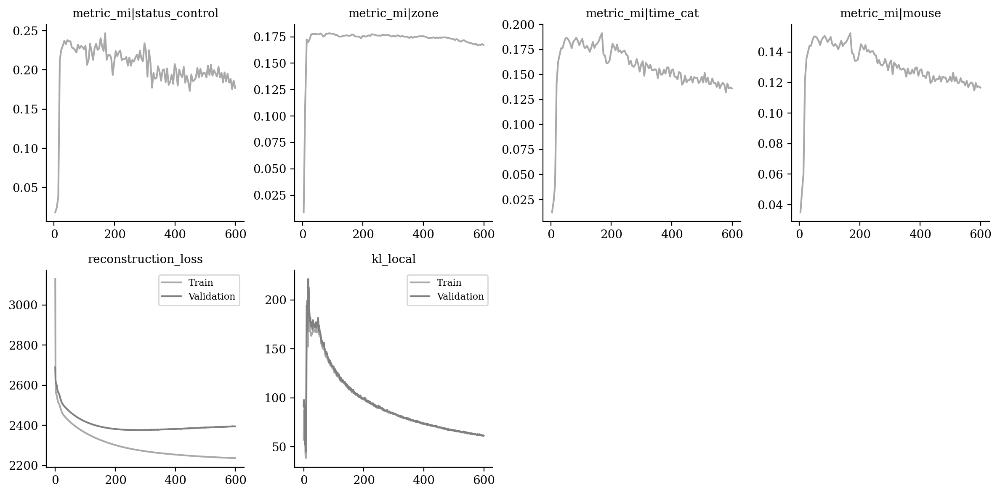

In [12]:
vae.plot_training_history(
    ignore_first=0,
    n_col=4,
    metrics_name=["metric_mi|status_control", "metric_mi|zone", "metric_mi|time_cat", "metric_mi|mouse",
                 "reconstruction_loss", "kl_local"]
)

In [13]:
from tardis._disentanglementmanager import DisentanglementManager as DM

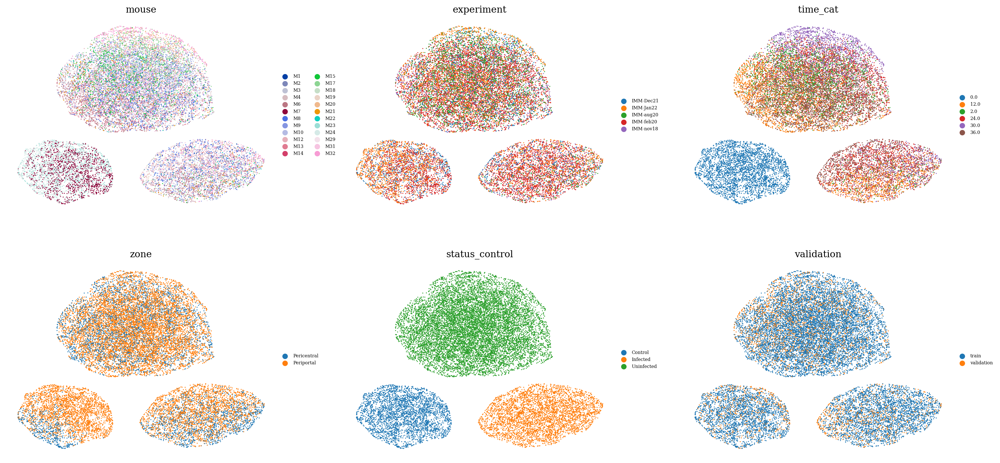

In [14]:
sublatent = DM.configurations.get_by_obs_key("status_control").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

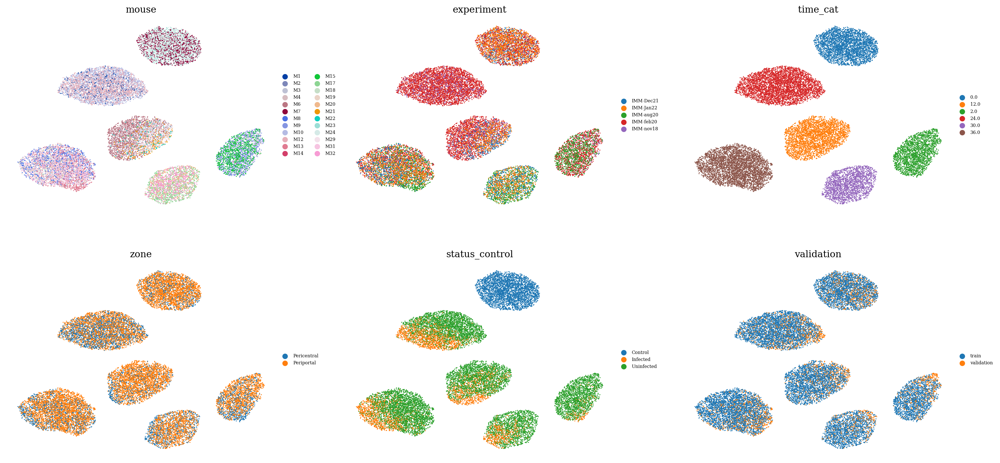

In [15]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

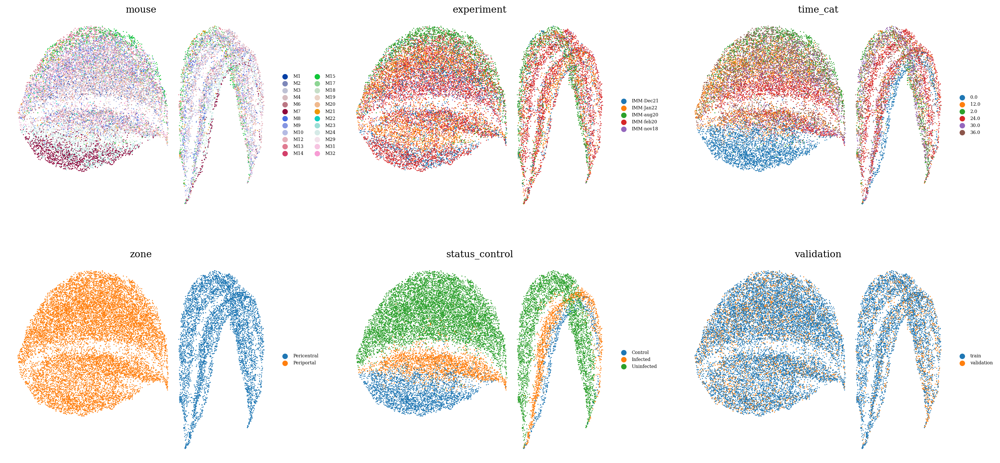

In [16]:
sublatent = DM.configurations.get_by_obs_key("zone").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

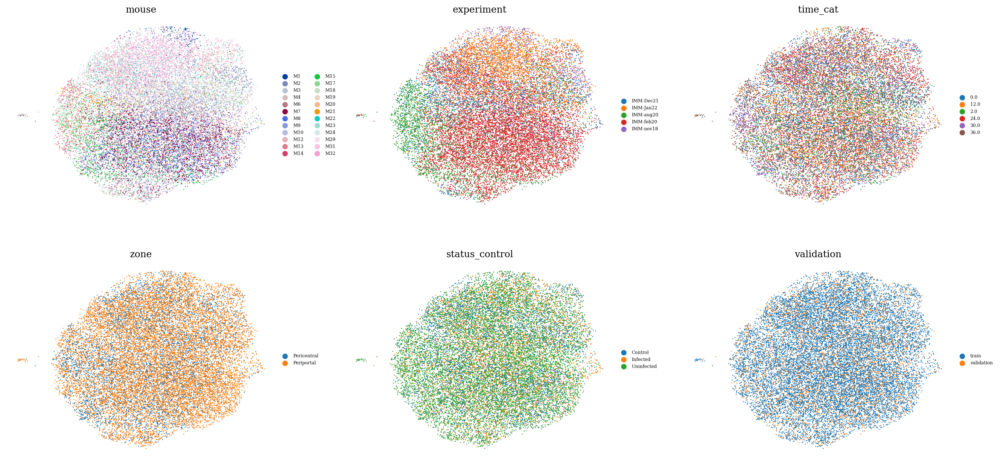

In [17]:
sublatent = DM.configurations.unreserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

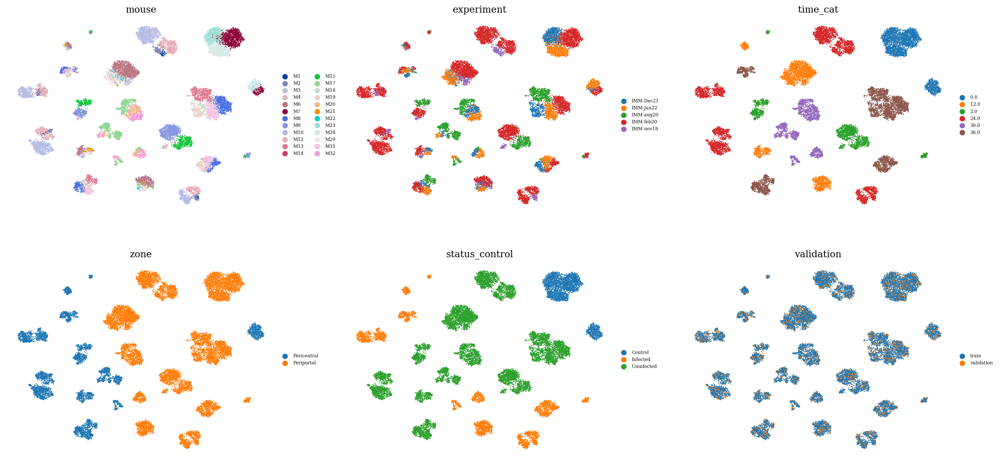

In [18]:
latent = ad.AnnData(X=vae.get_latent_representation(), obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

In [19]:
data = vae.get_latent_representation()

import sklearn
factors_indices = sorted([[indice, config.obs_key] for config in DM.configurations.items for indice in config.reserved_latent_indices])
factors = np.vstack([sklearn.preprocessing.LabelEncoder().fit_transform(
    adata.obs[j].copy().astype(str).values.flatten()
) for i, j in factors_indices]).T

data = data[:, [i for i, j in factors_indices]]

maxMIG = vae.get_MI_precalculated(data=data, factors=factors, variation="maxMIG", discretization_bins=256)
maxMIG_mean = np.mean(maxMIG)
maxMIG_mean

0.912442296336239

In [20]:
data = vae.get_latent_representation()

import sklearn
factors_indices = sorted([[indice, config.obs_key] for config in DM.configurations.items for indice in config.reserved_latent_indices])
factors = np.vstack([sklearn.preprocessing.LabelEncoder().fit_transform(
    adata.obs[j].copy().astype(str).values.flatten()
) for i, j in factors_indices]).T

data = data[:, [i for i, j in factors_indices]]

maxMIG = vae.get_MI_precalculated(data=data[vae.validation_indices, :], factors=factors[vae.validation_indices, :], variation="maxMIG", discretization_bins=256)
maxMIG_mean = np.mean(maxMIG)
maxMIG_mean

0.8587776011334198